# тесты алгоритмов

## общие переменные

In [1]:
import processing
from pathlib import Path
import numpy as np

d:\Code\projects\BlindDeconvolution\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


пути к нашему датасету

In [2]:
root = Path("alg_test")
original_folder = root / Path("original")
blurred_folder = root / Path("blurred")
kernel_folder = root / Path("ground_truth_filters")
kernel_data_folder = root / Path("kernel_data")
restored_kernel_folder = root / Path("restored_kernel")
restored_folder = root / Path("restored")
table_folder = root / Path("tables")


пути к ядрам

In [3]:
convolved_kernel_png = kernel_folder / Path("convolved_kernel.png")
convolved_kernel_npy = kernel_data_folder / Path("convolved_kernel.npy")

In [4]:
defocusdisk_png = kernel_folder / Path("defocusdisk.png")
defocusdisk_npy = kernel_data_folder / Path("defocusdisk.npy")

In [5]:
defocusgaussian_png = kernel_folder / Path("defocusgaussian.png")
defocusgaussian_npy = kernel_data_folder / Path("defocusgaussian.npy")

In [6]:
defocusring_png = kernel_folder / Path("defocusring.png")
defocusring_npy = kernel_data_folder / Path("defocusring.npy")

In [7]:
motionbsplinesimplecurve_png = kernel_folder / Path("motionbsplinesimplecurve.png")
motionbsplinesimplecurve_npy = kernel_data_folder / Path("motionbsplinesimplecurve.npy")

In [8]:
motionlinearexp_png = kernel_folder / Path("motionlinearexp.png")
motionlinearexp_npy = kernel_data_folder / Path("motionlinearexp.npy")

In [9]:
motionlinearuniform_png = kernel_folder / Path("motionlinearuniform.png")
motionlinearuniform_npy = kernel_data_folder / Path("motionlinearuniform.npy")

In [10]:
stretched_gaussian_kernel_png = kernel_folder / Path("stretched_gaussian_kernel.png")
stretched_gaussian_kernel_npy = kernel_data_folder / Path("stretched_gaussian_kernel.npy")

In [11]:
pairs = [
	(convolved_kernel_png,convolved_kernel_npy),
	(defocusdisk_png,defocusdisk_npy),
	(defocusgaussian_png,defocusgaussian_npy),
	(defocusring_png,defocusring_npy),
	(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy),
	(motionlinearexp_png,motionlinearexp_npy),
	(motionlinearuniform_png,motionlinearuniform_npy),
	(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)
]

# Image 1. Airplane.png

## Algorithm 1. HQMBR

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

### ядра

0.0021148187819410476
SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_HQMBR.png (PSNR: 6.51, SSIM: nan)


d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


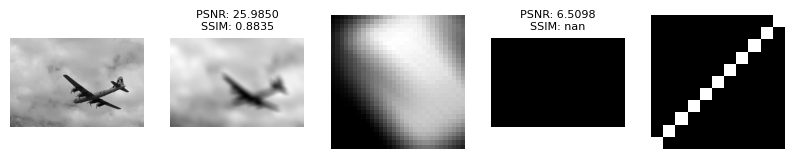

In [ ]:
from algorithms.unsorted.HQMotionBlurRestoration.HQMBR import HQMBR
from algorithms.unsorted.HQMotionBlurRestoration.convolve  import create_line_psf
predict_psf = create_line_psf(np.pi/4, 10, (11, 11))
algorithm_HQMotionBlurRestoration = HQMBR(1,predict_psf= predict_psf, MAX_ITER=50)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_HQMotionBlurRestoration,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)


2.4436656676278795e-05
SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_HQMBR.png (PSNR: 6.51, SSIM: nan)


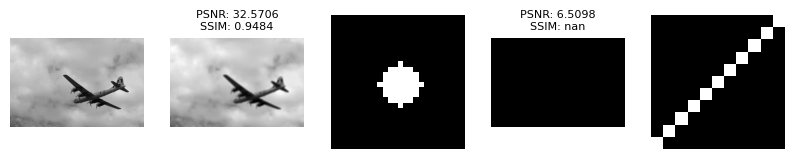

In [ ]:
from algorithms.unsorted.HQMotionBlurRestoration.HQMBR import HQMBR
from algorithms.unsorted.HQMotionBlurRestoration.convolve  import create_line_psf
predict_psf = create_line_psf(np.pi/4, 10, (11, 11))
algorithm_HQMotionBlurRestoration = HQMBR(1,predict_psf= predict_psf, MAX_ITER=50)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_HQMotionBlurRestoration,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
# и т.д. по всем ядрам

In [ ]:
from algorithms.unsorted.HQMotionBlurRestoration.HQMBR import HQMBR
image_filename = "airplane.png"
algorithm_name = HQMBR(1,predict_psf = None, MAX_ITER=50).get_name()

Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_HQMBR,HQMBR,psnr_HQMBR,ssim_HQMBR
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_HQ...,6.509778,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_HQMBR.png,6.509778,NaN


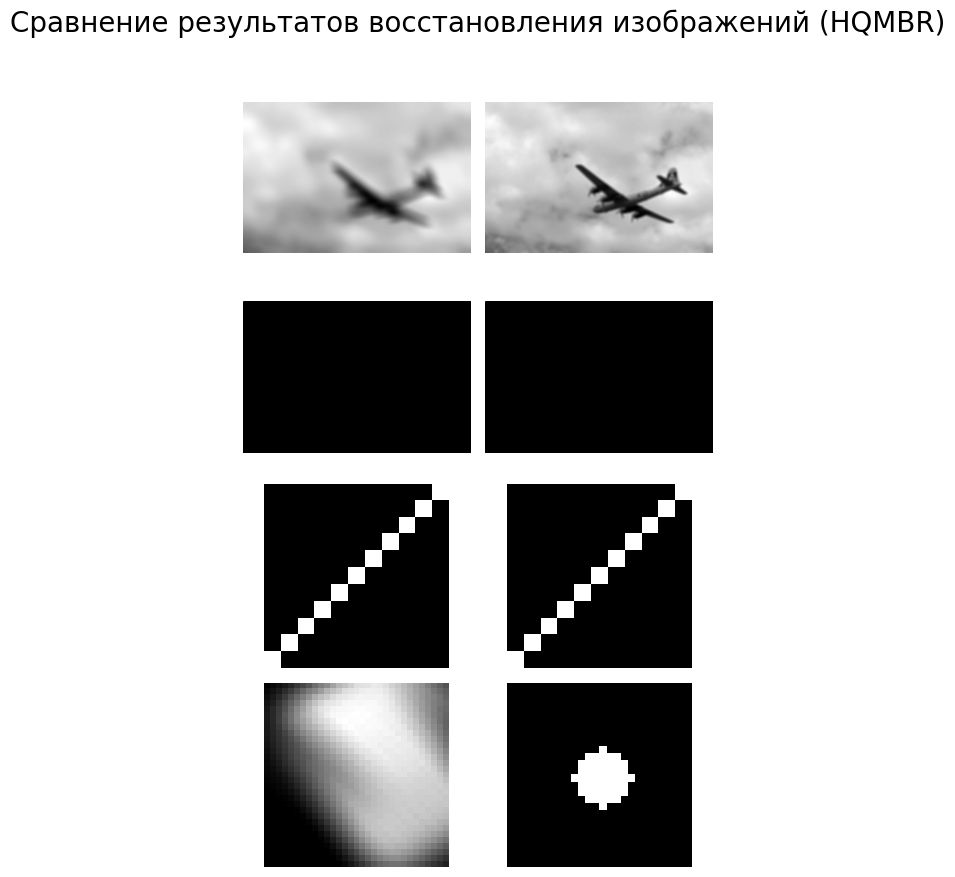

In [ ]:
from algorithms.unsorted.HQMotionBlurRestoration.HQMBR import HQMBR
image_filename = "airplane.png"
algorithm_name = HQMBR(1,predict_psf = None, MAX_ITER=50).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

ModuleNotFoundError: No module named 'algorithms.blind_deconvolution'

Restored: airplane_defocusdisk_GKPILE.png (PSNR: 22.29, SSIM: 0.8462)


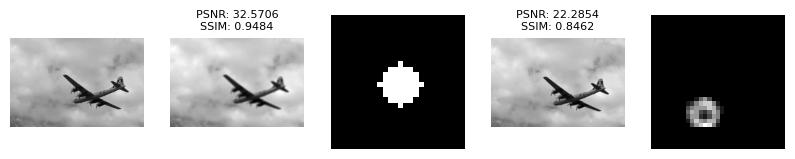

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

Restored: airplane_defocusgaussian_GKPILE.png (PSNR: 25.99, SSIM: 0.8882)


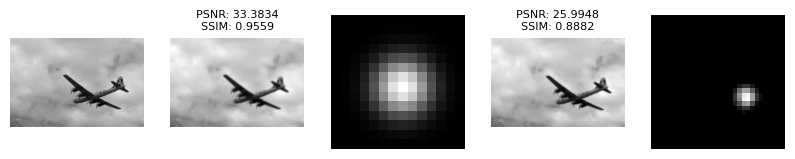

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
#tmp
Processor2 = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor2.read_one(image_filename)

Restored: airplane_defocusring_GKPILE.png (PSNR: 29.93, SSIM: 0.9303)


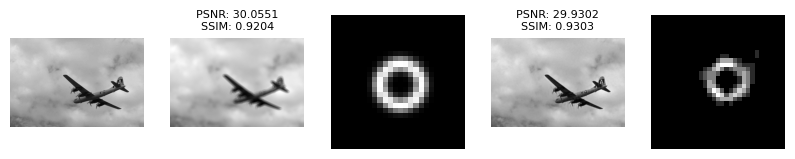

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor2.save_filter()
Processor2.custom_filter(defocusring_png,defocusring_npy)

Processor2.process(algorithm_GKPILE,unique_path=False)

Processor2.show_line(window_scale=2.0,fontsize=8)

Restored: airplane_motionbsplinesimplecurve_GKPILE.png (PSNR: 26.88, SSIM: 0.8725)


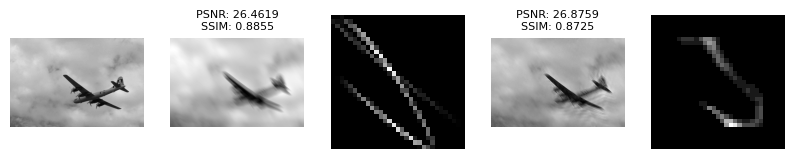

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor2.save_filter()
Processor2.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor2.process(algorithm_GKPILE,unique_path=False)

Processor2.show_line(window_scale=2.0,fontsize=8)

Restored: airplane_motionlinearexp_GKPILE.png (PSNR: 25.75, SSIM: 0.8813)


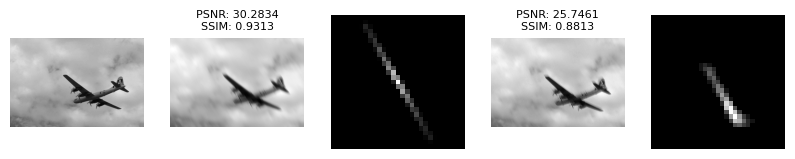

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor2.save_filter()
Processor2.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor2.process(algorithm_GKPILE,unique_path=False)

Processor2.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor2.save_filter()
Processor2.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor2.process(algorithm_GKPILE,unique_path=False)

Processor2.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor2.save_filter()
Processor2.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor2.process(algorithm_GKPILE,unique_path=False)

Processor2.show_line(window_scale=2.0,fontsize=8)

In [ ]:
#tmp
Processor3 = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
Processor3.load_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor = processing.merge(Processor3,Processor2)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_GKPILE,GKPILE,psnr_GKPILE,ssim_GKPILE
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_GK...,29.002073,0.899749
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_GKPILE.png,22.285411,0.846216
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_GKP...,25.994817,0.888225
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_GKP...,25.994817,0.888225


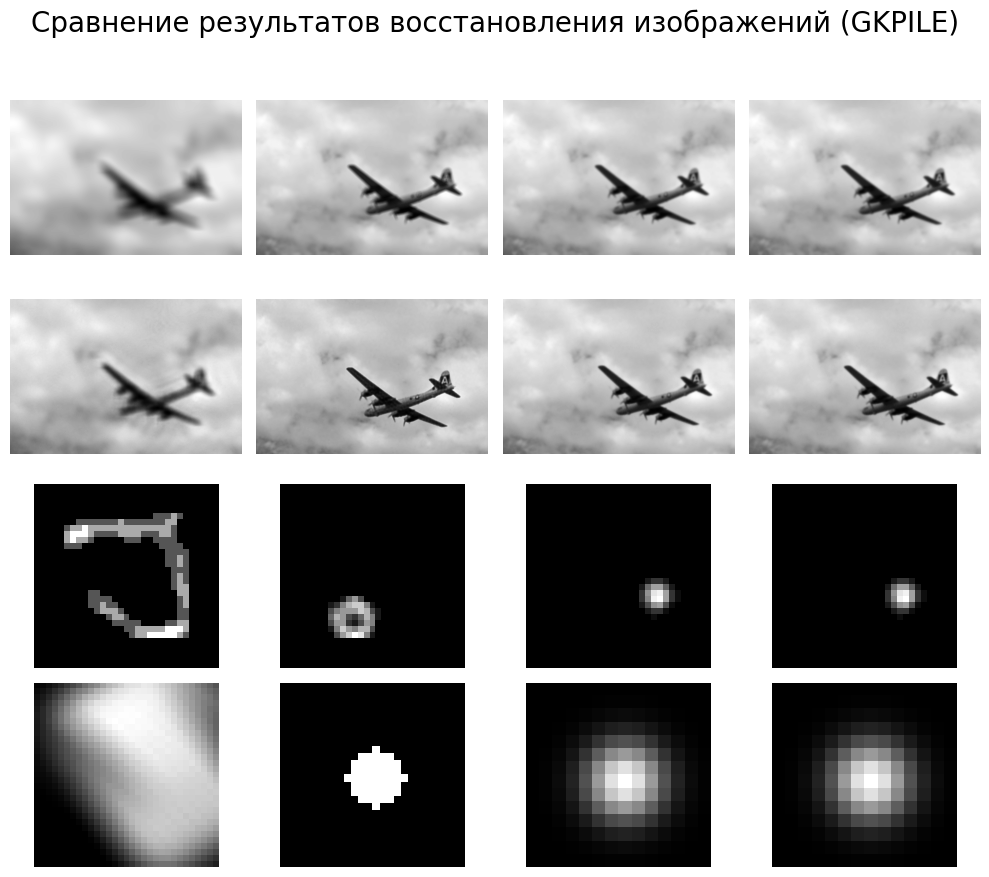

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_default.png (PSNR: nan, SSIM: nan)


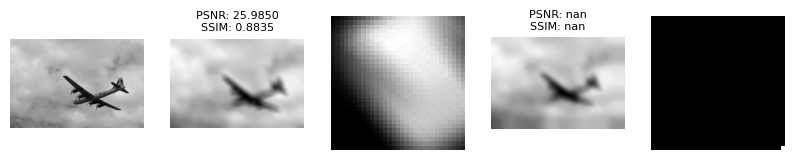

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_default.png (PSNR: nan, SSIM: nan)


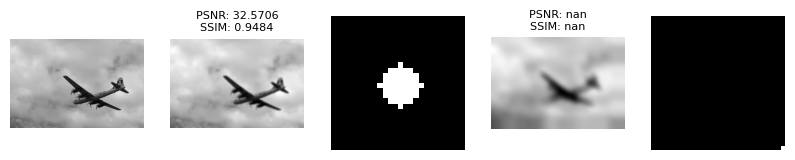

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_LowRankBlindDeconvolution,LowRankBlindDeconvolution,psnr_LowRankBlindDeconvolution,ssim_LowRankBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Lo...,14.663080,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_LowRank...,14.562183,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Low...,14.555457,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_LowRank...,14.693000,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,14.649317,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Low...,14.755532,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,14.655438,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,14.736542,NaN


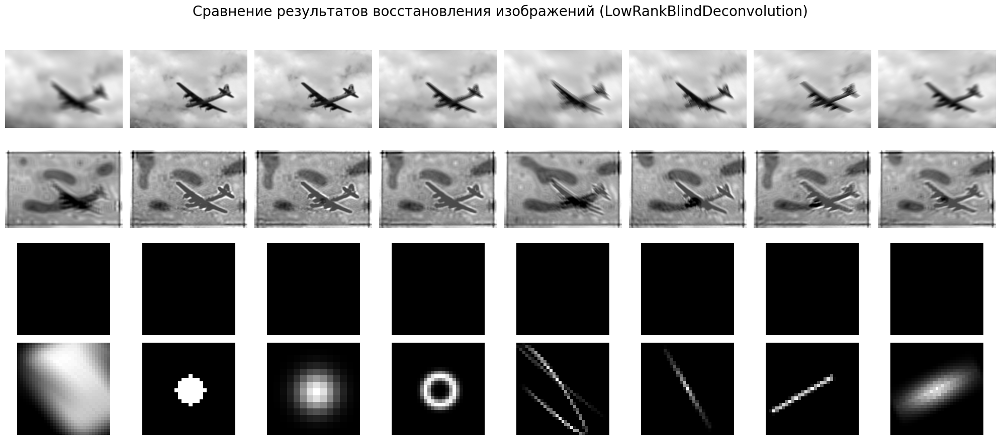

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [12]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_default.png (PSNR: nan, SSIM: nan)


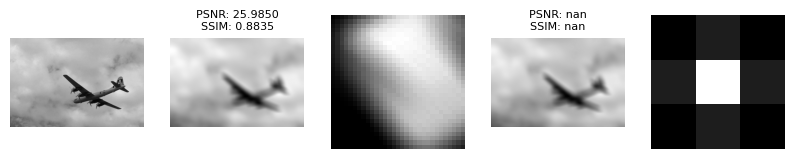

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_default.png (PSNR: nan, SSIM: nan)


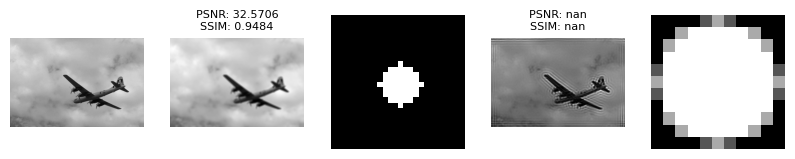

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_default.png (PSNR: nan, SSIM: nan)


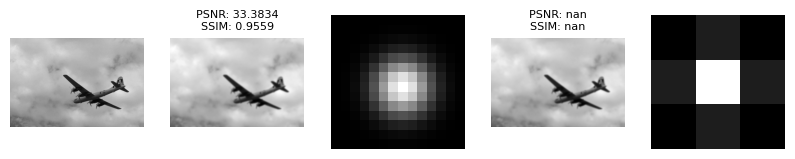

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_default.png (PSNR: nan, SSIM: nan)


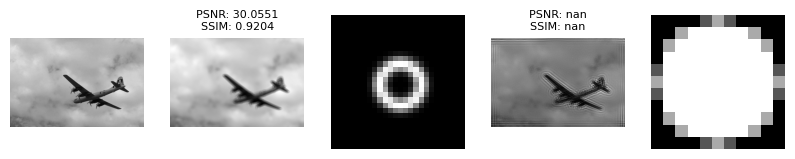

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: nan, SSIM: nan)


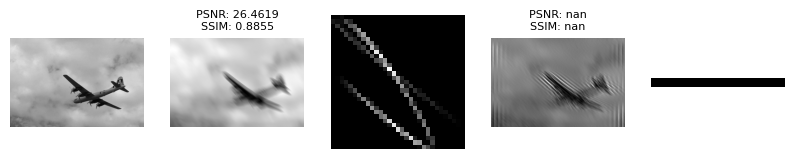

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_default.png (PSNR: nan, SSIM: nan)


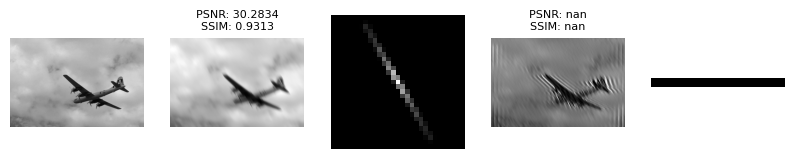

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution

algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy,kernel in [
	(convolved_kernel_png,          convolved_kernel_npy,          "gaussian"),

	(defocusdisk_png,               defocusdisk_npy,               "disk"),
	(defocusgaussian_png,           defocusgaussian_npy,           "gaussian"),
	(defocusring_png,               defocusring_npy,               "disk"),

	(motionbsplinesimplecurve_png,  motionbsplinesimplecurve_npy,  "motion"),
	(motionlinearexp_png,           motionlinearexp_npy,           "motion"),
	(motionlinearuniform_png,       motionlinearuniform_npy,       "motion"),

	(stretched_gaussian_kernel_png, stretched_gaussian_kernel_npy, "gaussian"),
]:
	algorithm = WarrenzhaBlindDeconvolution(type=kernel)

	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_default,default,psnr_default,ssim_default
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_de...,NaN,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_default...,NaN,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_def...,NaN,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_default...,NaN,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,NaN,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_def...,NaN,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,NaN,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,NaN,NaN


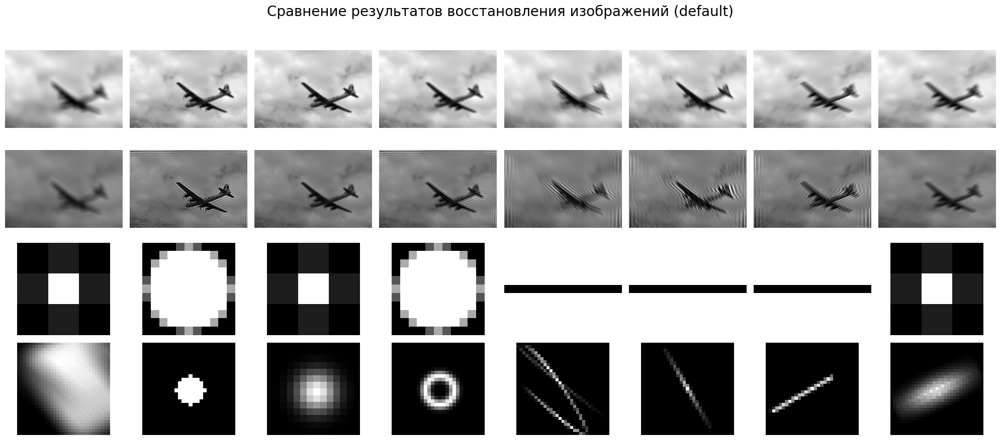

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_default.png (PSNR: nan, SSIM: nan)


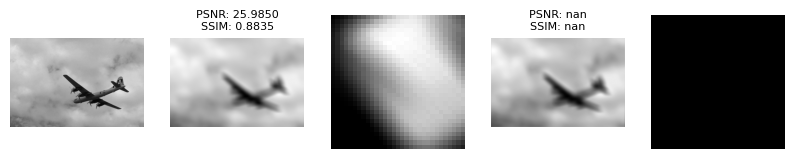

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_default.png (PSNR: nan, SSIM: nan)


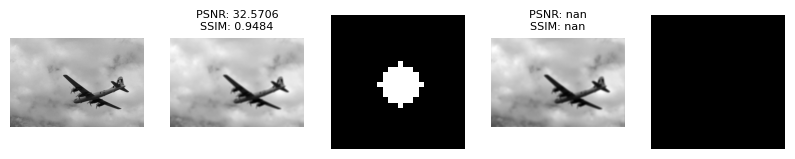

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_default.png (PSNR: nan, SSIM: nan)


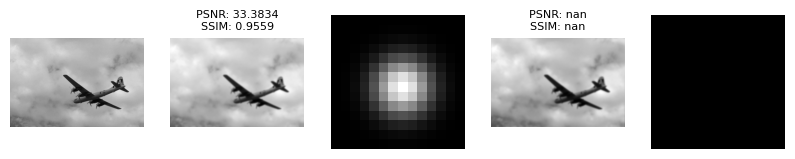

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_default.png (PSNR: nan, SSIM: nan)


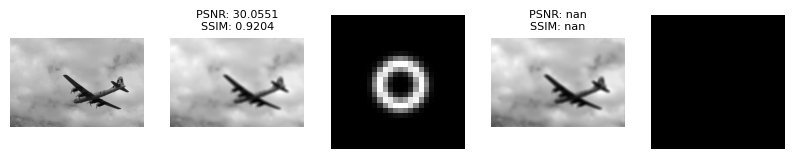

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: nan, SSIM: nan)


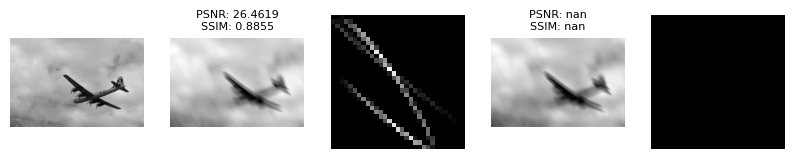

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_default.png (PSNR: nan, SSIM: nan)


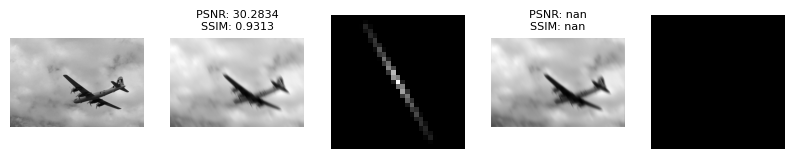

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_default.png (PSNR: nan, SSIM: nan)


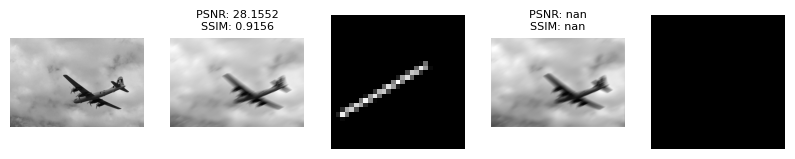

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: nan, SSIM: nan)


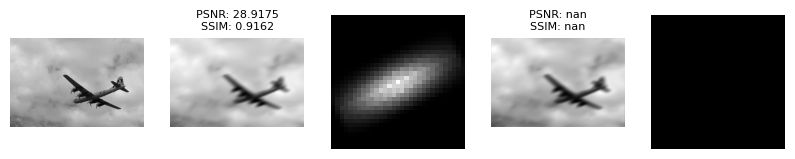

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ZalteckBCDTV,ZalteckBCDTV,psnr_ZalteckBCDTV,ssim_ZalteckBCDTV
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Za...,6.580463,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Zalteck...,6.580463,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Zal...,6.580463,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Zalteck...,6.580463,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.580463,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Zal...,6.580463,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.580463,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.580463,NaN


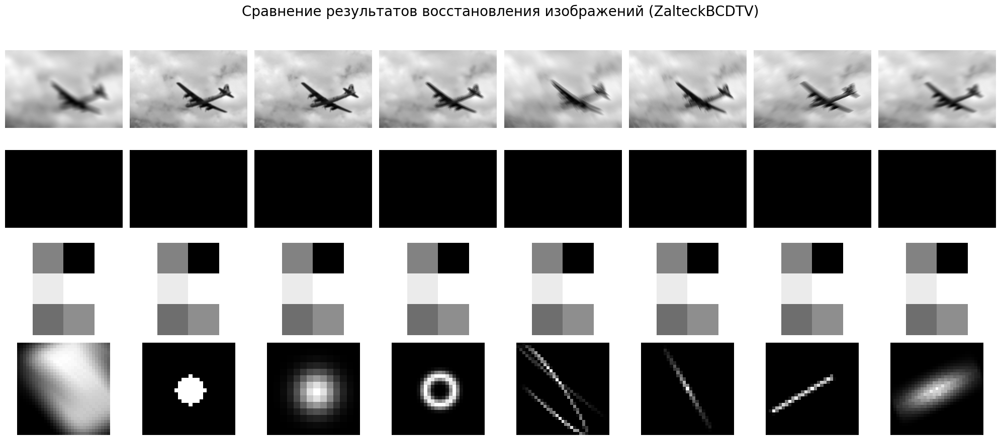

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_default.png (PSNR: 25.35, SSIM: nan)


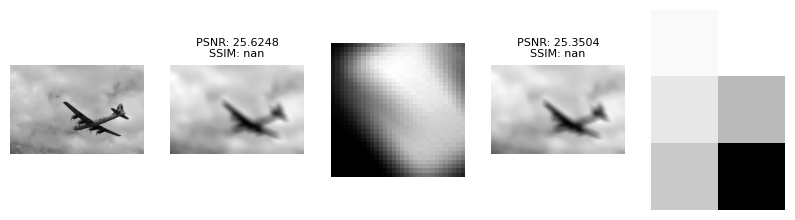

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_default.png (PSNR: 31.59, SSIM: nan)


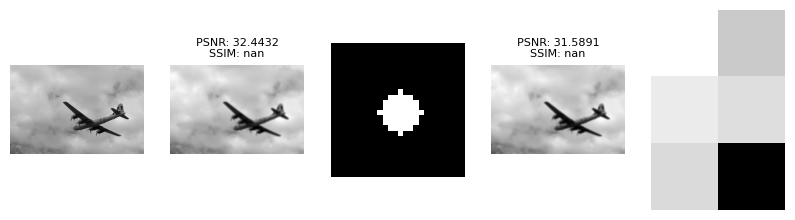

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_default.png (PSNR: 32.22, SSIM: nan)


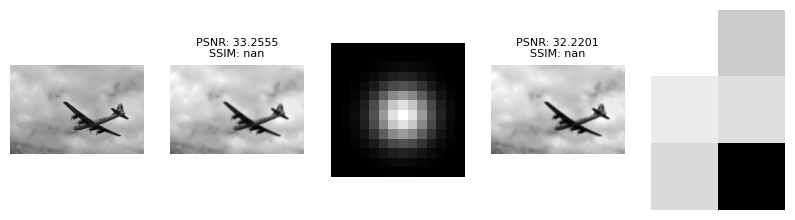

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_default.png (PSNR: 29.33, SSIM: nan)


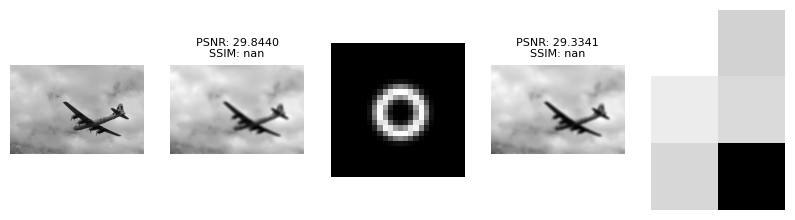

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: 25.81, SSIM: nan)


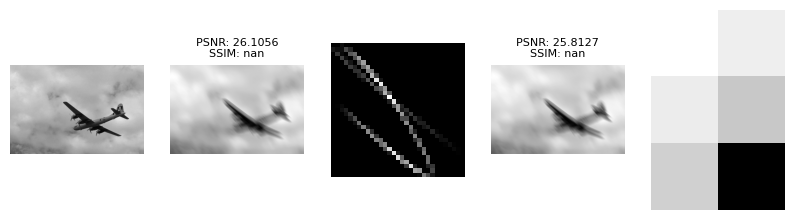

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_default.png (PSNR: 29.47, SSIM: nan)


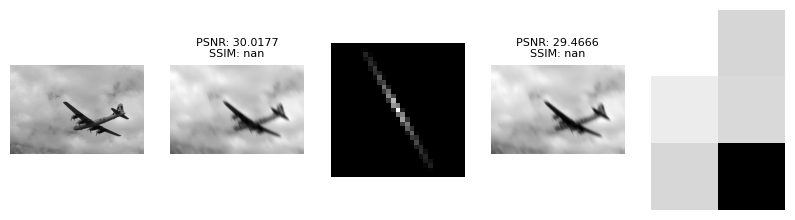

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_default.png (PSNR: 27.43, SSIM: nan)


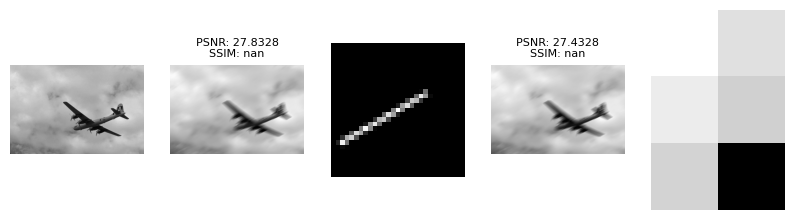

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: 28.12, SSIM: nan)


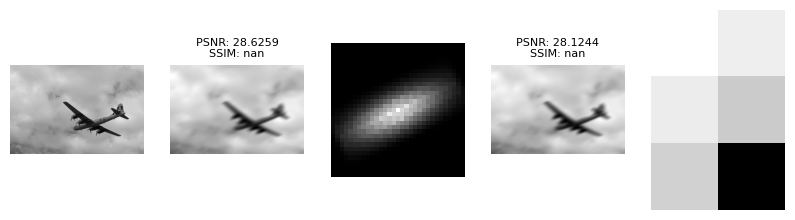

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_BCDHE,BCDHE,psnr_BCDHE,ssim_BCDHE
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_BC...,NaN,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_BCDHE.png,NaN,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_BCD...,NaN,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_BCDHE.png,NaN,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,NaN,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_BCD...,NaN,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,NaN,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,NaN,NaN


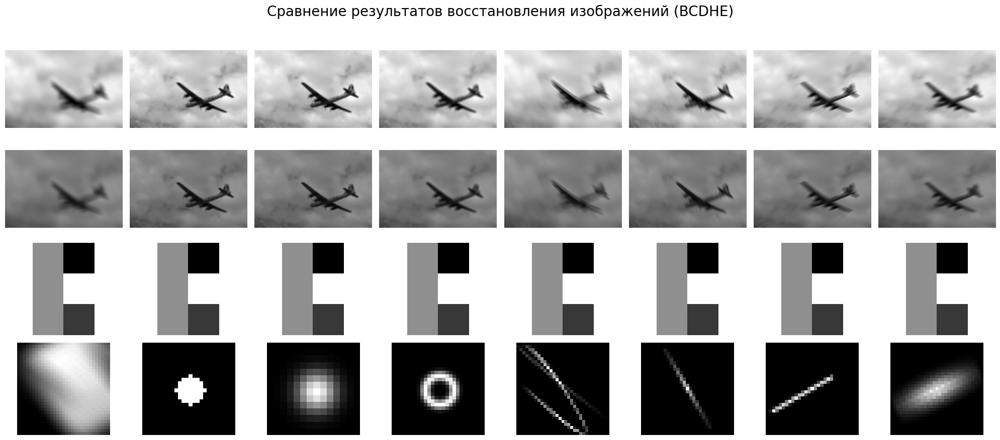

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [13]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 20.13, SSIM: nan)


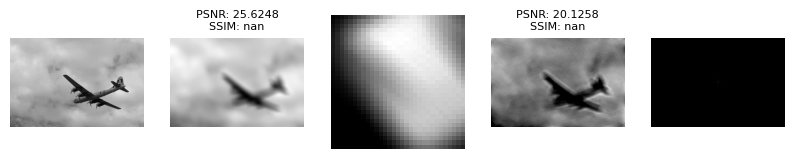

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 21.39, SSIM: nan)


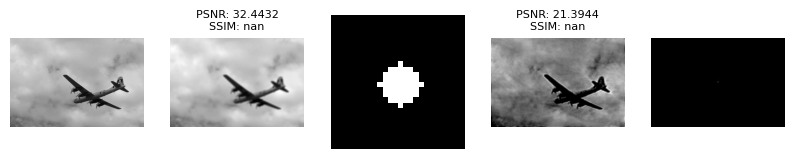

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 21.70, SSIM: nan)


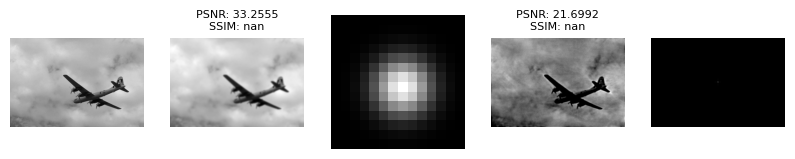

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 20.92, SSIM: nan)


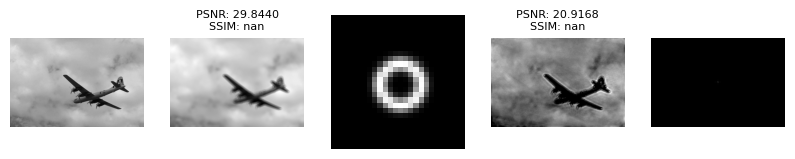

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 20.05, SSIM: nan)


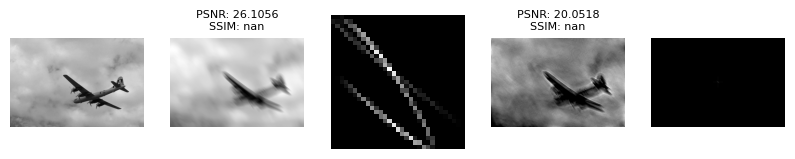

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 21.65, SSIM: nan)


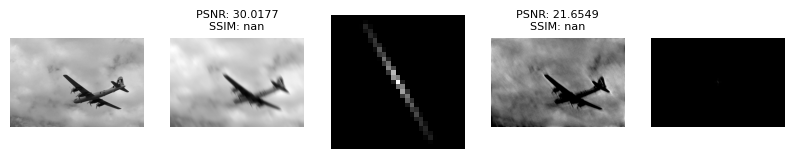

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 20.45, SSIM: nan)


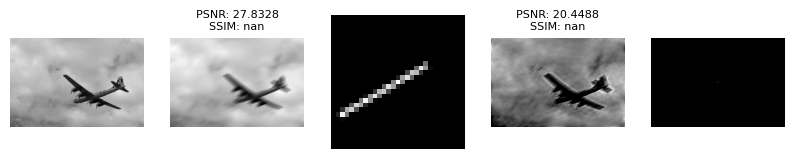

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 21.35, SSIM: nan)


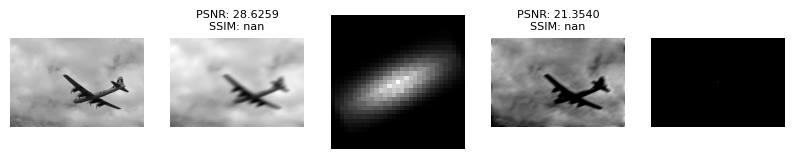

In [14]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_MHDM,MHDM,psnr_MHDM,ssim_MHDM
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_MH...,21.173576,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_MHDM.png,22.505918,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_MHD...,22.525885,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_MHDM.png,22.427855,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,21.116084,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_MHD...,22.394409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,21.572524,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,22.326223,NaN


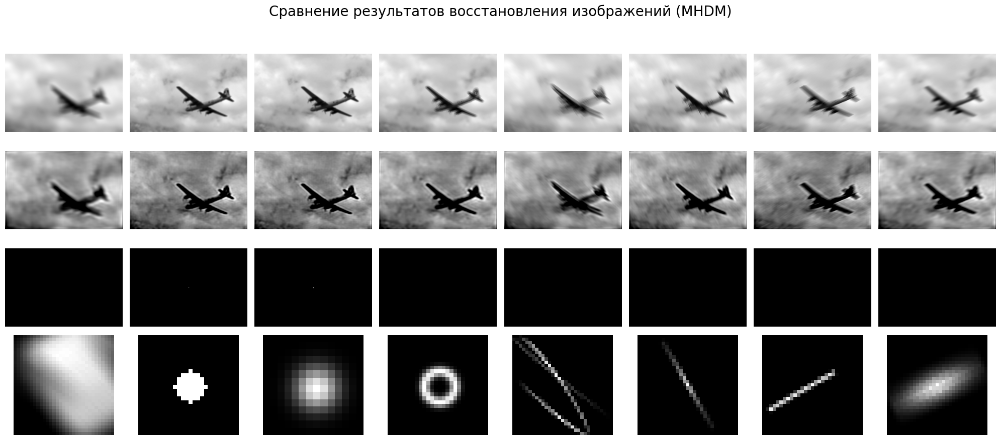

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_default.png (PSNR: nan, SSIM: nan)


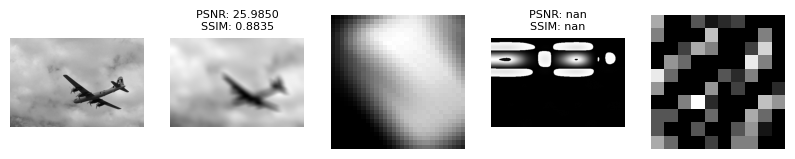

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_default.png (PSNR: nan, SSIM: nan)


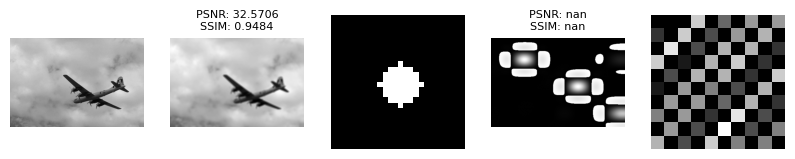

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_default.png (PSNR: nan, SSIM: nan)


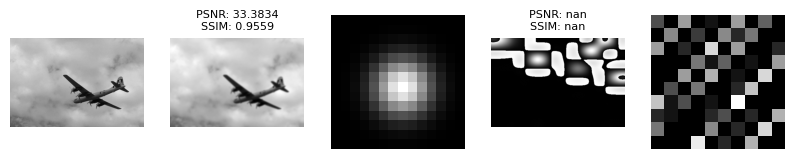

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_default.png (PSNR: nan, SSIM: nan)


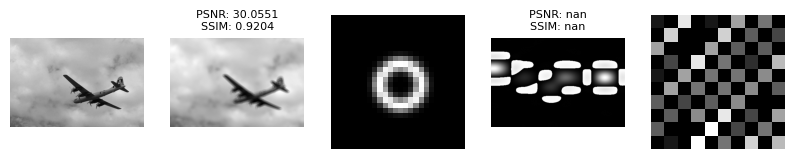

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: nan, SSIM: nan)


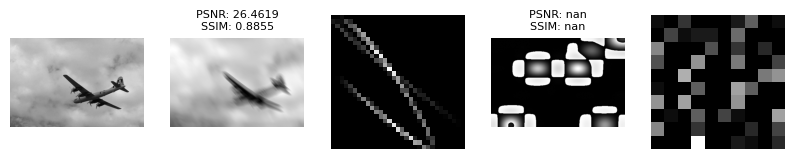

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_default.png (PSNR: nan, SSIM: nan)


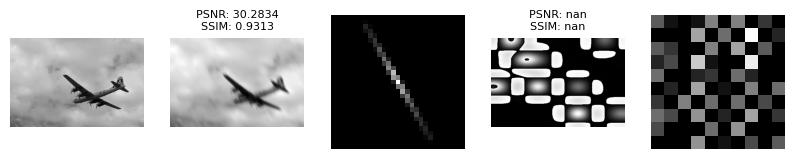

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_default.png (PSNR: nan, SSIM: nan)


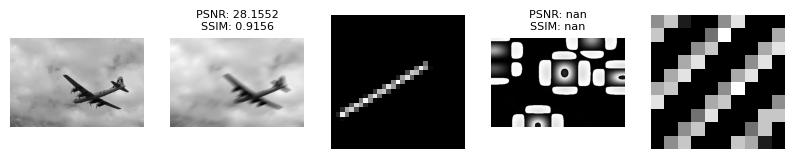

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: nan, SSIM: nan)


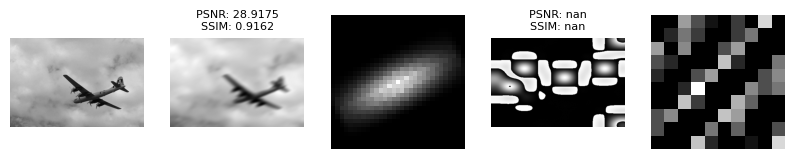

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_MCSBlindDeconvolution,MCSBlindDeconvolution,psnr_MCSBlindDeconvolution,ssim_MCSBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_MC...,20.921096,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_MCSBlin...,15.966600,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_MCS...,15.773159,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_MCSBlin...,18.657588,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,18.708967,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_MCS...,18.192435,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,17.089440,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,20.011173,NaN


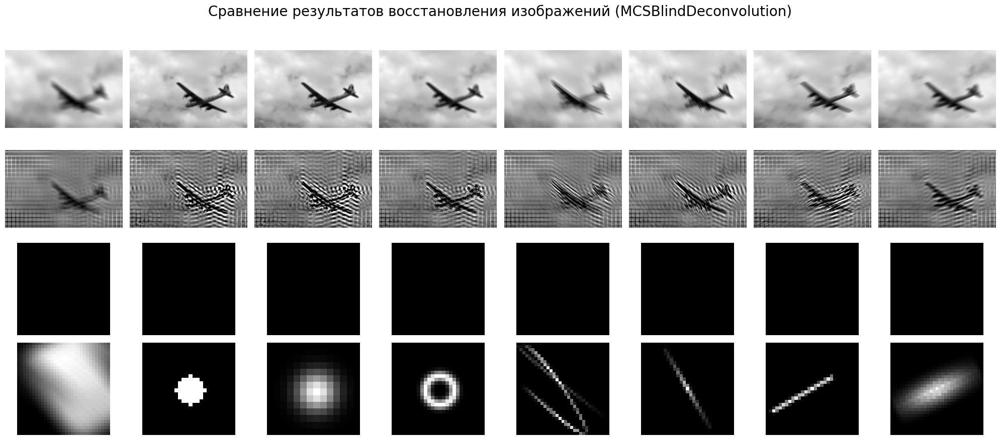

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_default.png (PSNR: 23.69, SSIM: nan)


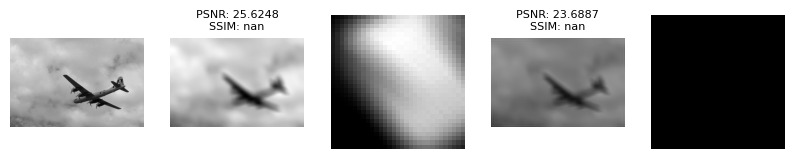

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_default.png (PSNR: 27.52, SSIM: nan)


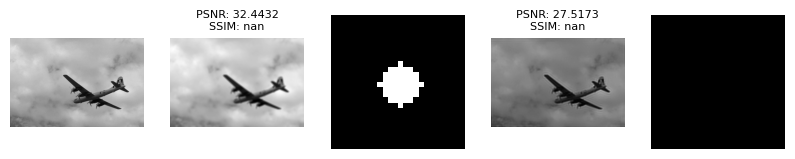

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_default.png (PSNR: 27.33, SSIM: nan)


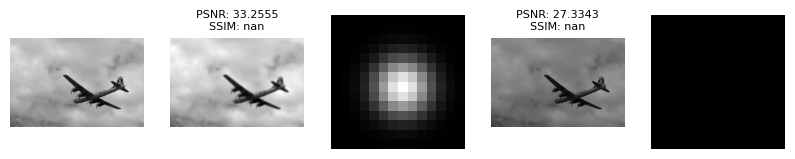

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_default.png (PSNR: 25.52, SSIM: nan)


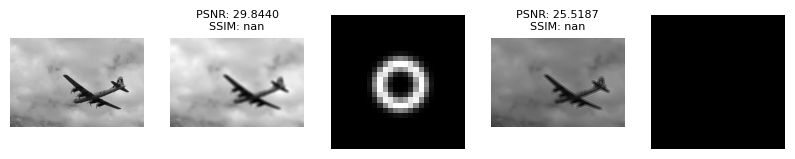

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: 23.87, SSIM: nan)


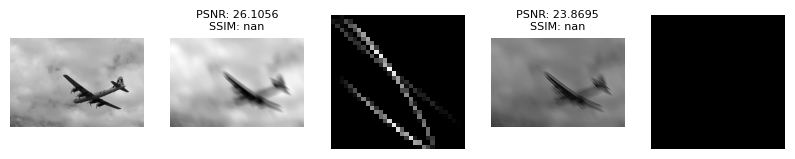

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_default.png (PSNR: 26.05, SSIM: nan)


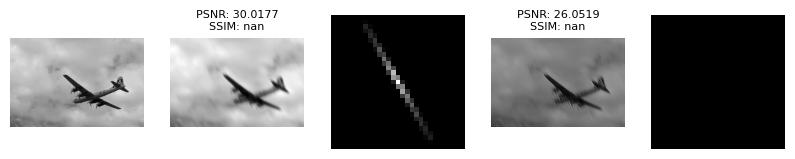

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_default.png (PSNR: 24.57, SSIM: nan)


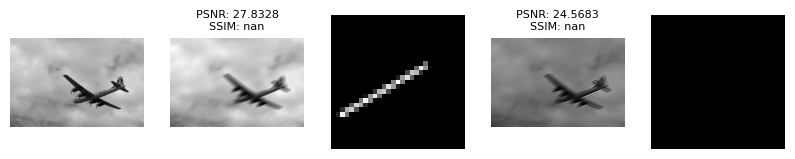

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: 25.52, SSIM: nan)


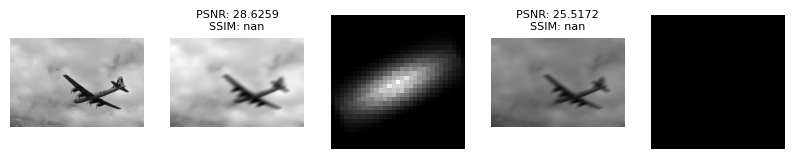

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_WienerFilter,WienerFilter,psnr_WienerFilter,ssim_WienerFilter
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Wi...,25.886818,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_WienerF...,32.108563,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Wie...,33.859104,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_WienerF...,29.352564,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,26.282991,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Wie...,30.322463,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,27.937091,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,28.851397,NaN


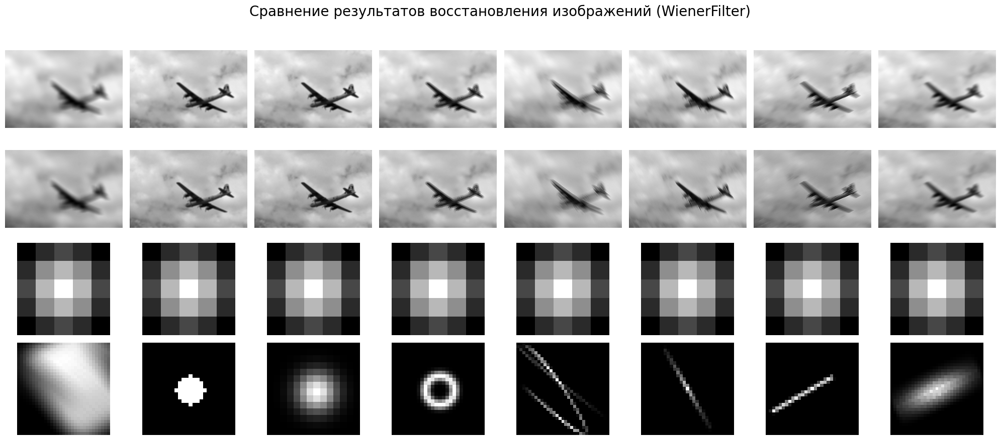

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_default.png (PSNR: 23.51, SSIM: nan)


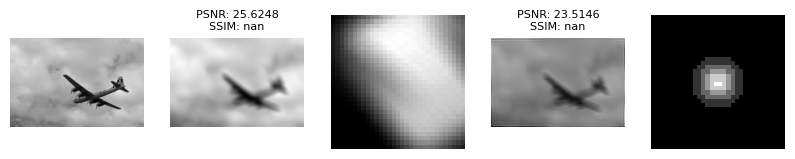

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_default.png (PSNR: 25.70, SSIM: nan)


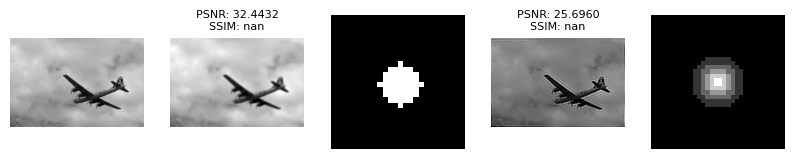

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_default.png (PSNR: 25.35, SSIM: nan)


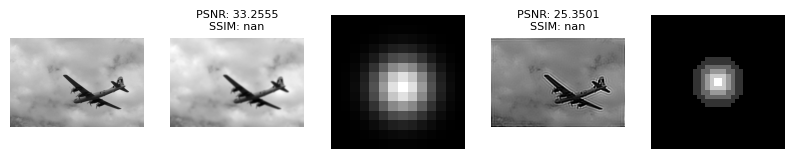

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_default.png (PSNR: 25.12, SSIM: nan)


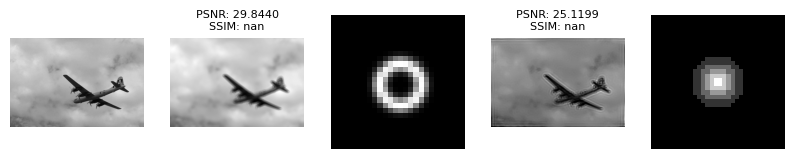

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: 23.15, SSIM: nan)


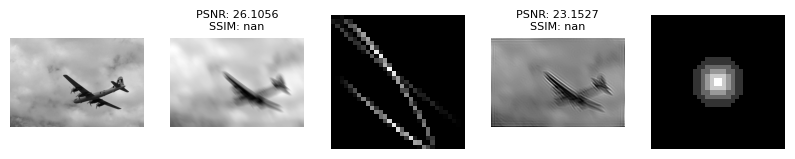

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_default.png (PSNR: 25.45, SSIM: nan)


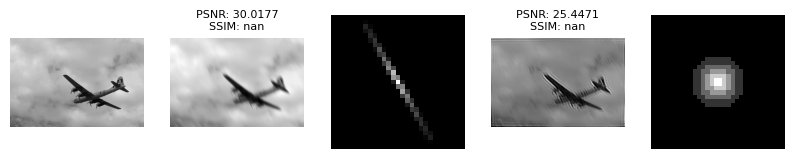

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_default.png (PSNR: 23.60, SSIM: nan)


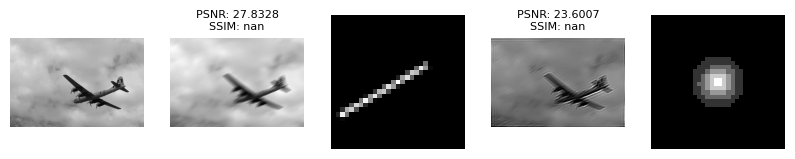

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: 25.55, SSIM: nan)


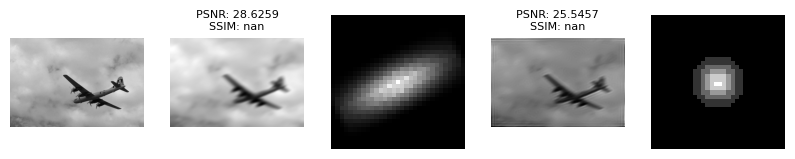

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_MaxMBWienerBlind,MaxMBWienerBlind,psnr_MaxMBWienerBlind,ssim_MaxMBWienerBlind
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Ma...,17.699628,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_MaxMBWi...,17.361603,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Max...,17.356060,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_MaxMBWi...,17.644487,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,17.876772,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Max...,17.747450,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,17.689316,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,17.818668,NaN


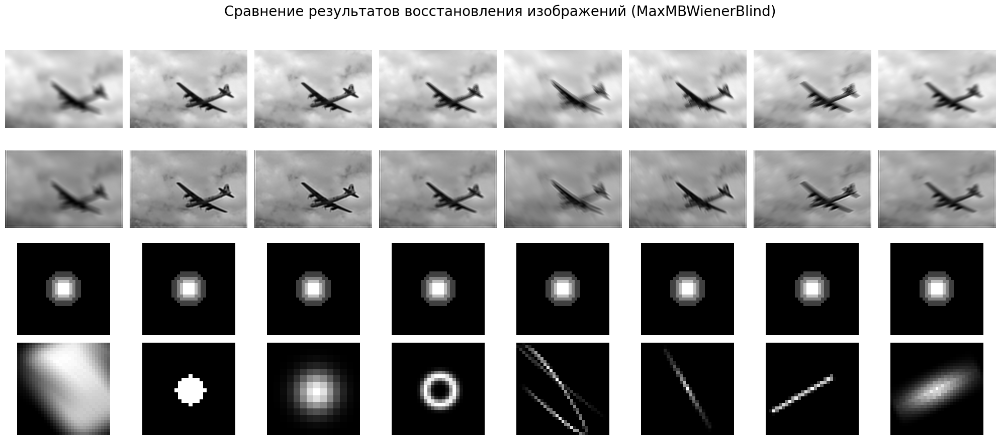

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,True,restored_kernel_folder)
image_filename = "airplane.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_default.png (PSNR: nan, SSIM: nan)


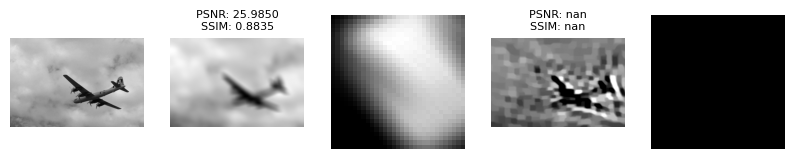

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_default.png (PSNR: nan, SSIM: nan)


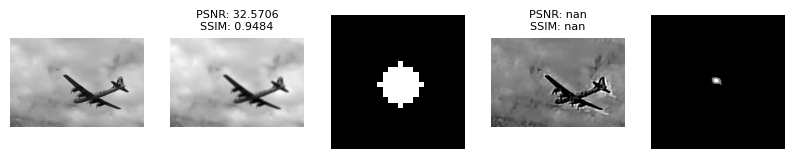

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_default.png (PSNR: nan, SSIM: nan)


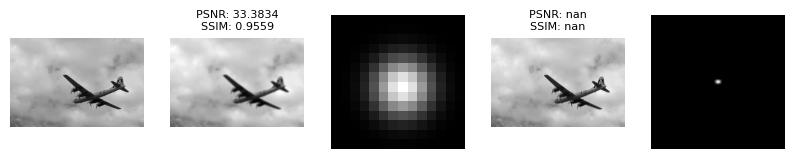

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_default.png (PSNR: nan, SSIM: nan)


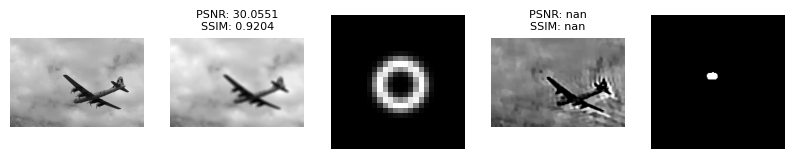

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_default.png (PSNR: nan, SSIM: nan)


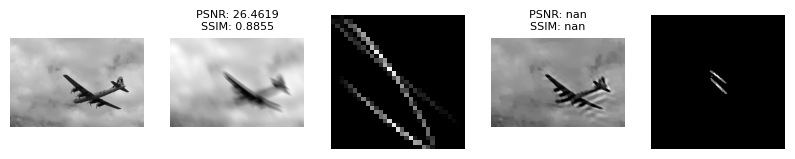

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_default.png (PSNR: nan, SSIM: nan)


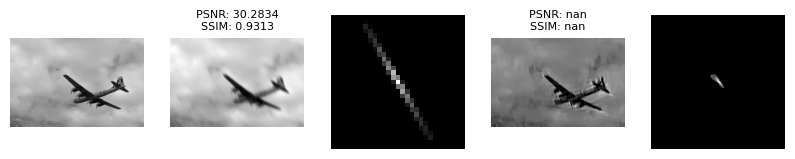

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_default.png (PSNR: nan, SSIM: nan)


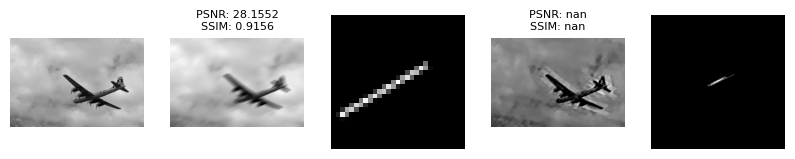

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_default.png (PSNR: nan, SSIM: nan)


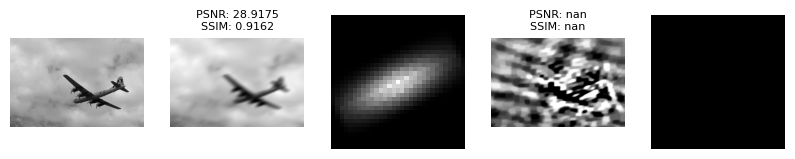

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_LowRankKernelBlindDeconv,LowRankKernelBlindDeconv,psnr_LowRankKernelBlindDeconv,ssim_LowRankKernelBlindDeconv
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Lo...,20.060334,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_LowRank...,14.168457,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Low...,14.061974,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_LowRank...,16.174103,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,18.053113,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Low...,16.598979,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,15.756942,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,17.881568,NaN


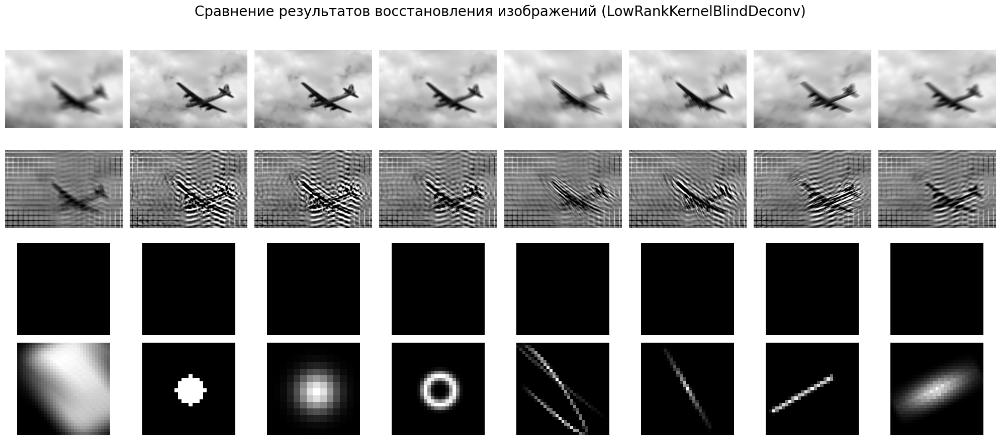

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 2. boy.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

KeyboardInterrupt: 

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


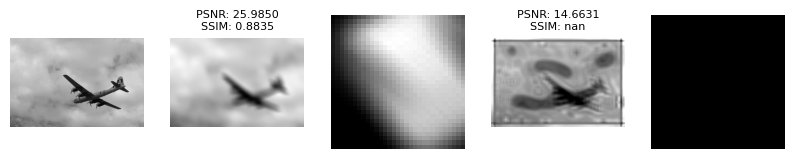

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


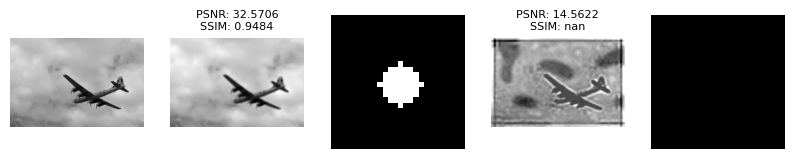

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


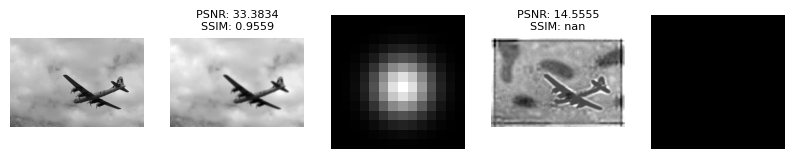

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


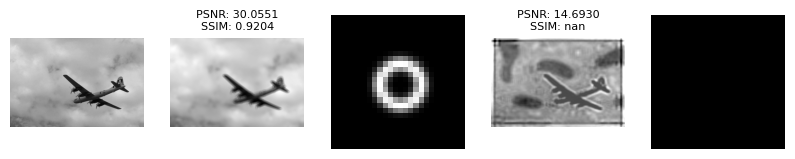

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


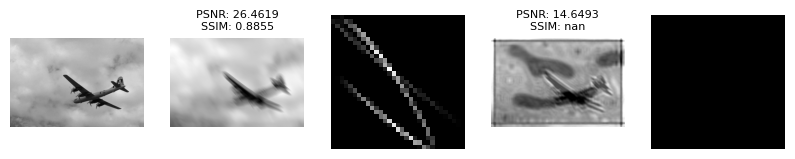

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


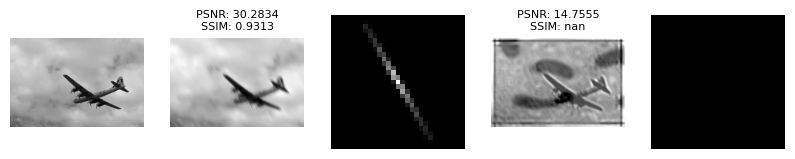

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


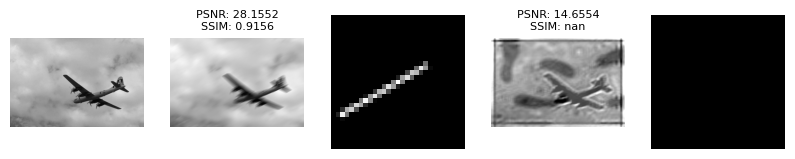

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


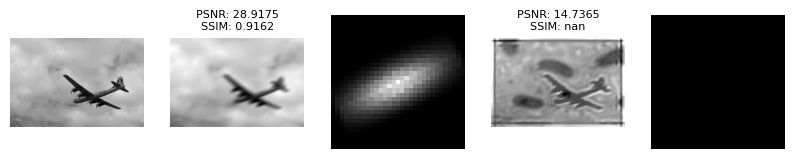

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


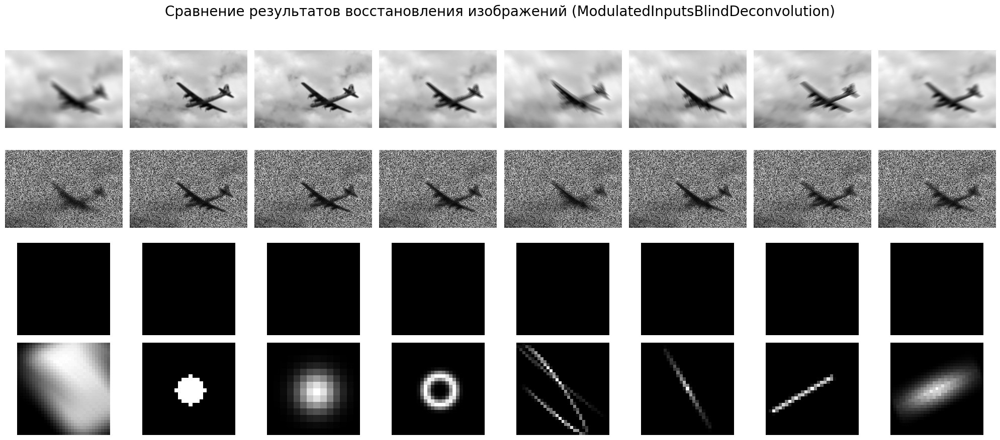

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


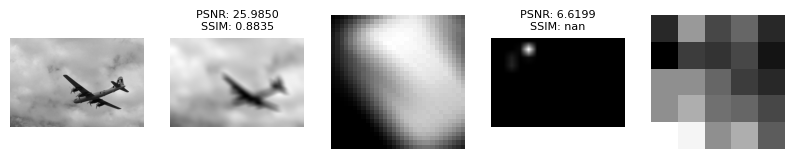

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


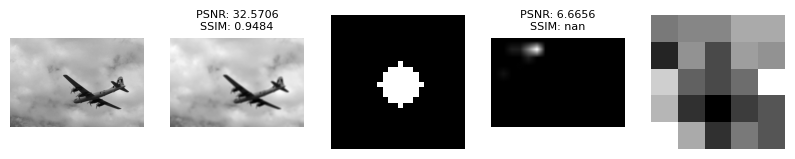

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


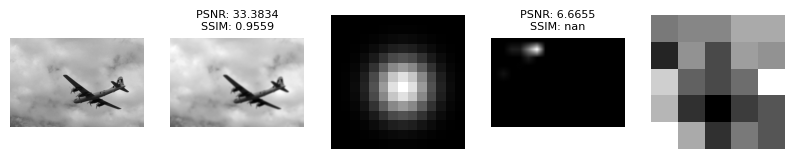

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


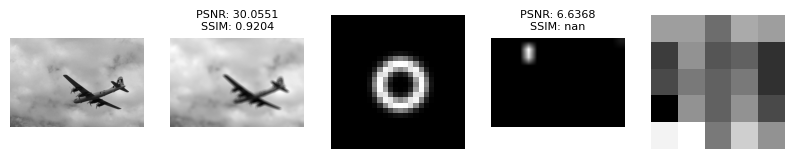

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


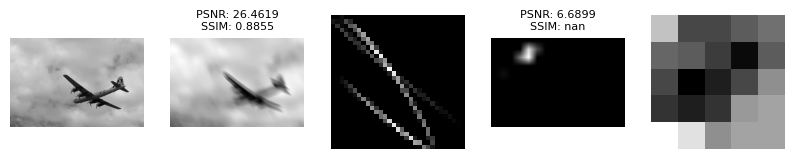

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


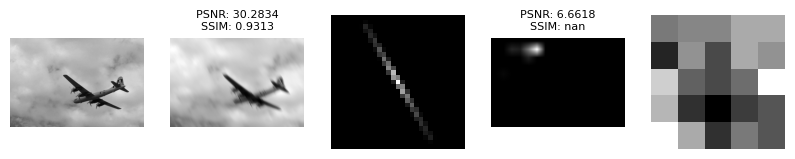

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


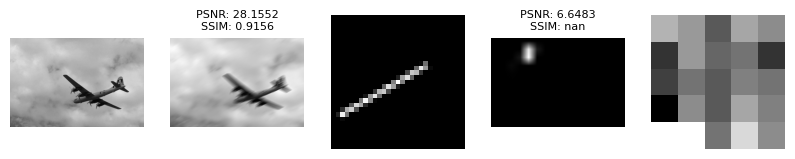

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


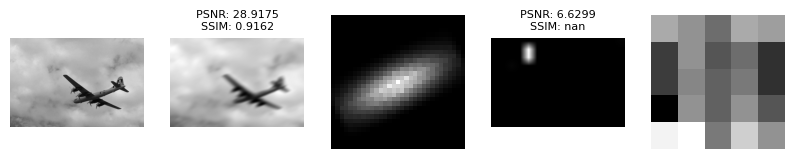

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


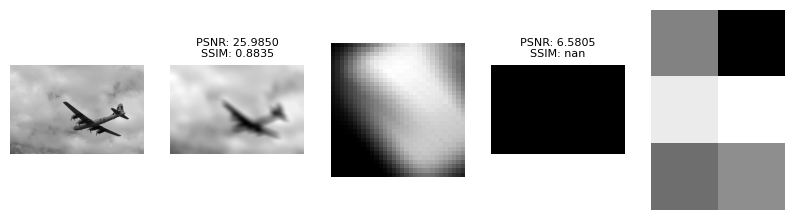

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

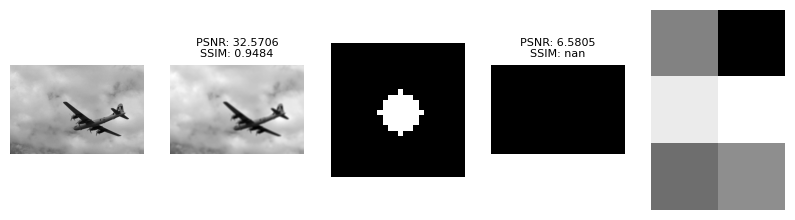

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

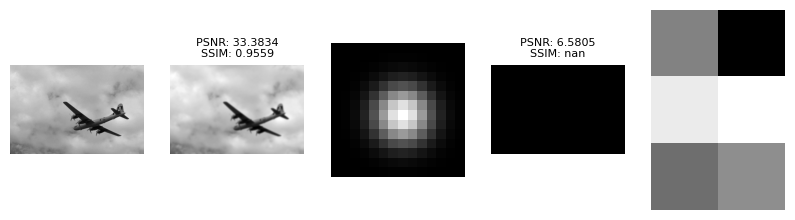

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

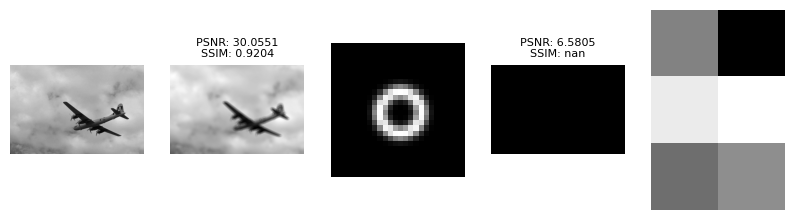

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

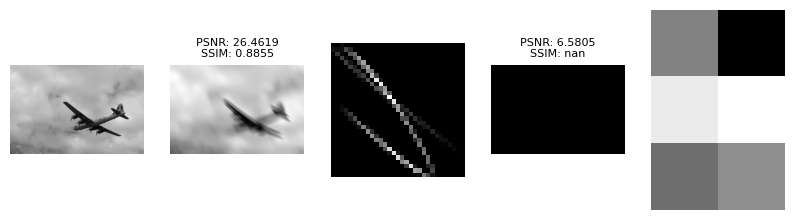

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

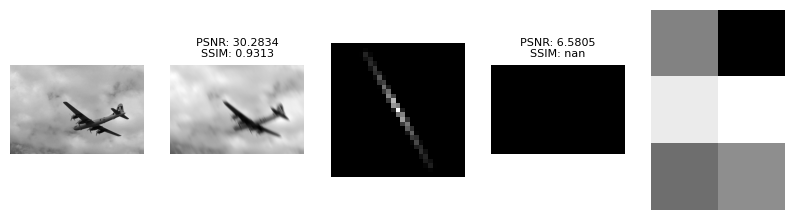

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

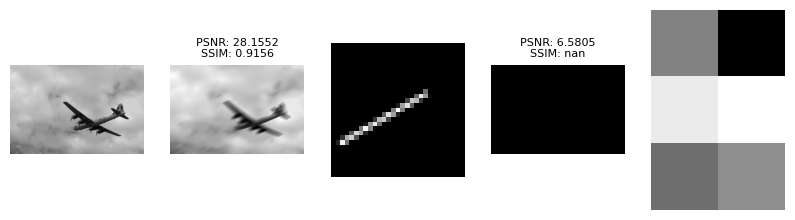

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

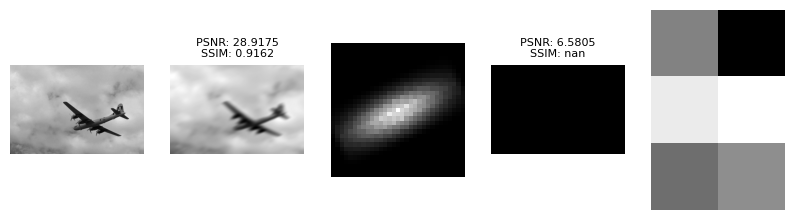

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


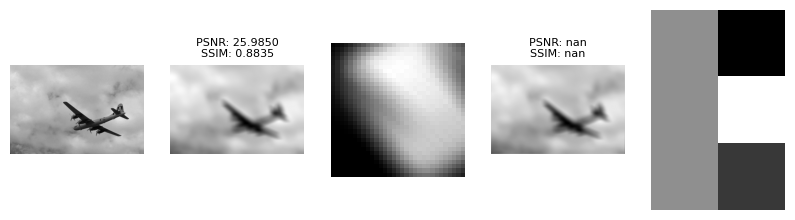

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


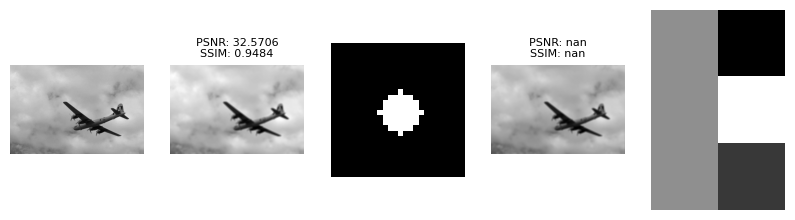

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


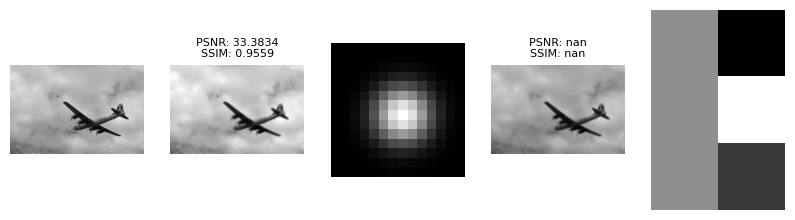

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


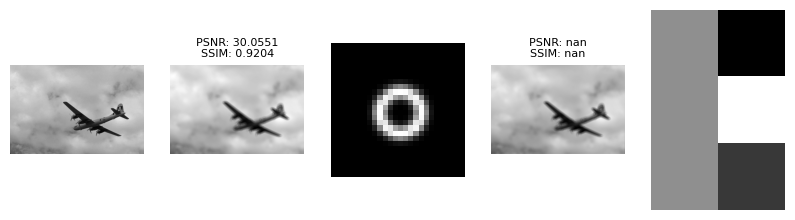

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


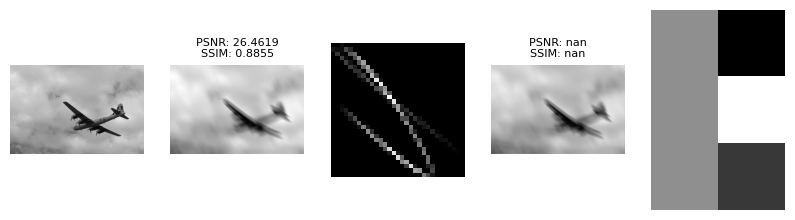

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


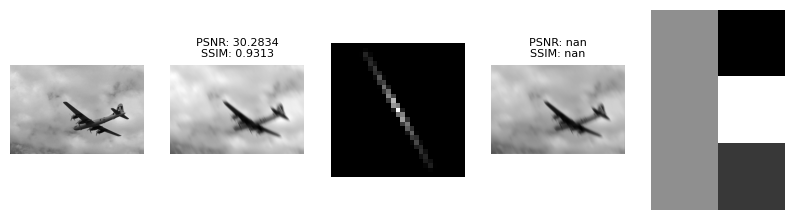

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


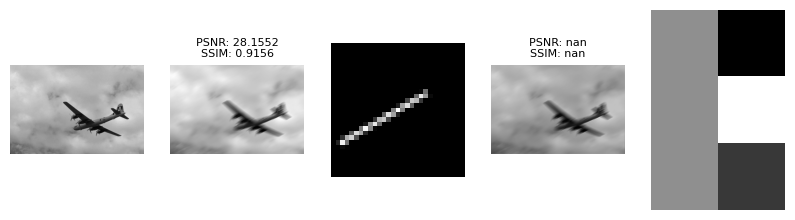

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


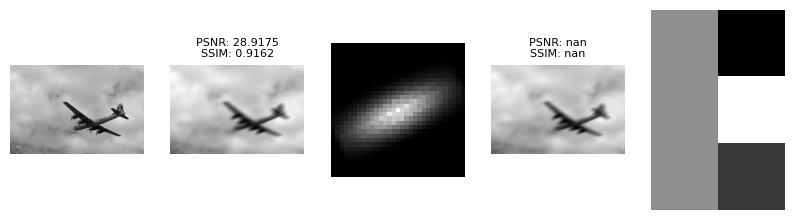

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


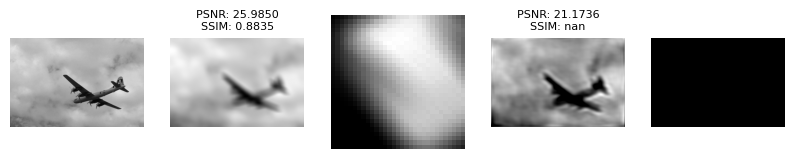

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


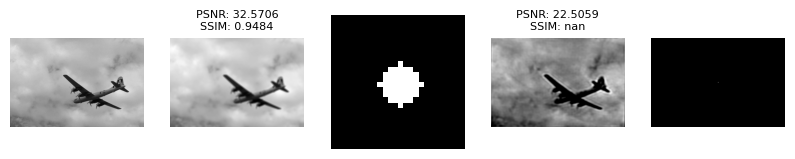

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


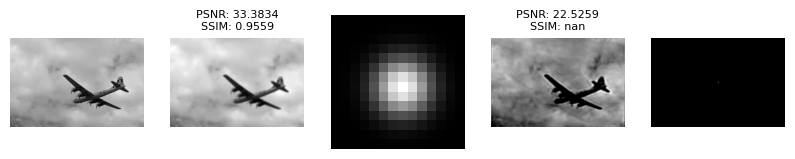

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


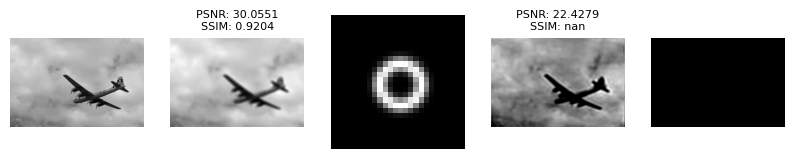

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


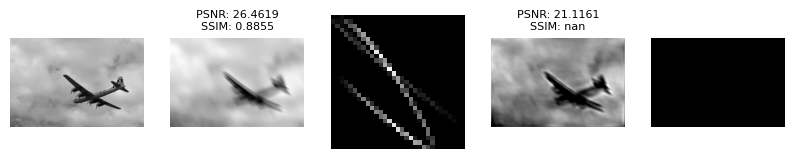

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


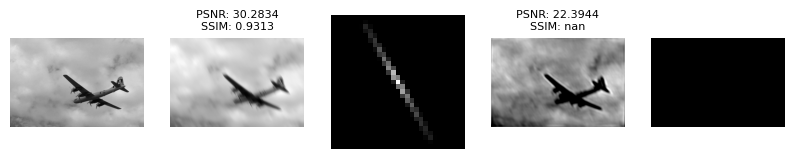

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


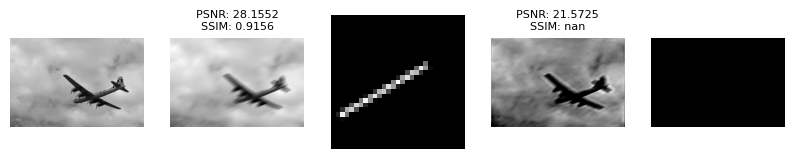

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


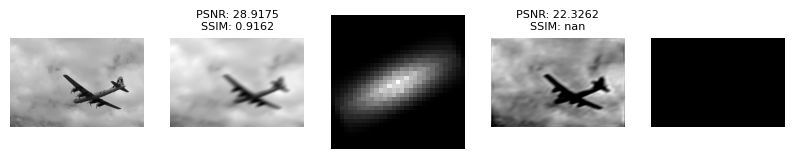

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


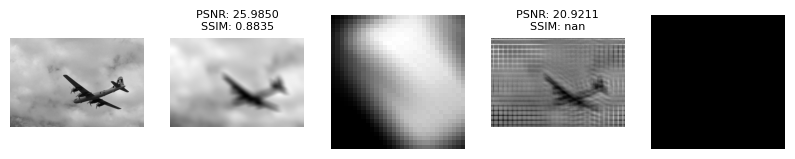

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


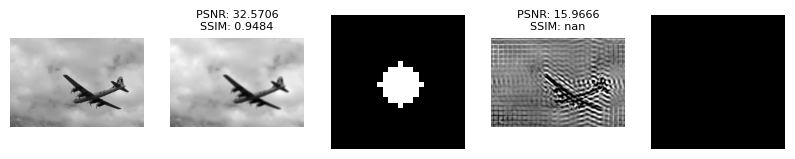

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


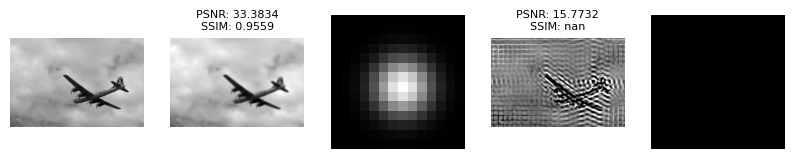

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


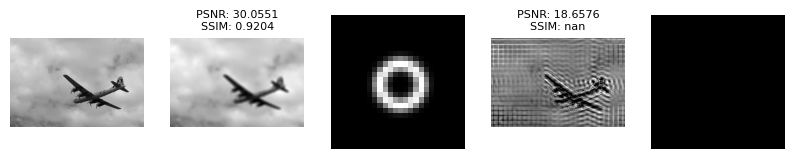

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


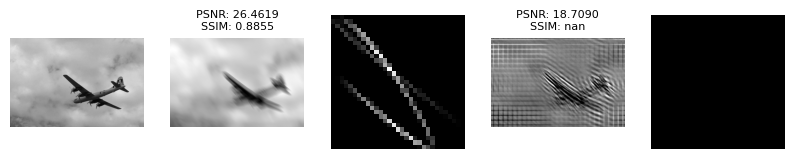

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


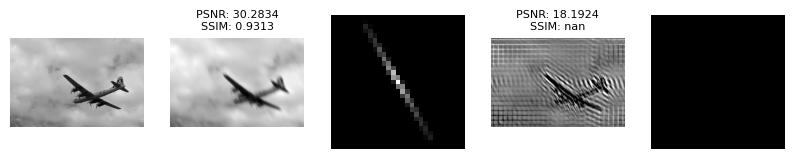

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


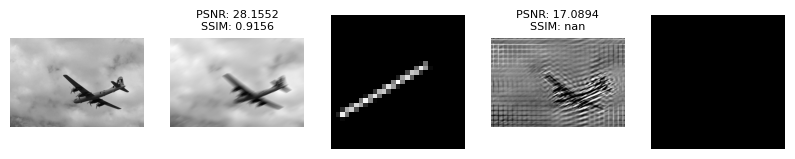

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


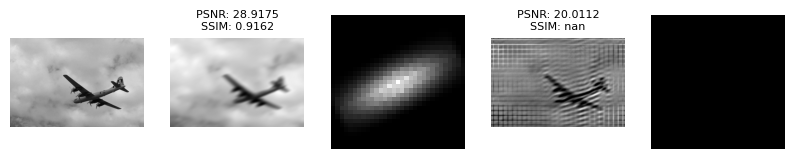

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


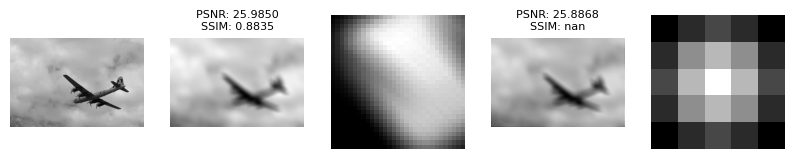

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


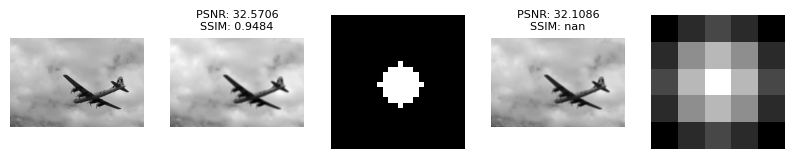

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


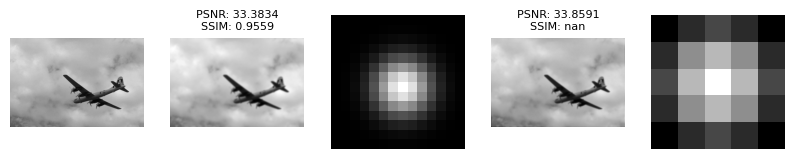

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


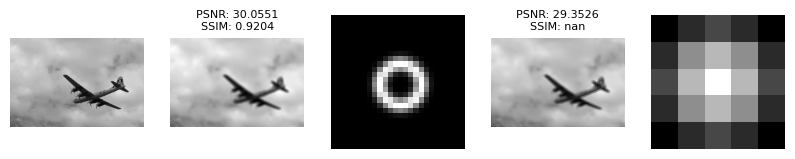

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


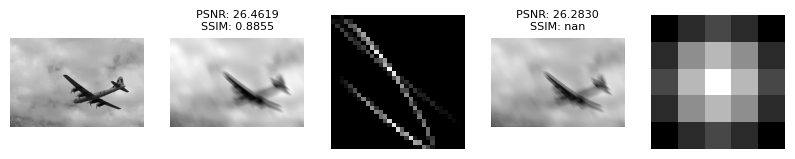

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


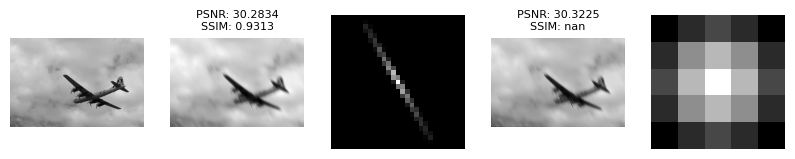

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


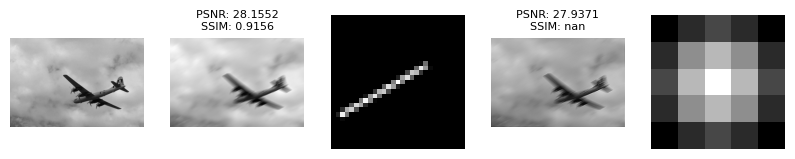

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


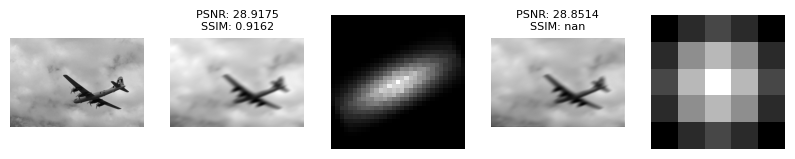

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


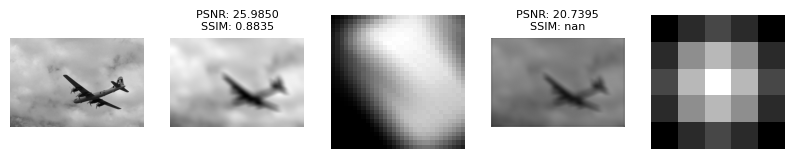

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


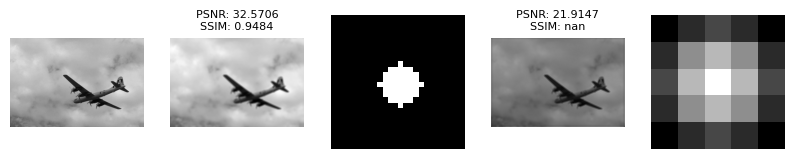

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


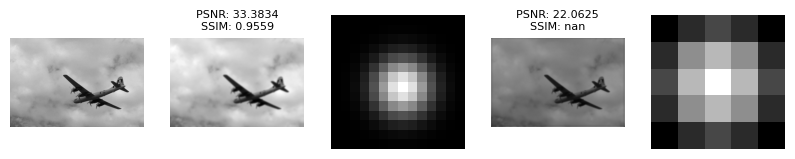

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


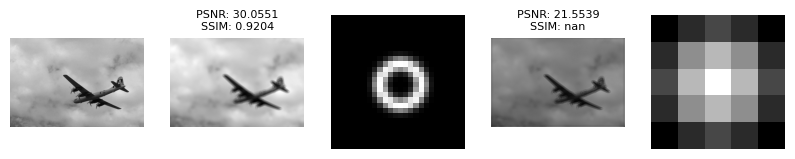

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


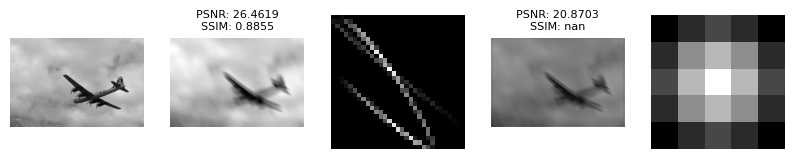

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


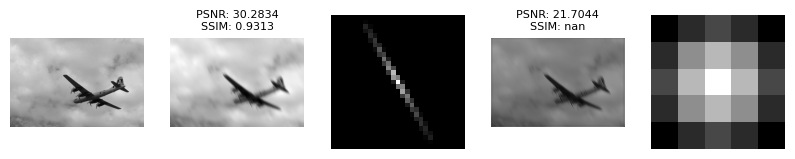

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


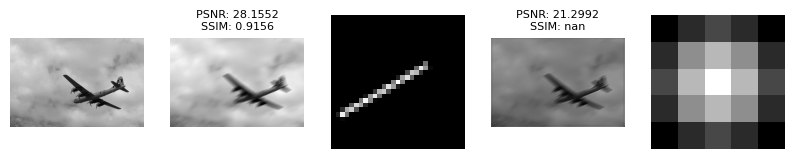

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


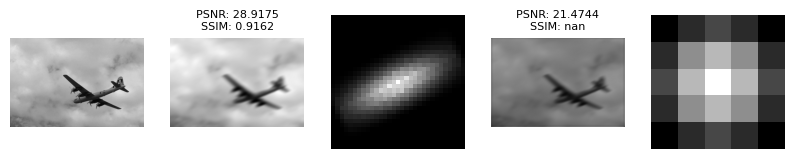

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


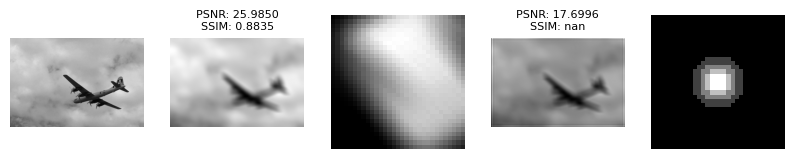

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


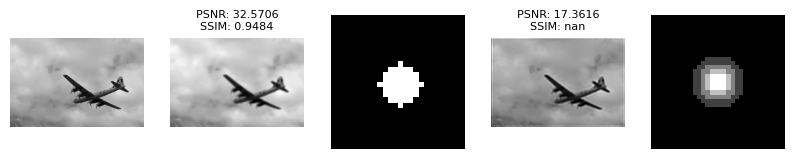

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


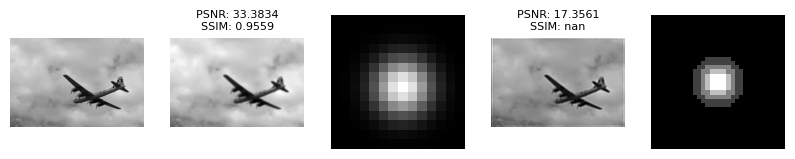

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


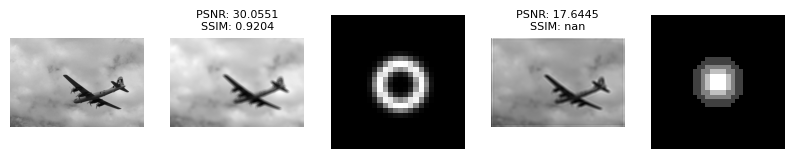

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


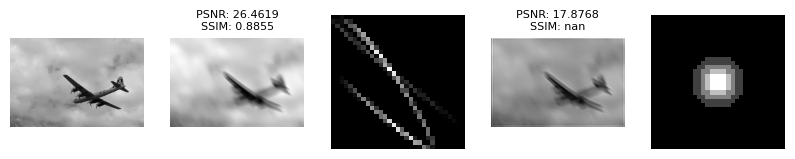

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


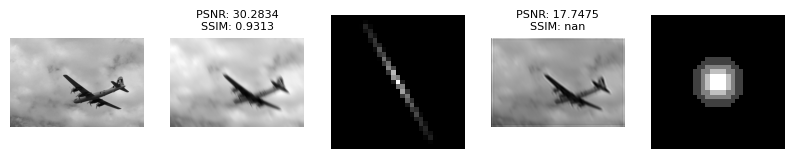

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


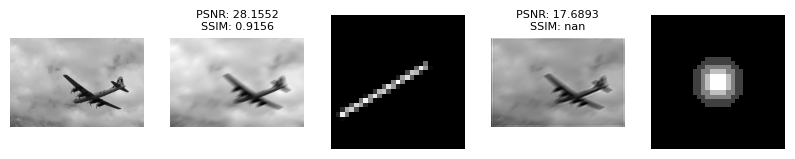

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


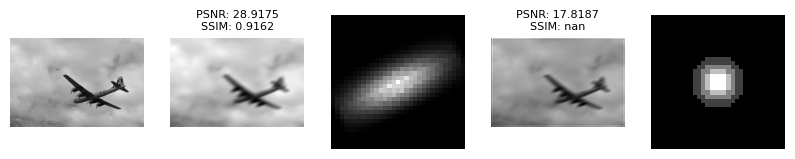

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


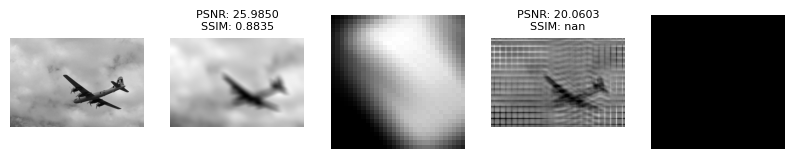

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


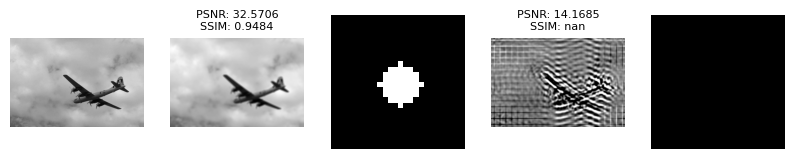

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


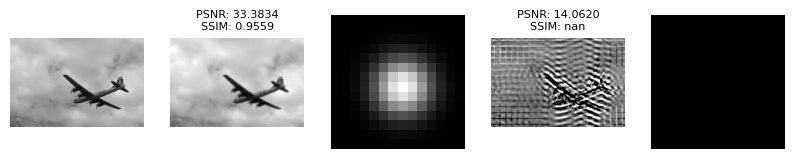

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


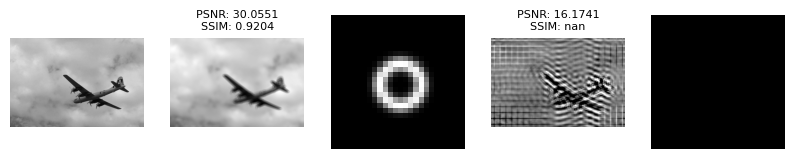

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


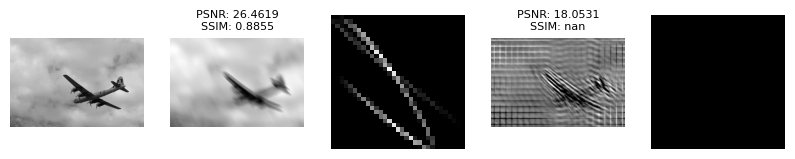

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


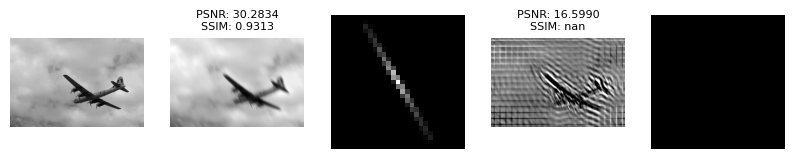

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


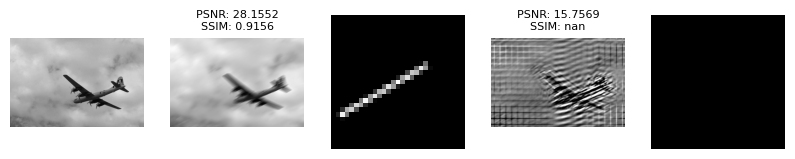

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


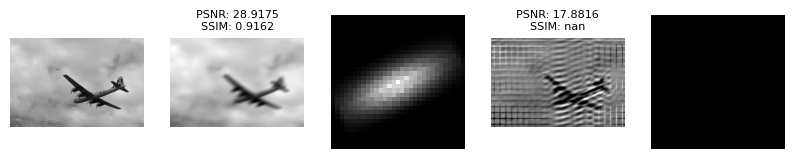

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "boy.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


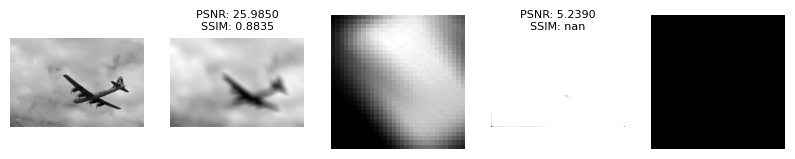

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


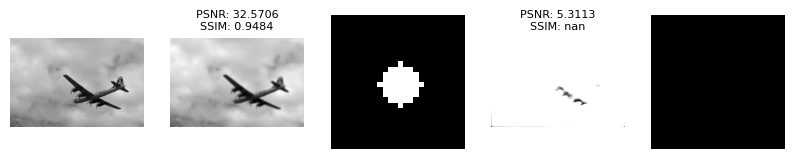

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


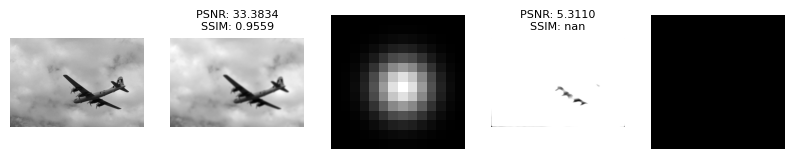

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


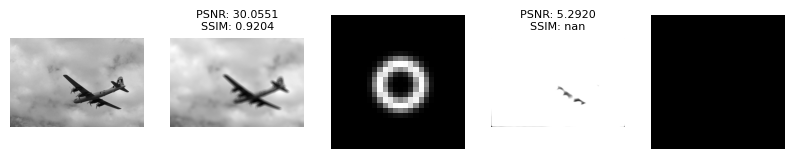

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


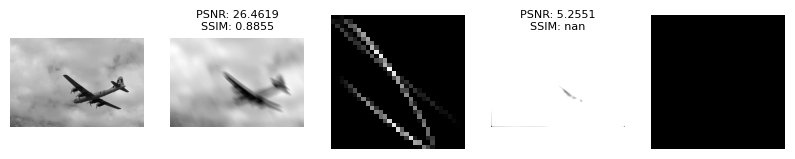

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


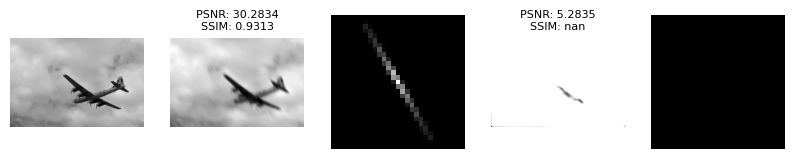

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


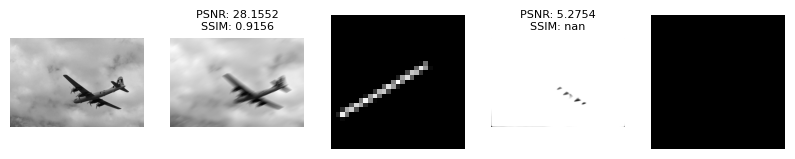

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


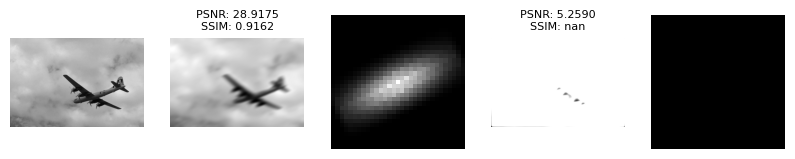

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 3. cameraman.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


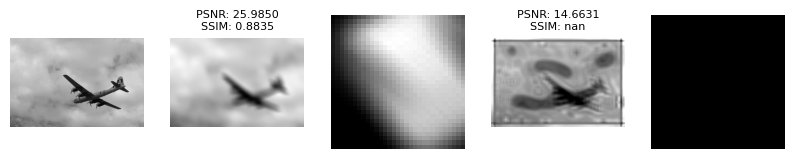

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


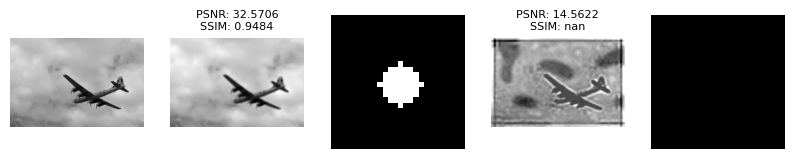

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


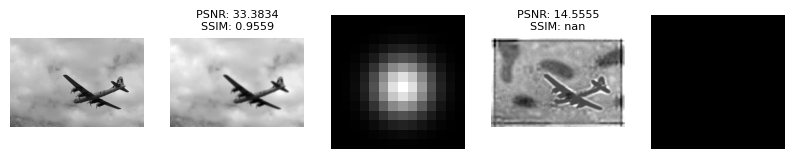

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


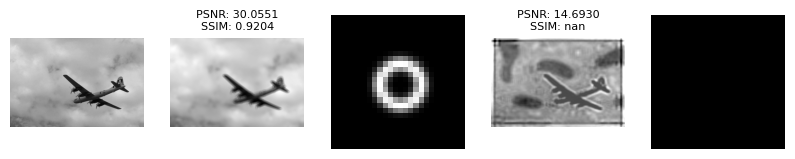

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


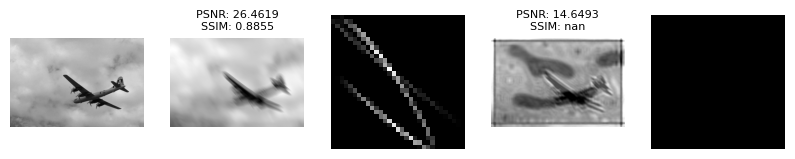

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


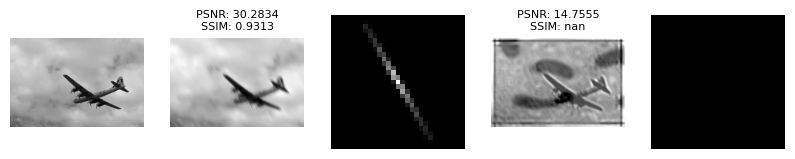

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


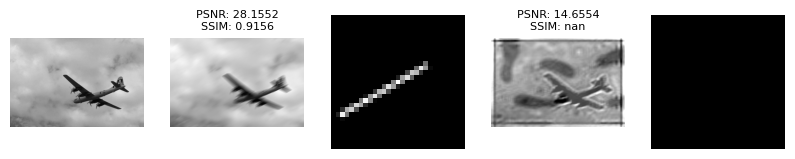

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


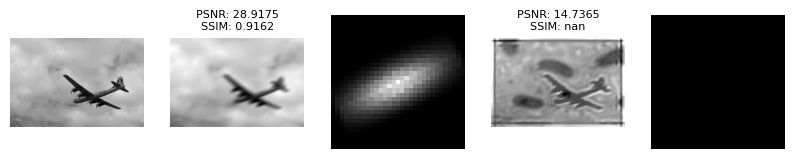

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


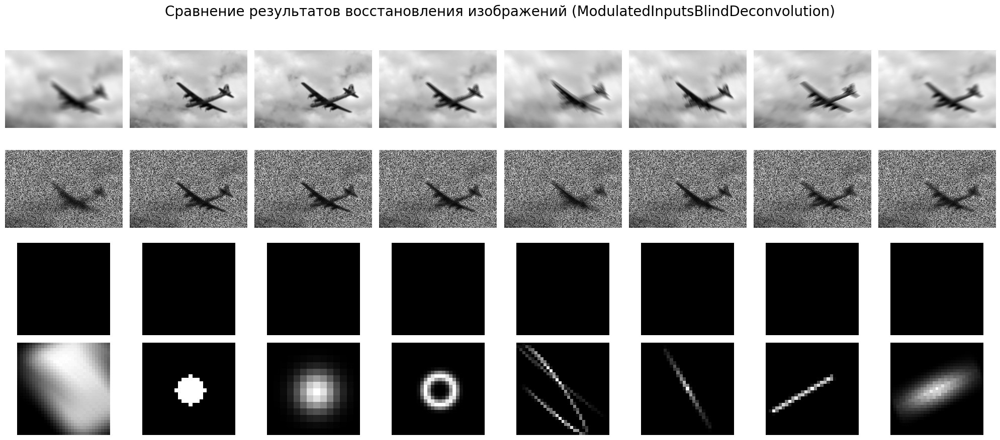

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


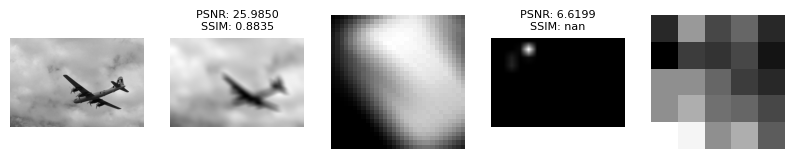

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


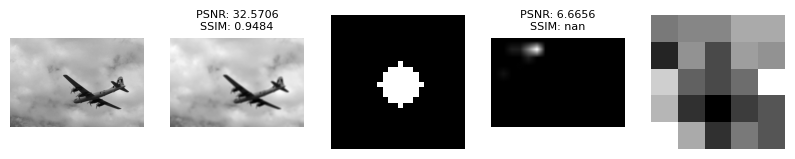

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


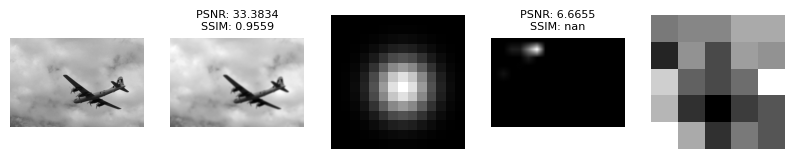

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


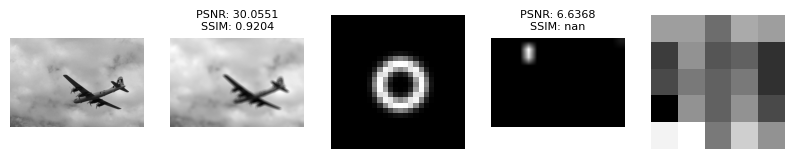

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


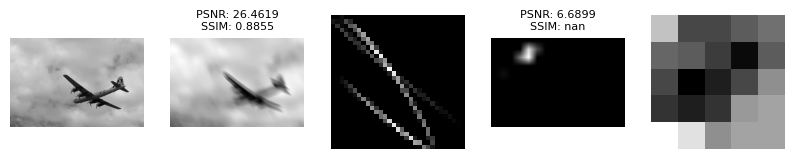

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


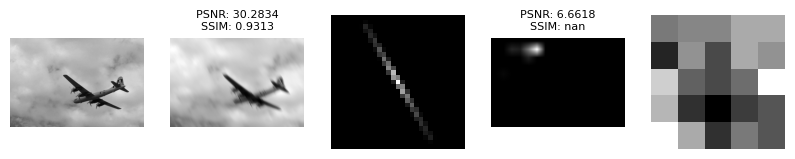

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


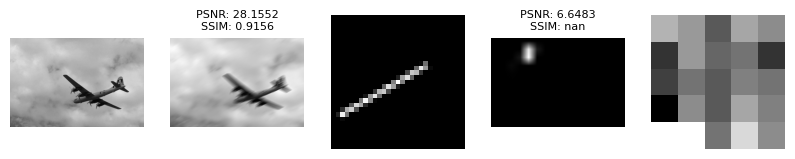

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


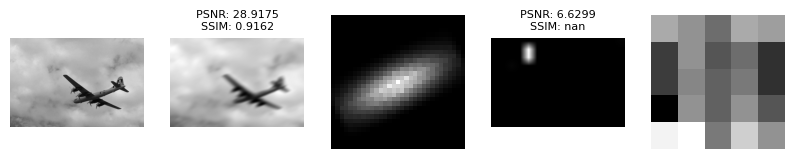

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


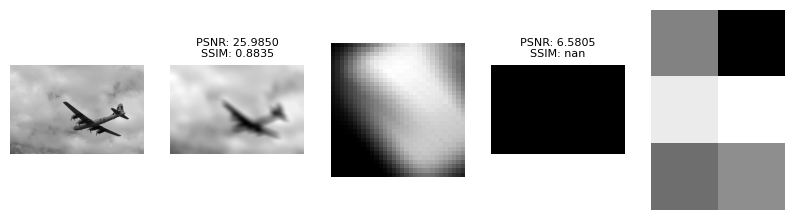

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

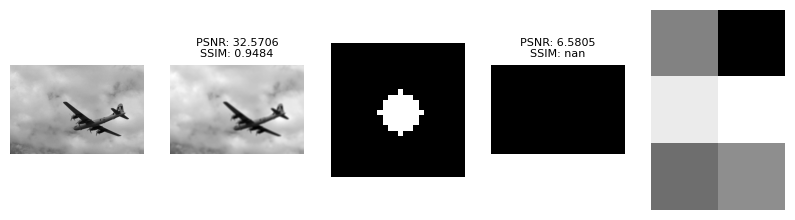

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

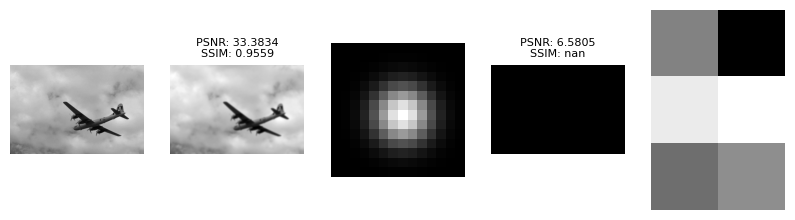

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

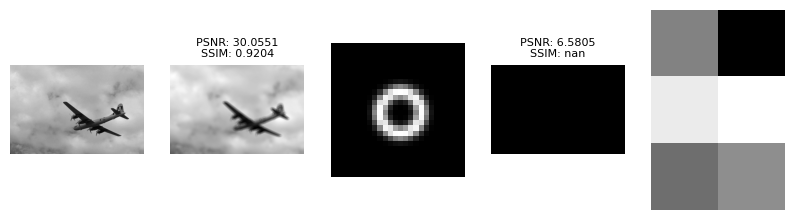

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

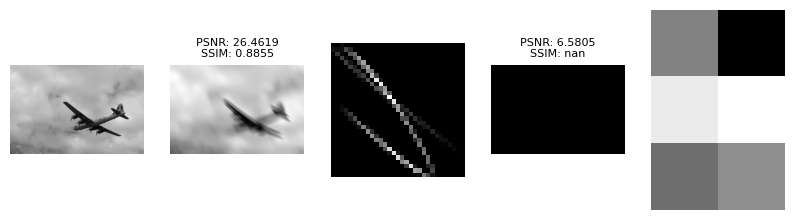

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

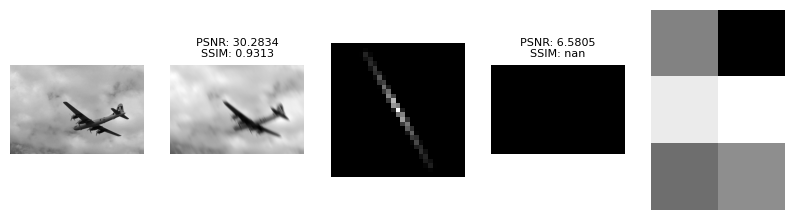

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

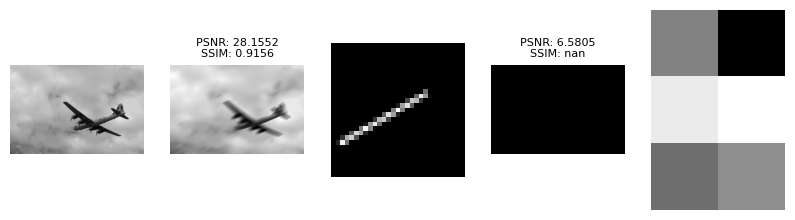

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

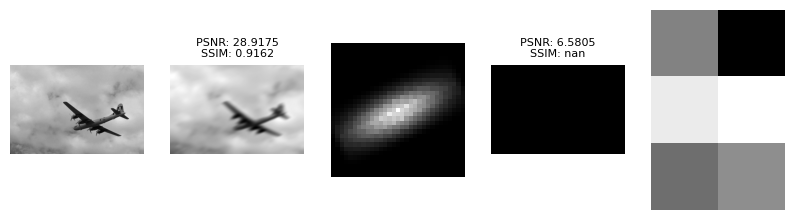

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


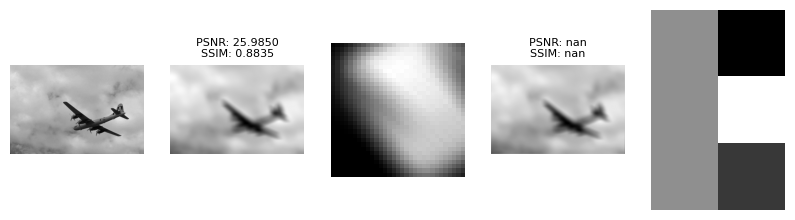

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


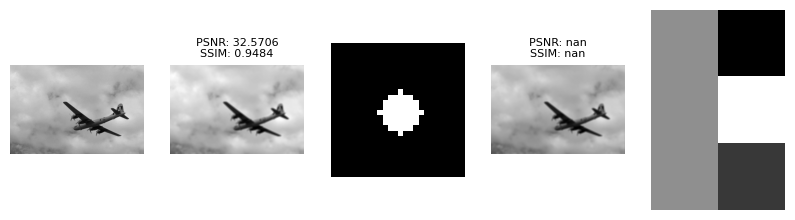

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


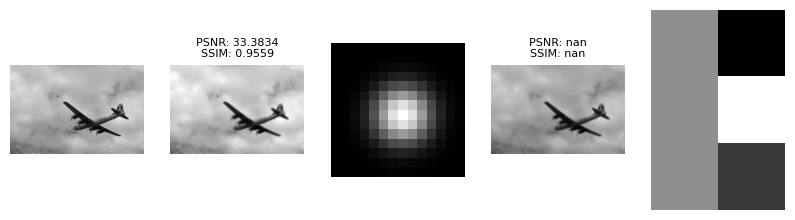

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


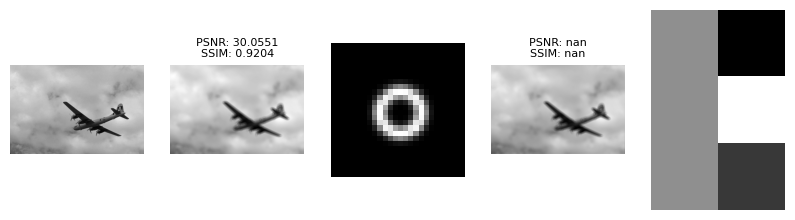

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


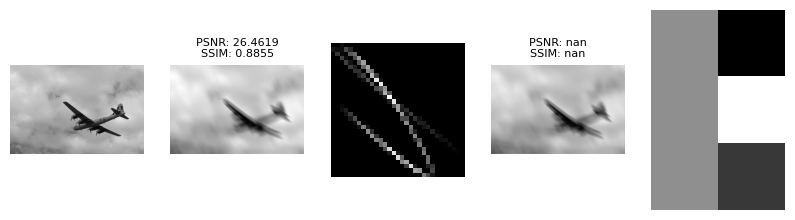

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


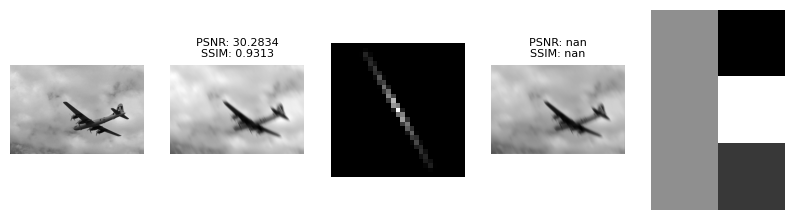

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


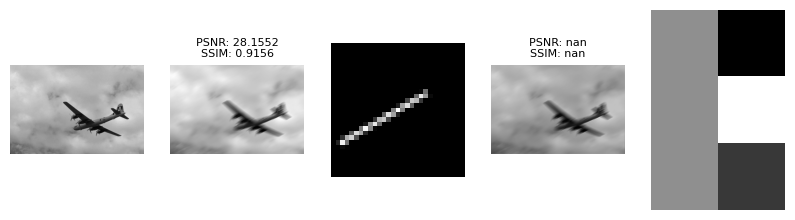

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


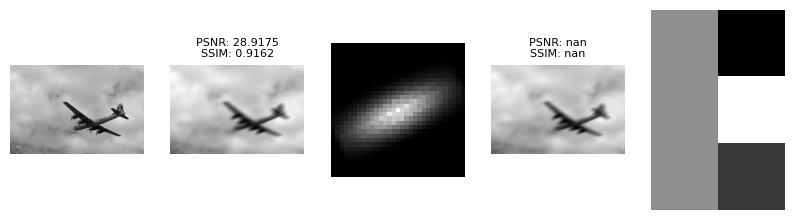

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


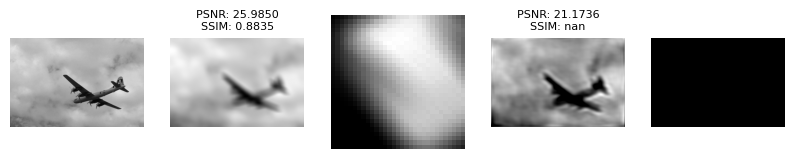

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


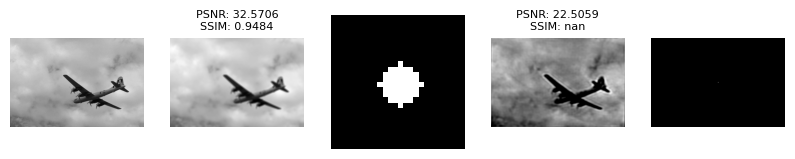

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


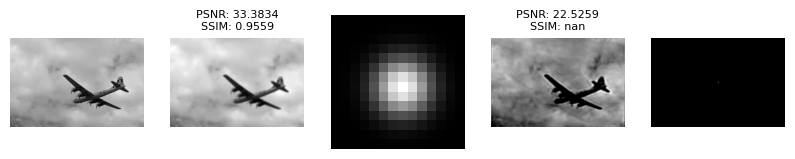

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


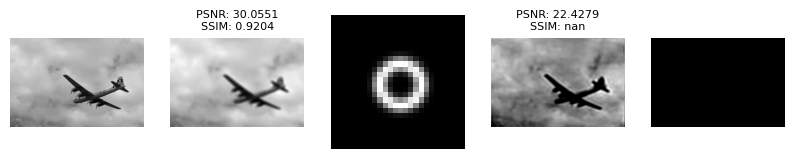

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


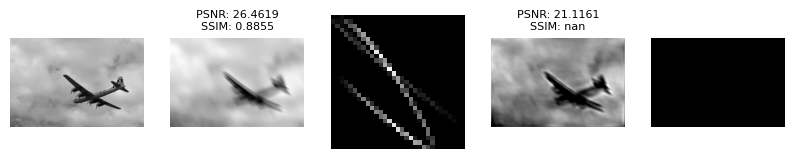

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


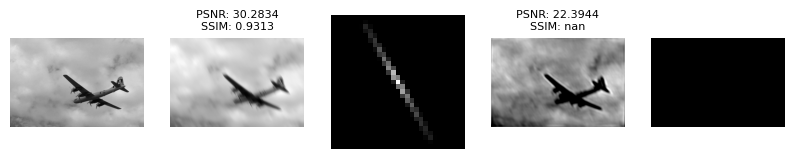

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


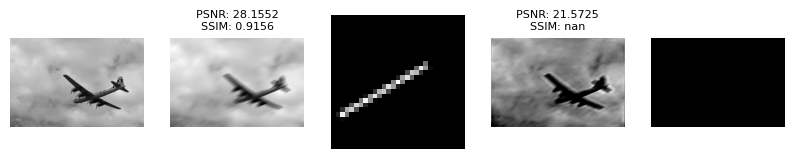

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


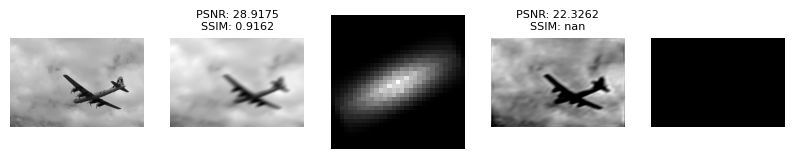

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


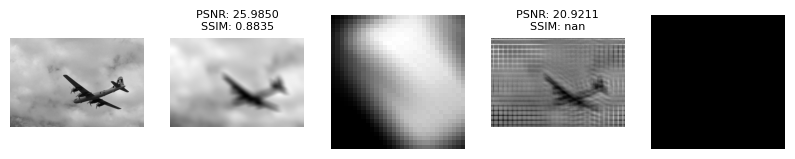

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


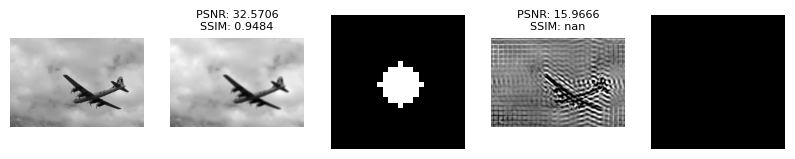

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


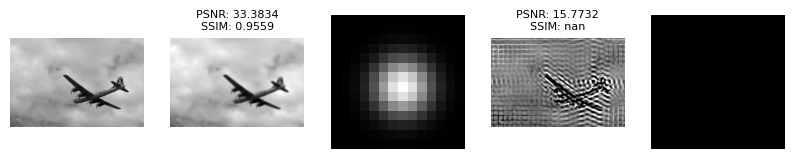

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


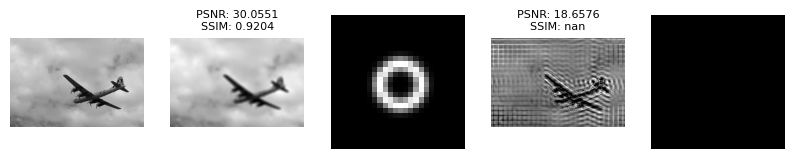

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


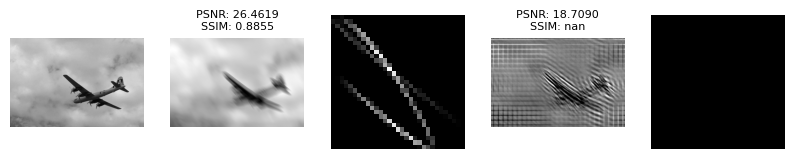

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


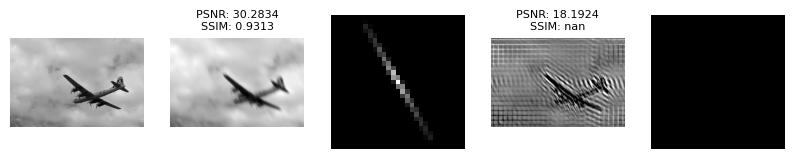

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


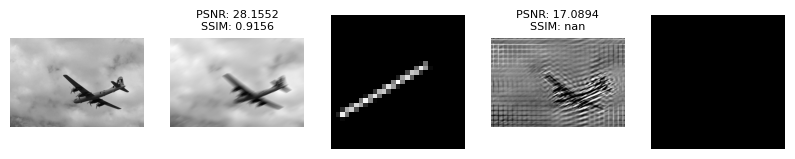

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


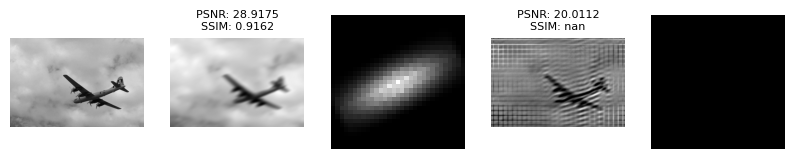

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


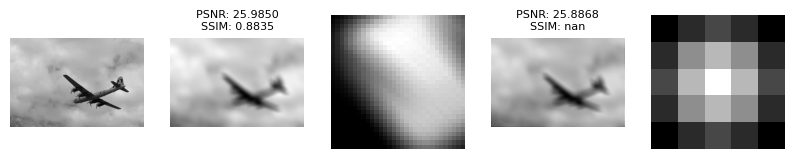

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


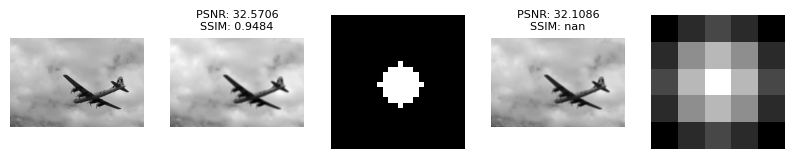

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


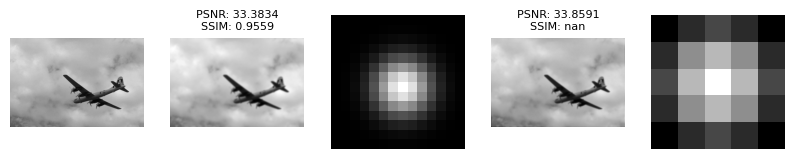

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


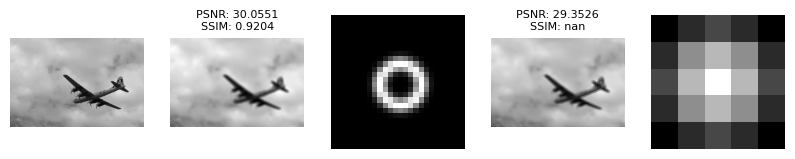

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


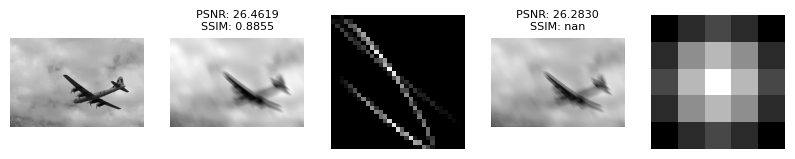

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


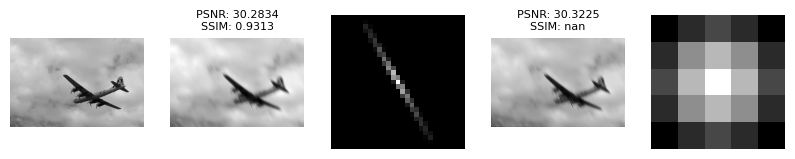

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


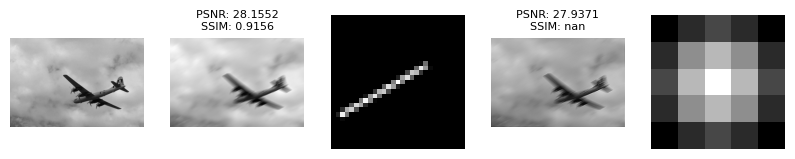

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


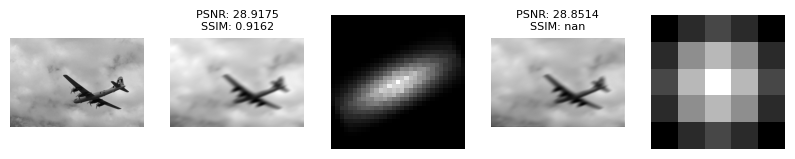

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


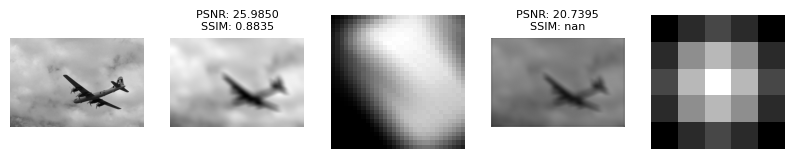

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


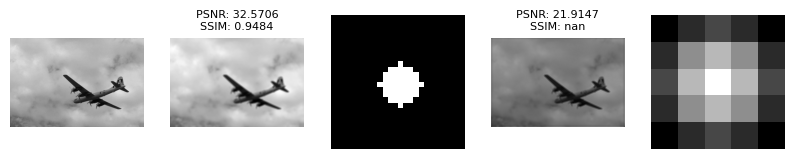

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


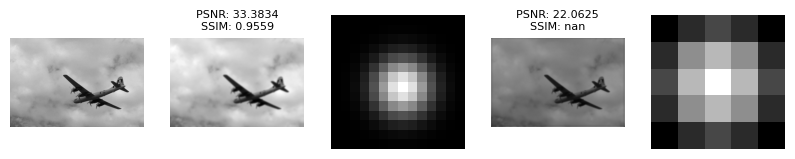

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


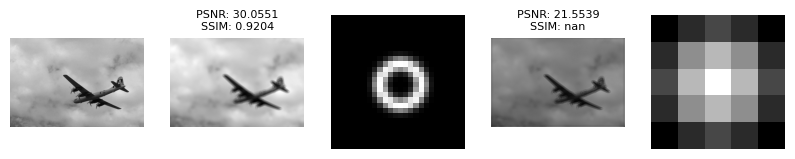

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


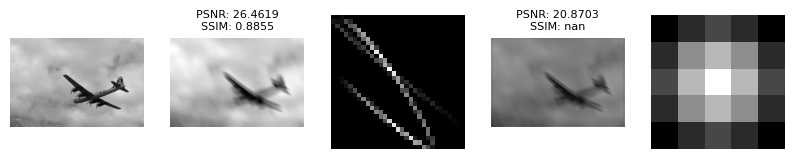

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


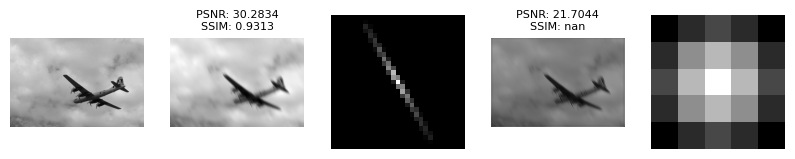

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


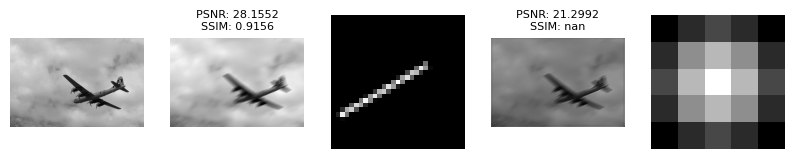

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


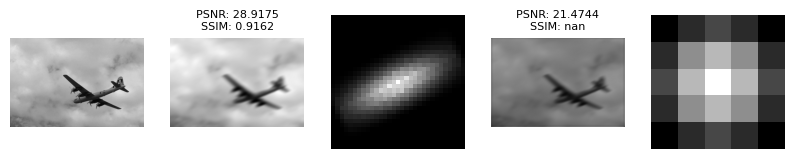

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


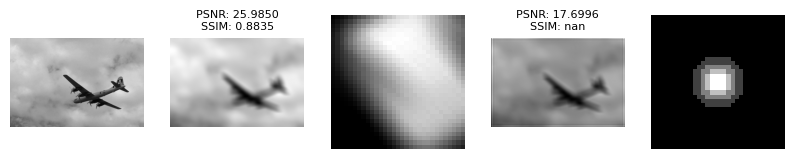

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


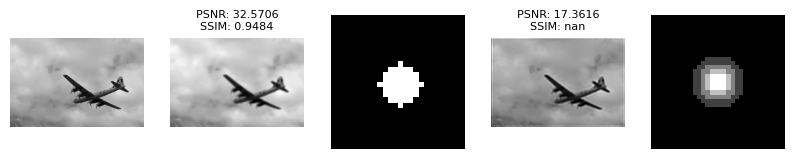

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


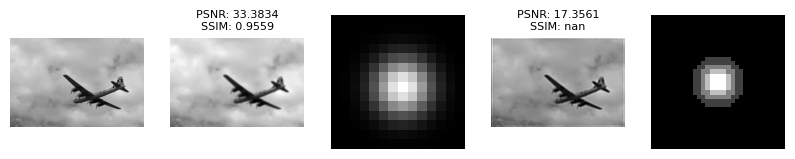

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


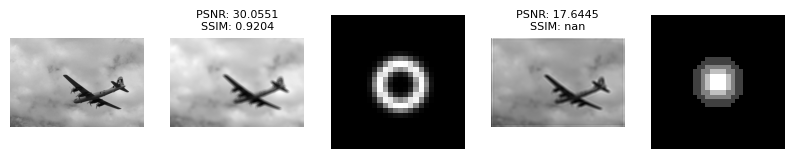

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


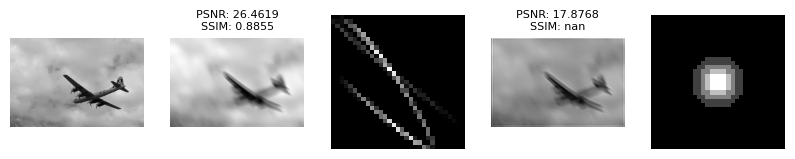

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


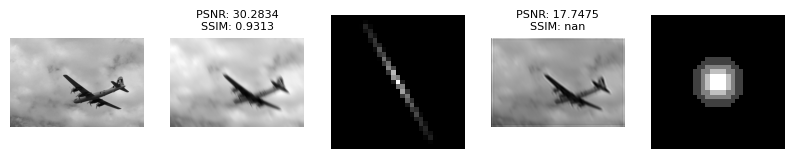

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


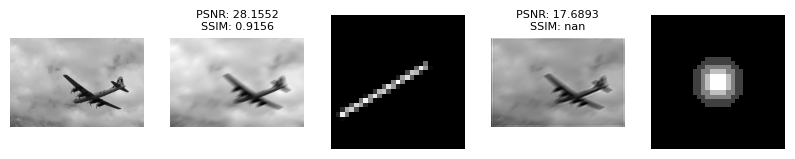

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


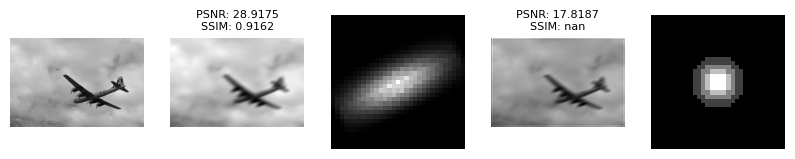

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


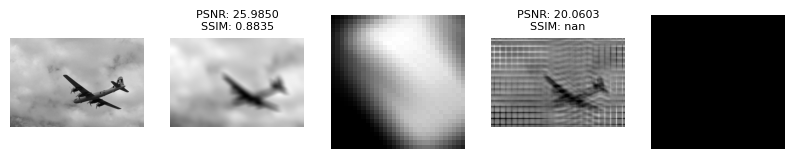

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


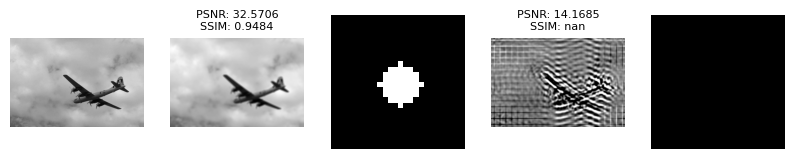

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


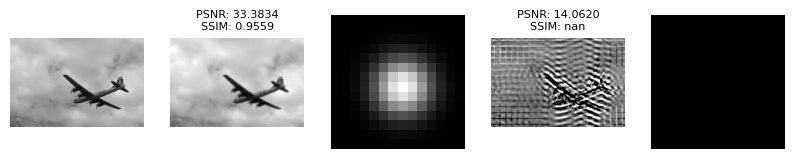

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


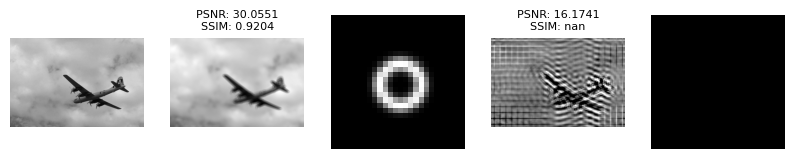

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


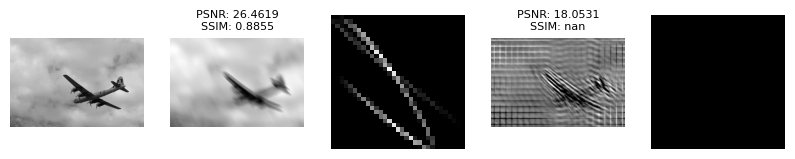

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


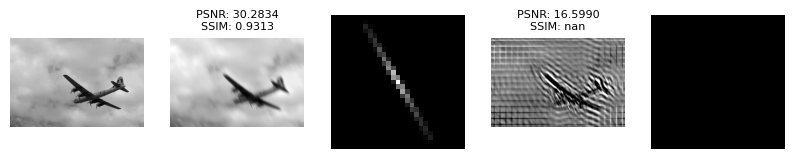

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


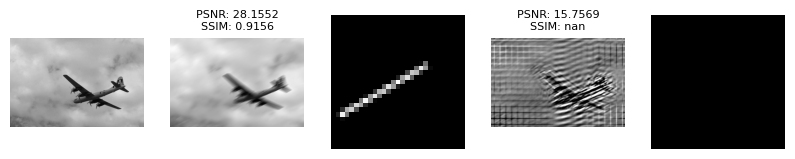

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


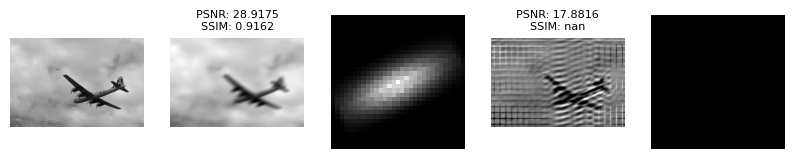

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "cameraman.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


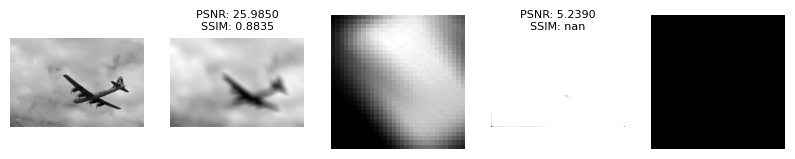

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


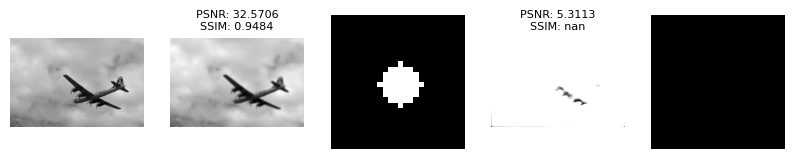

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


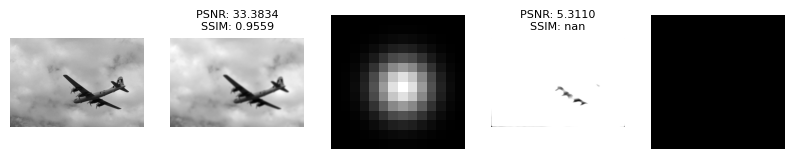

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


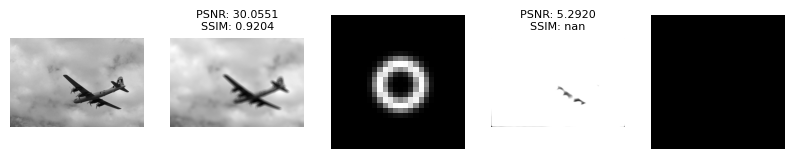

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


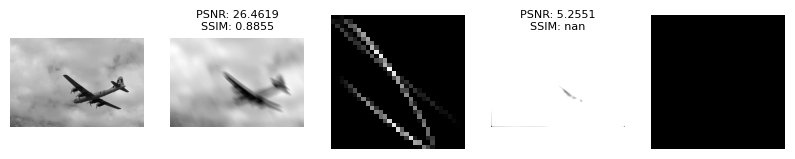

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


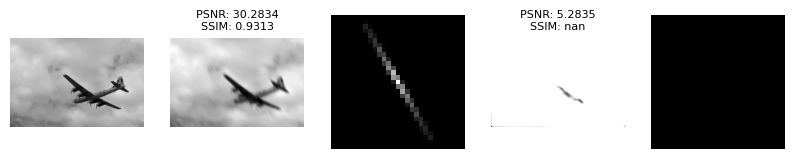

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


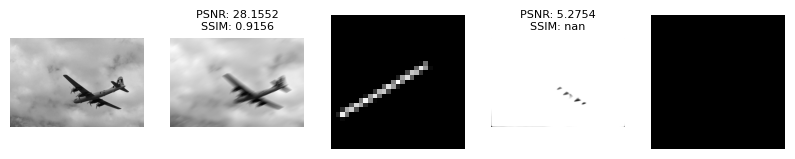

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


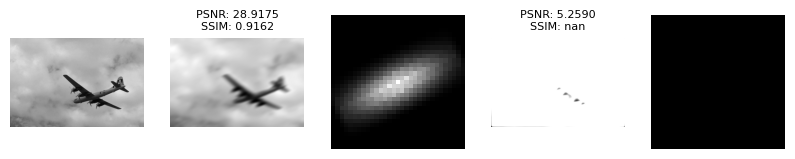

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 4. childs.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


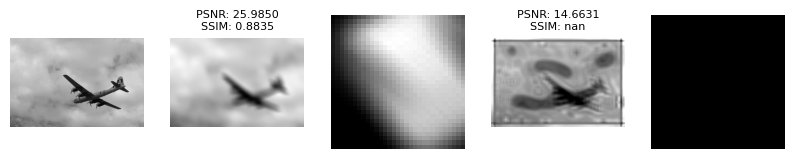

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


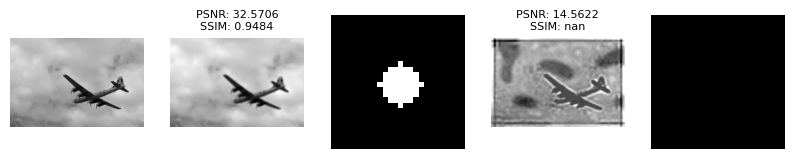

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


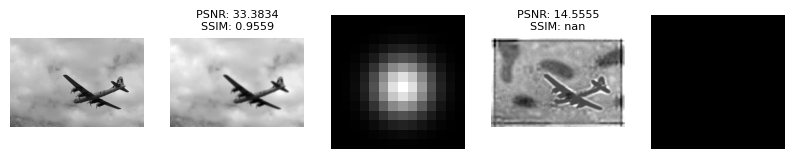

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


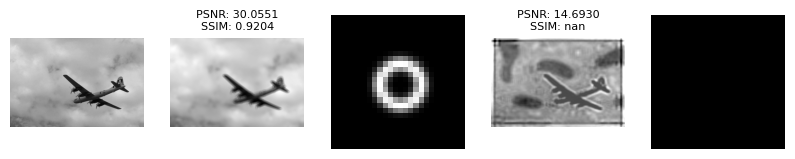

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


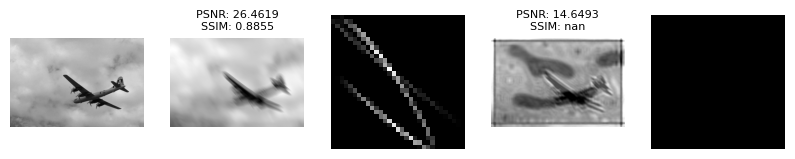

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


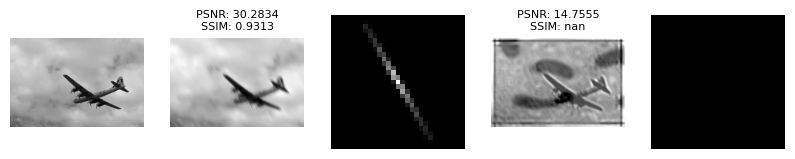

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


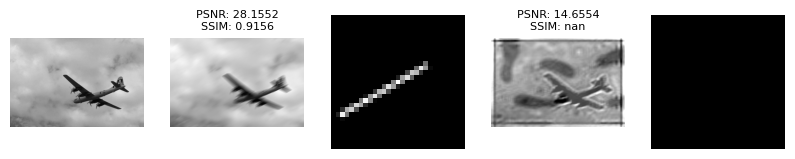

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


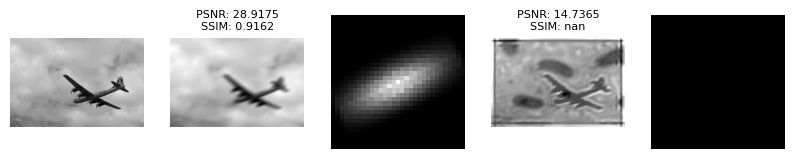

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


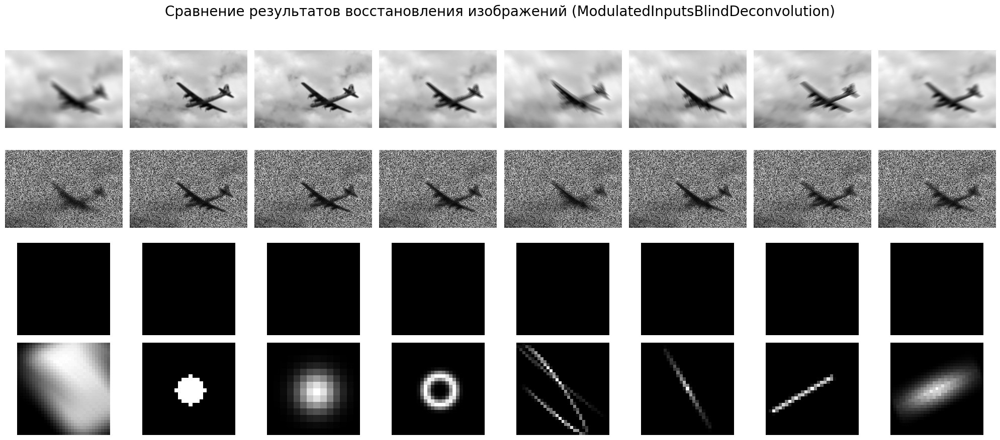

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


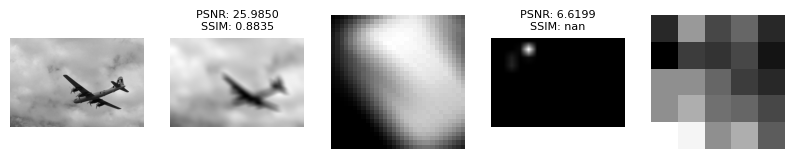

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


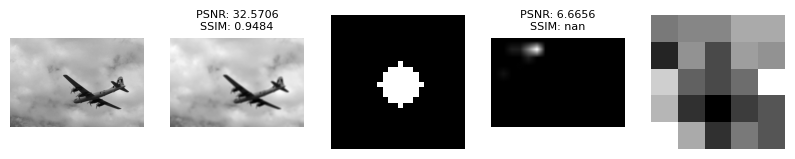

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


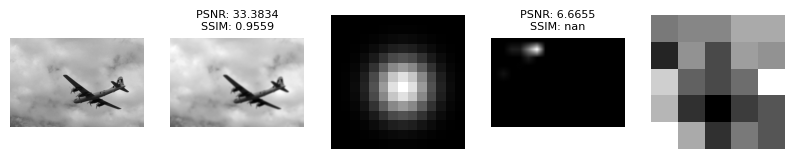

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


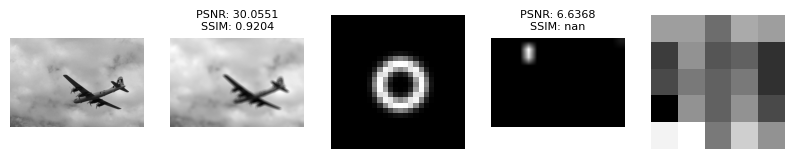

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


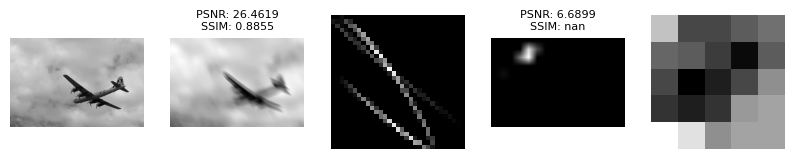

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


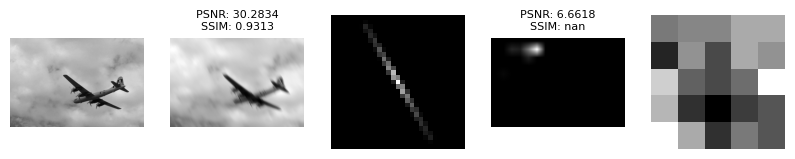

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


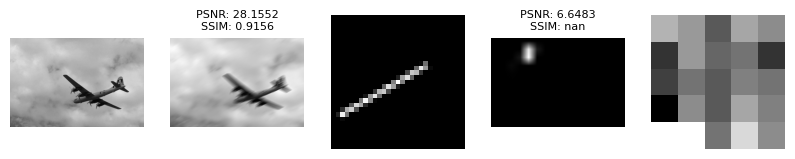

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


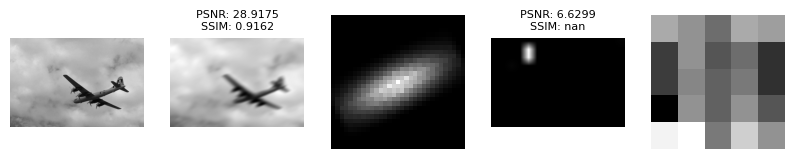

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


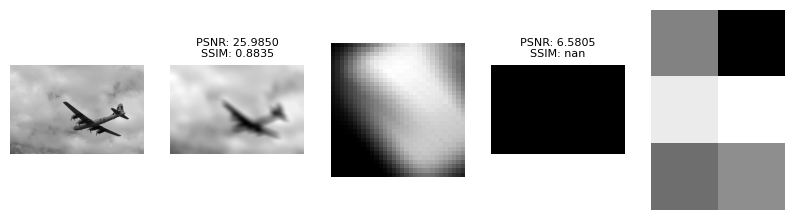

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

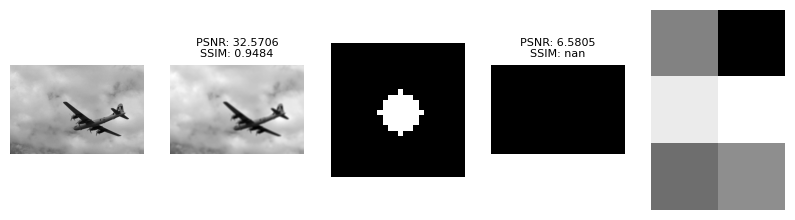

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

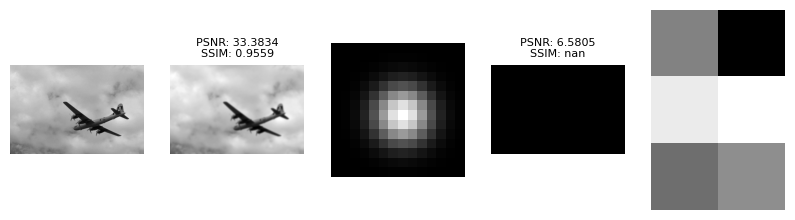

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

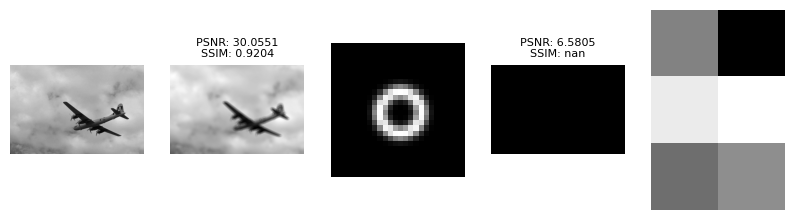

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

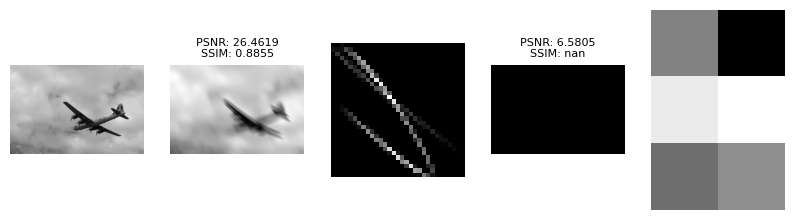

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

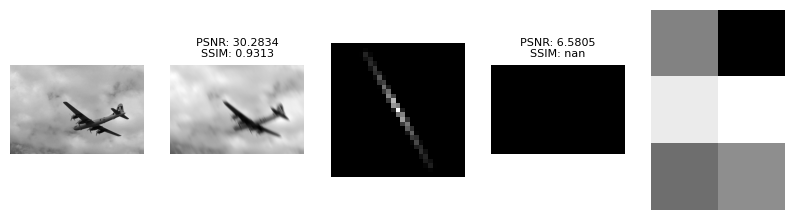

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

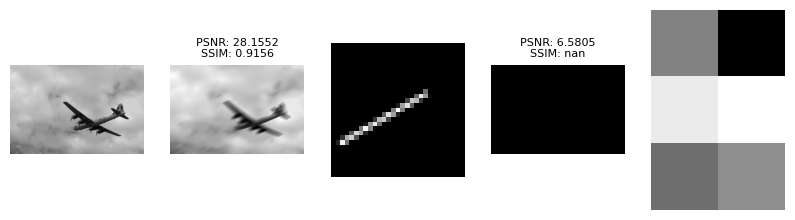

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

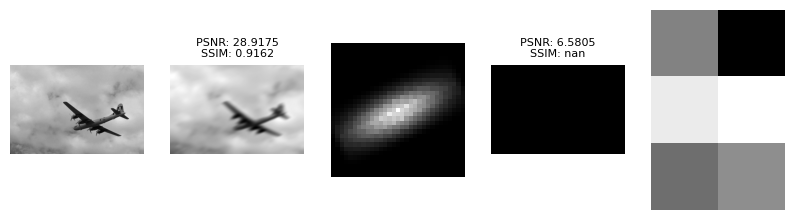

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


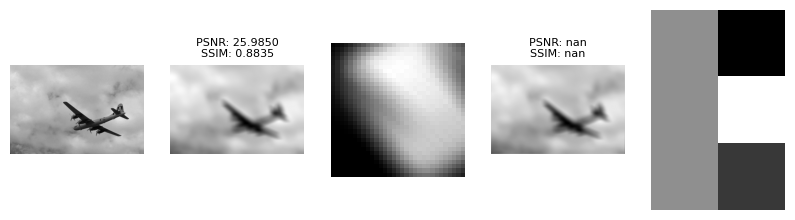

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


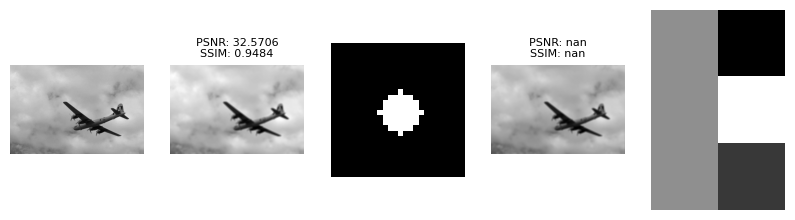

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


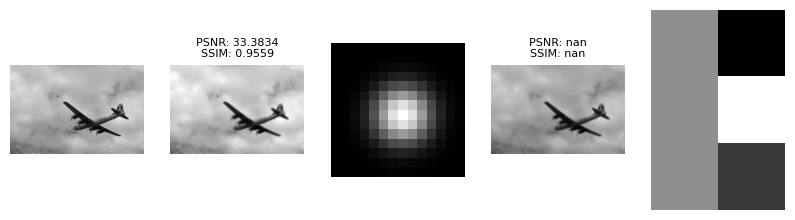

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


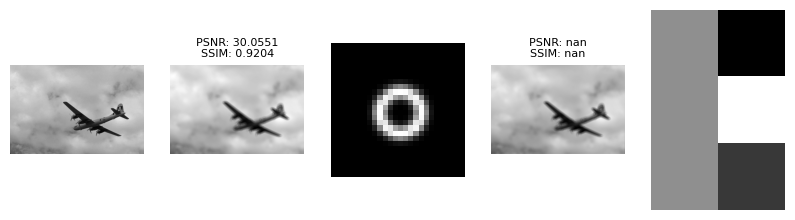

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


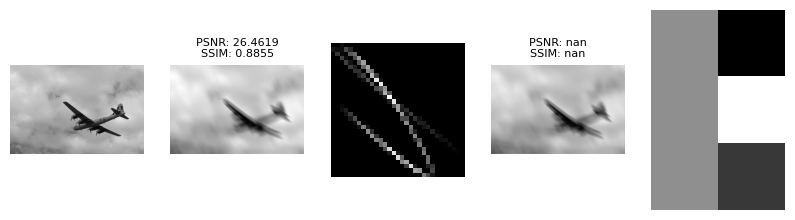

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


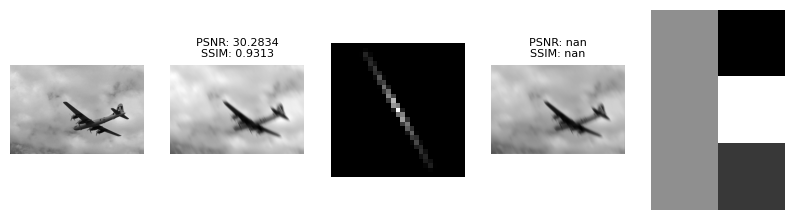

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


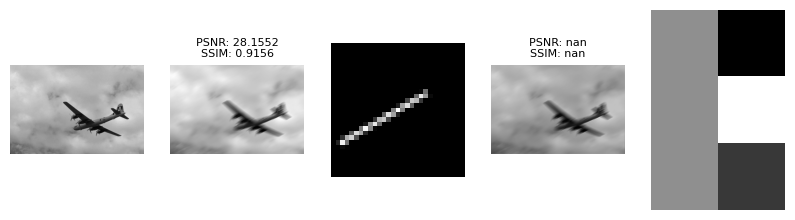

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


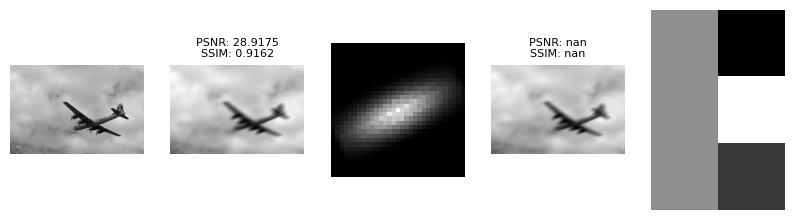

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


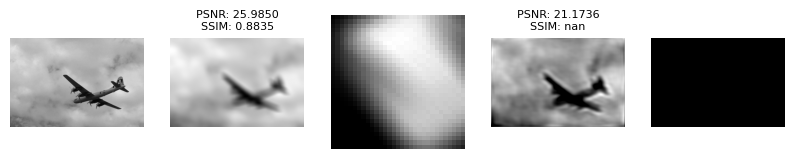

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


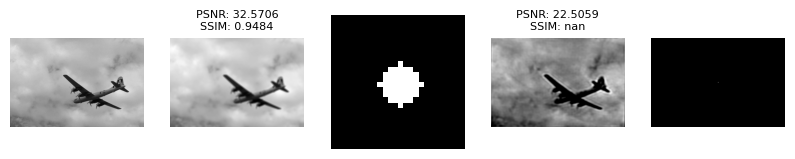

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


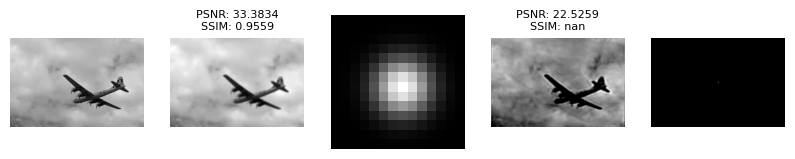

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


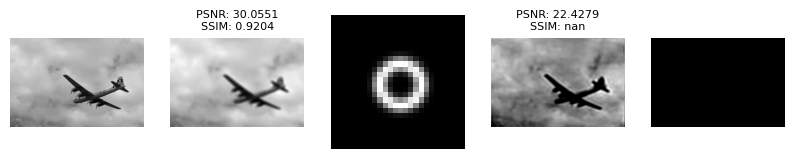

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


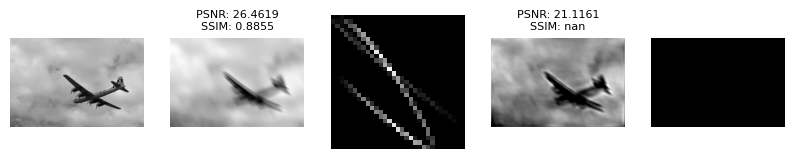

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


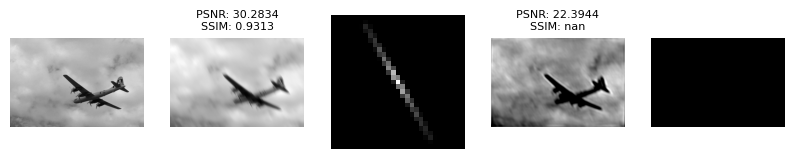

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


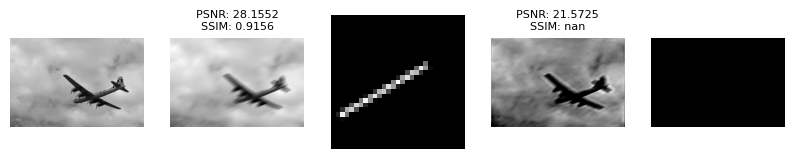

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


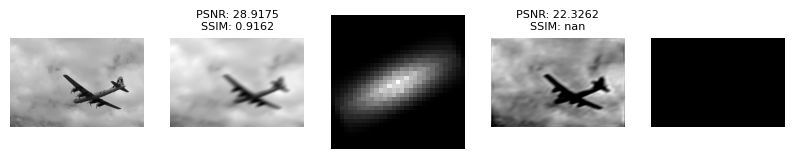

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


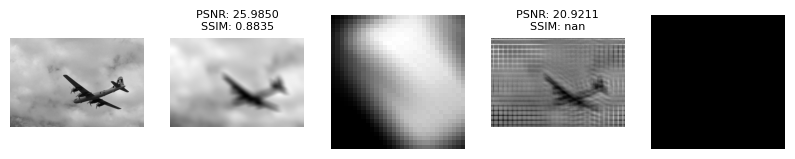

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


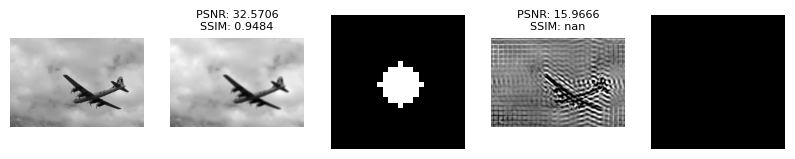

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


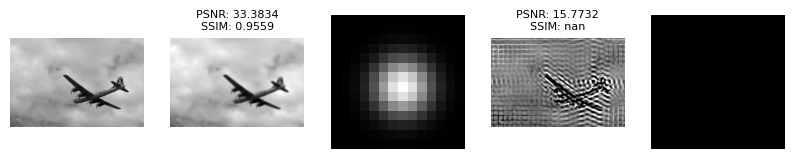

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


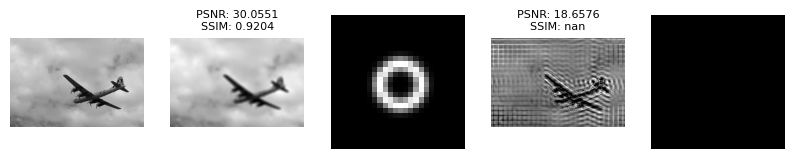

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


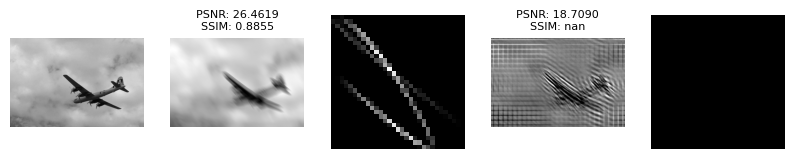

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


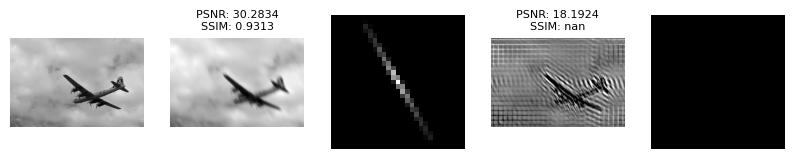

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


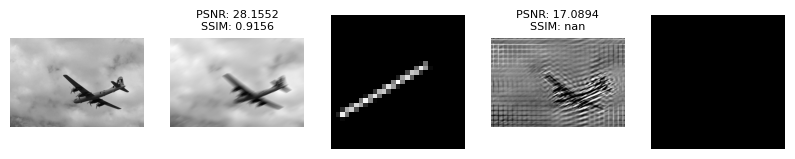

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


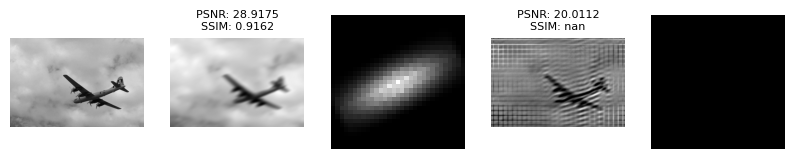

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


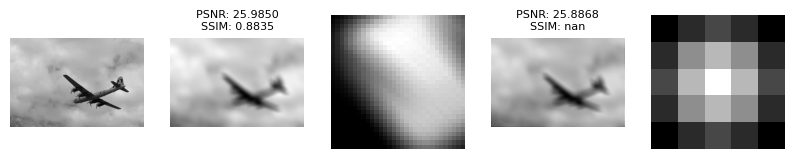

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


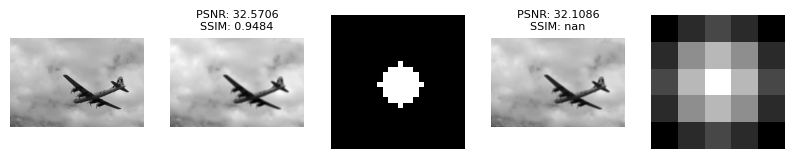

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


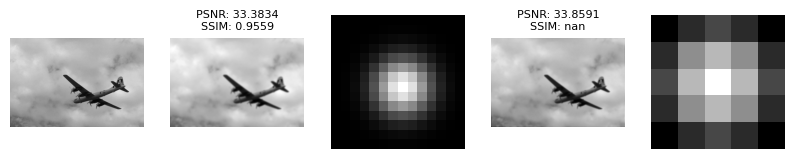

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


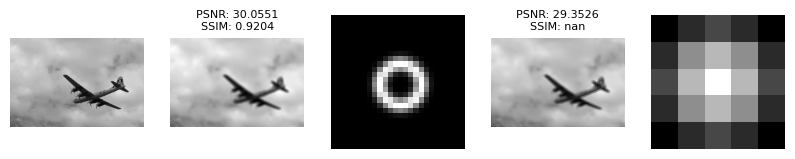

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


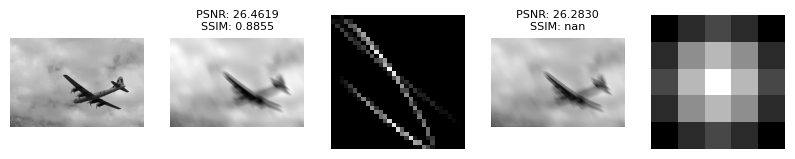

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


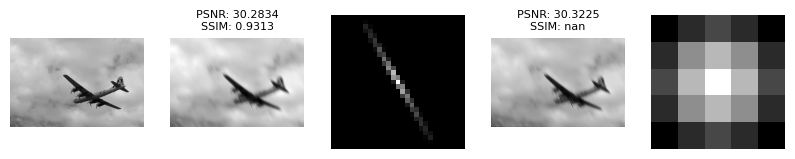

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


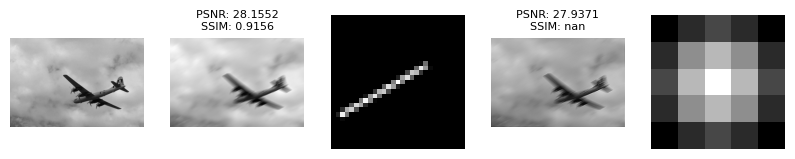

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


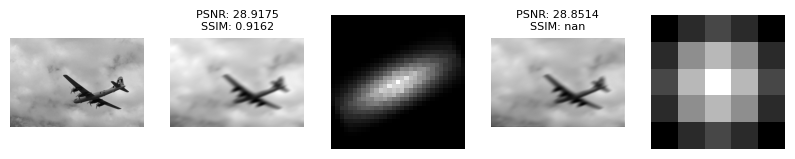

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


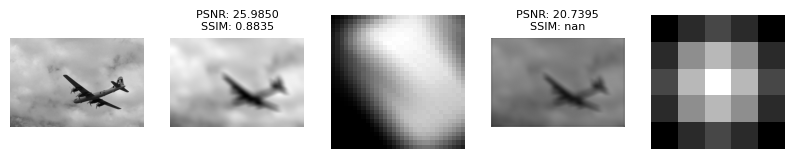

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


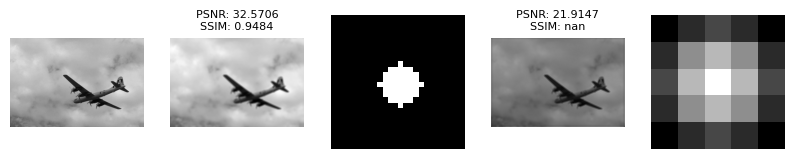

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


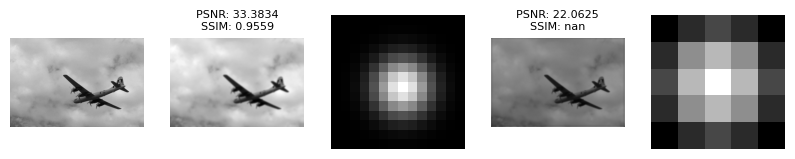

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


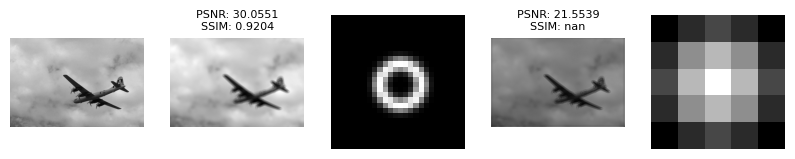

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


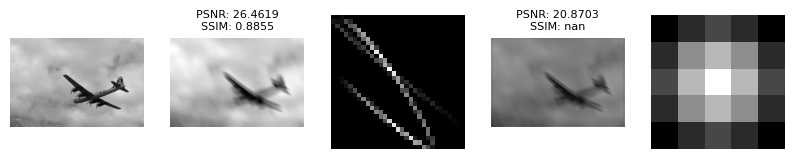

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


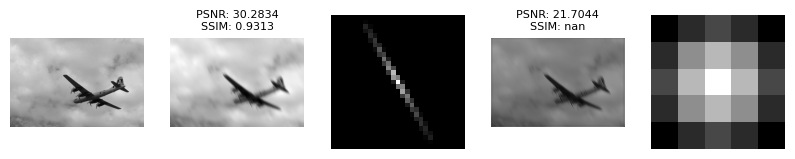

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


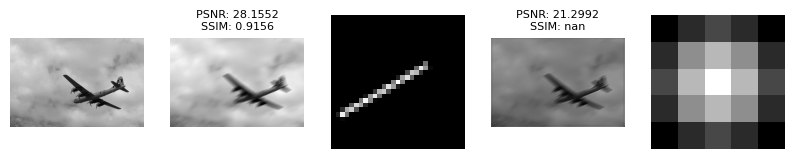

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


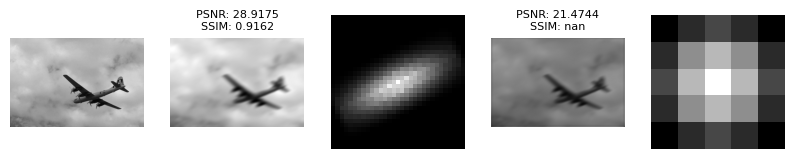

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


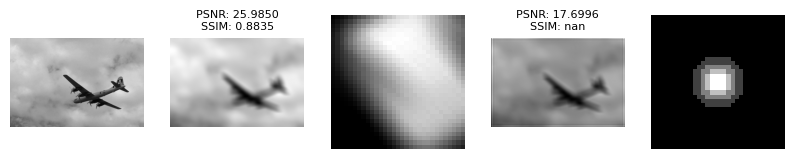

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


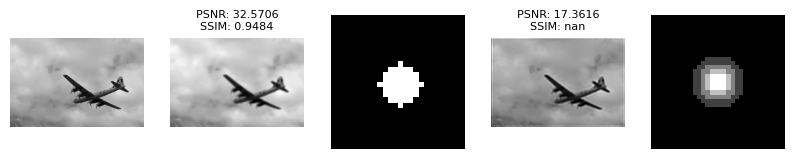

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


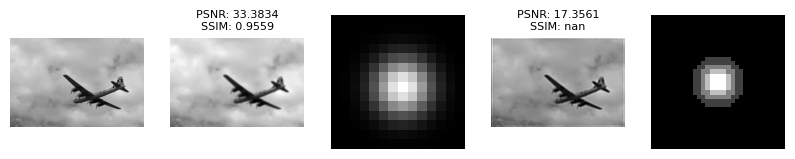

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


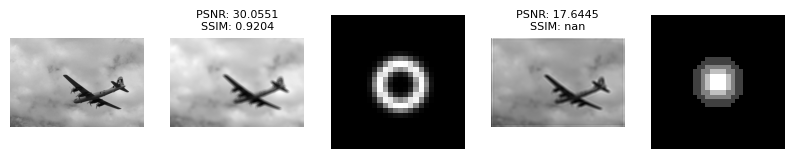

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


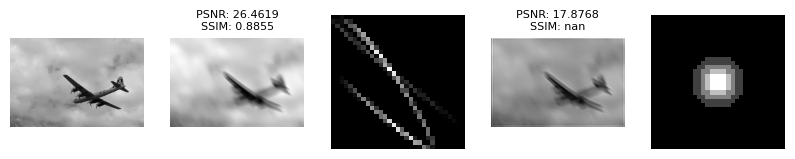

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


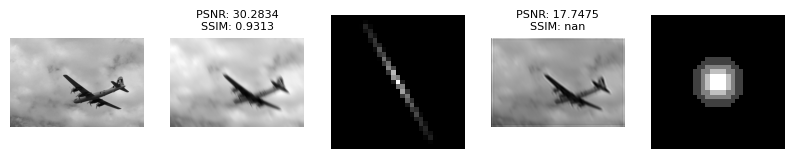

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


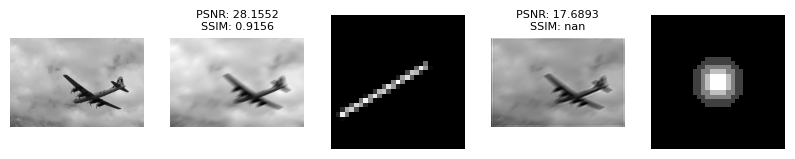

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


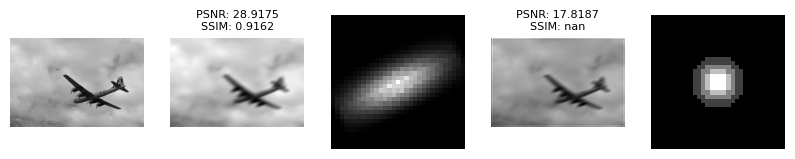

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


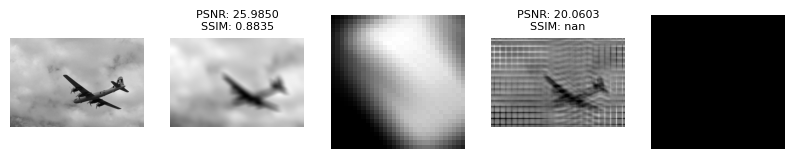

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


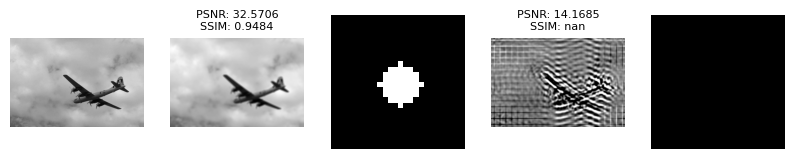

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


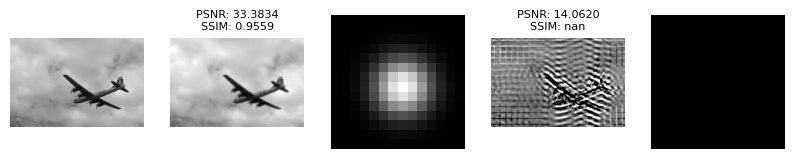

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


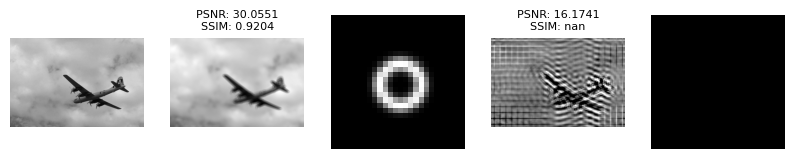

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


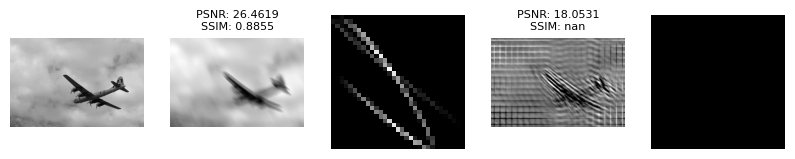

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


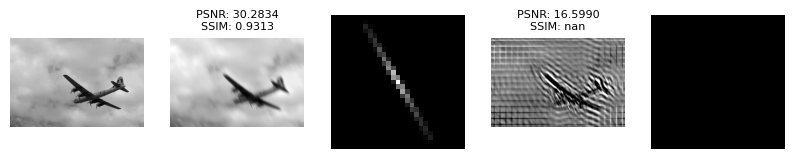

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


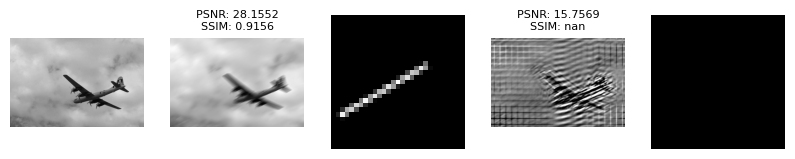

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


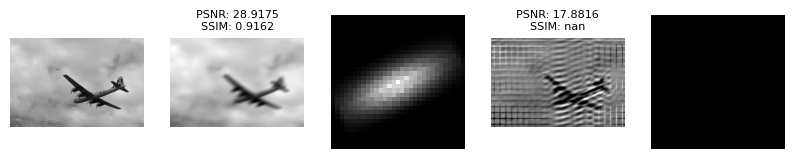

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "childs.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


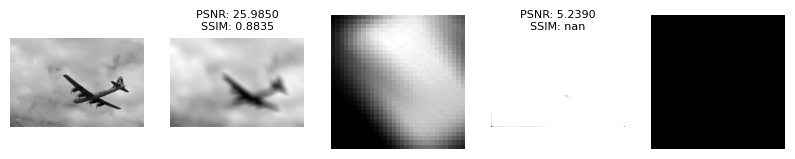

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


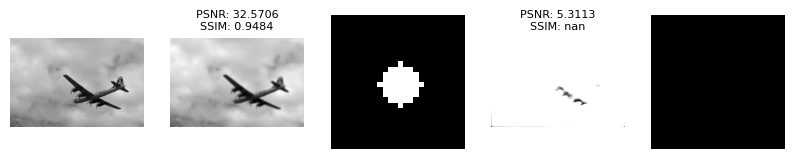

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


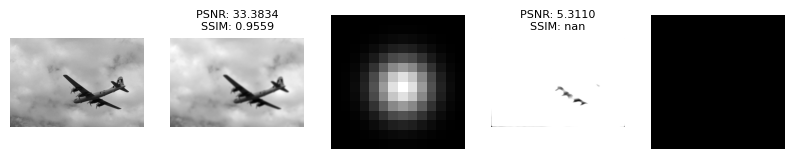

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


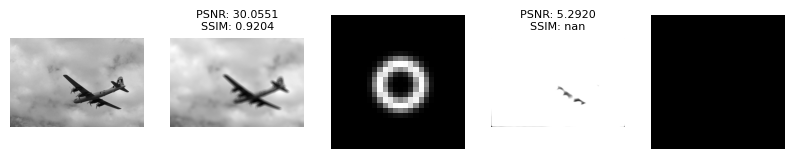

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


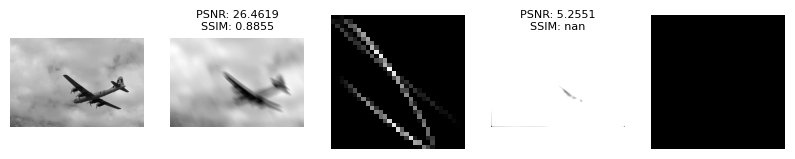

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


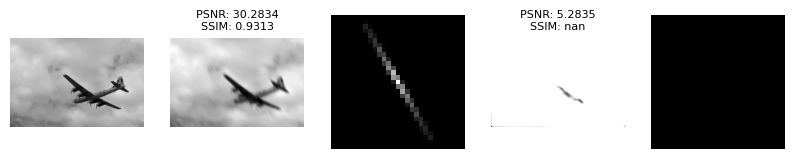

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


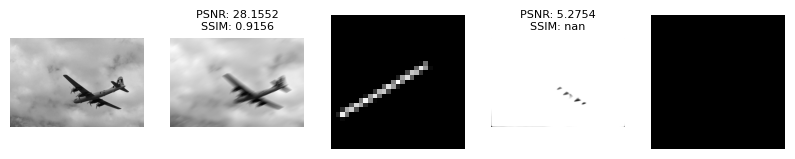

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


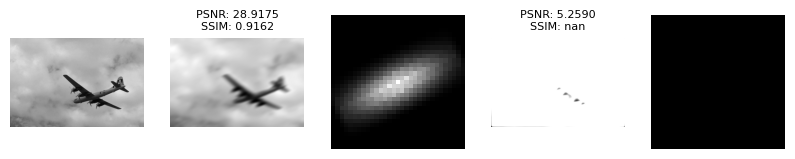

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 5. drawing.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


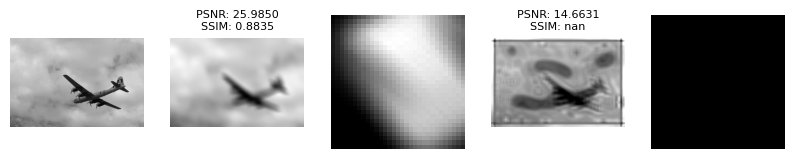

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


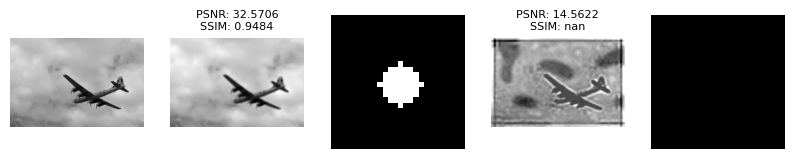

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


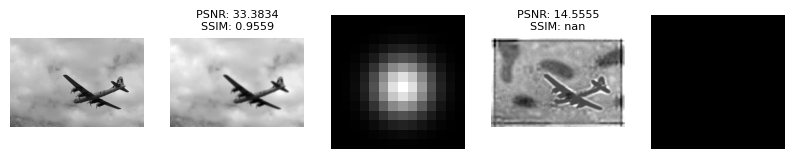

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


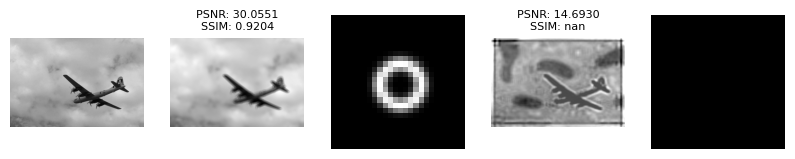

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


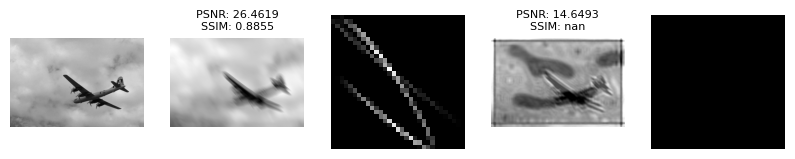

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


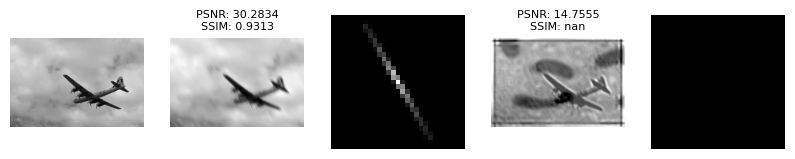

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


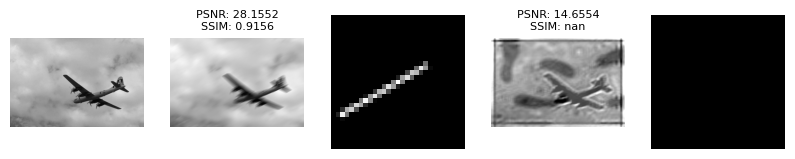

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


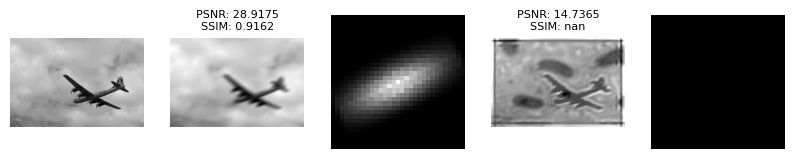

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


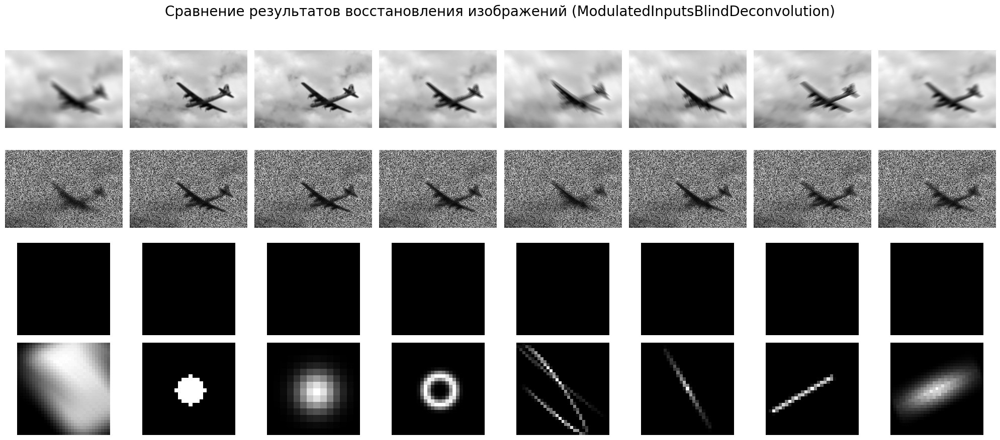

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


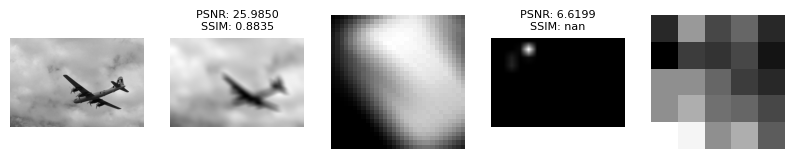

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


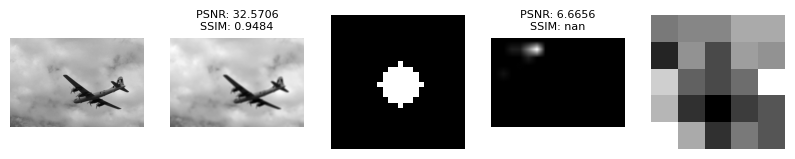

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


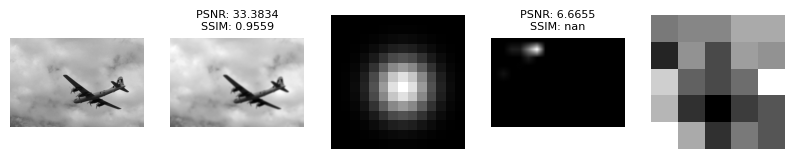

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


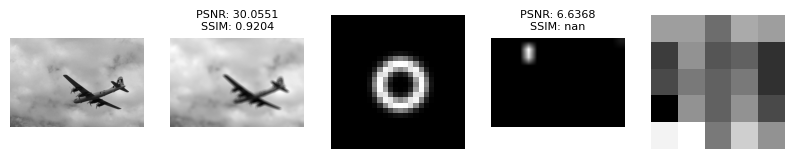

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


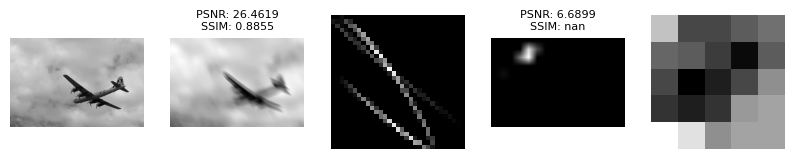

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


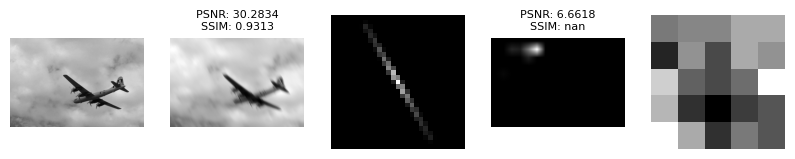

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


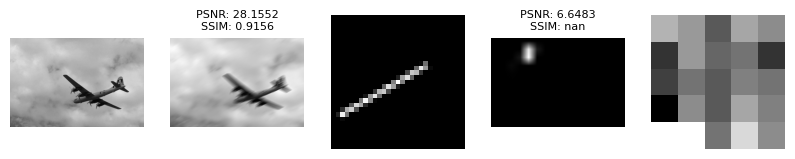

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


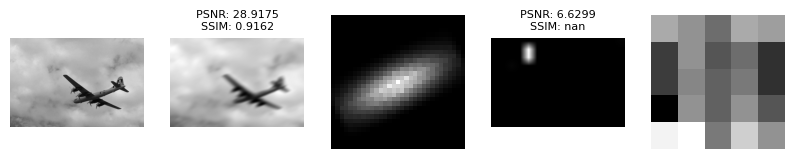

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


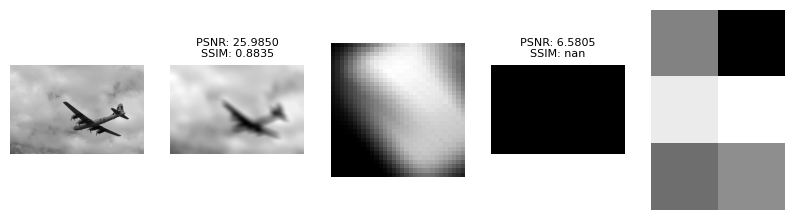

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

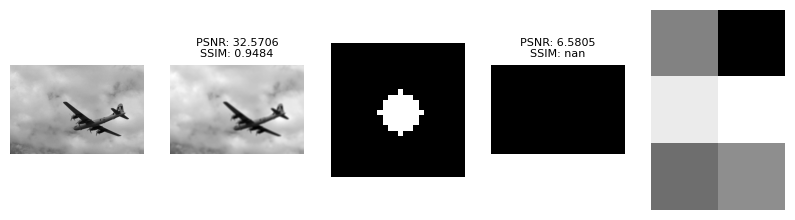

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

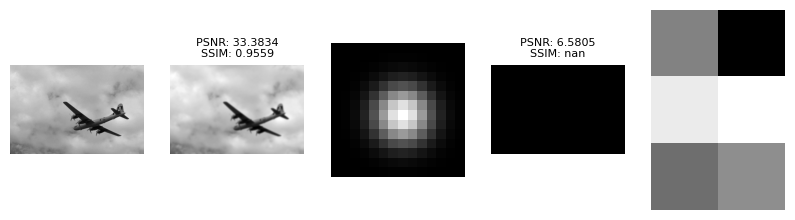

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

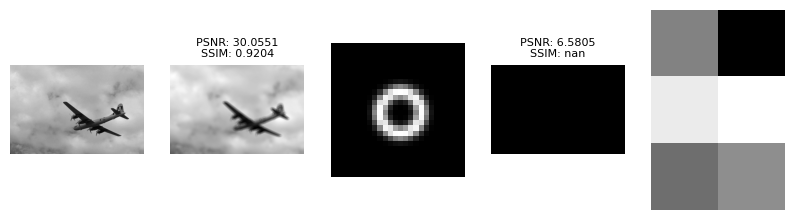

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

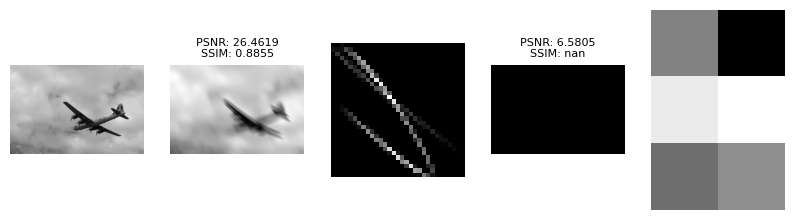

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

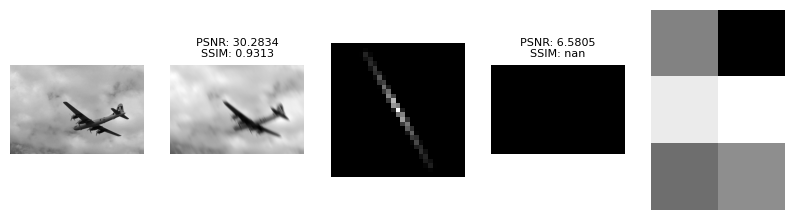

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

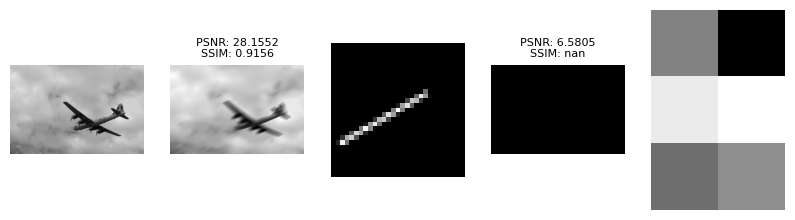

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

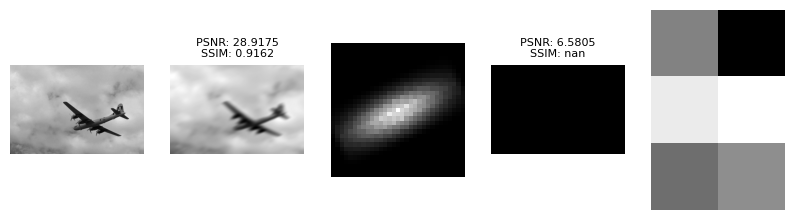

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


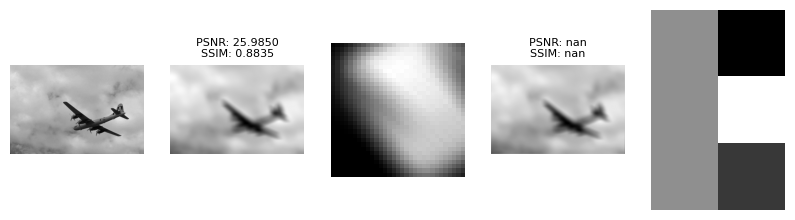

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


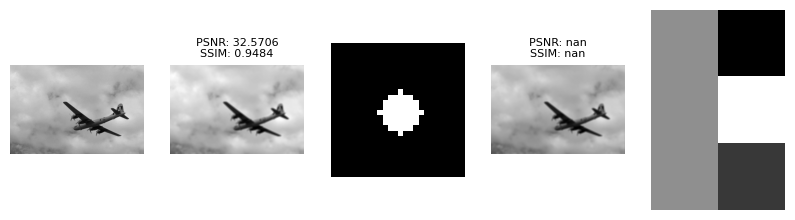

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


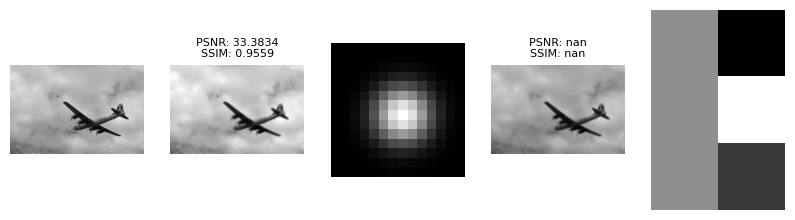

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


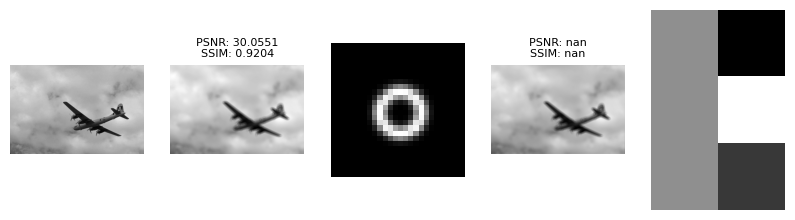

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


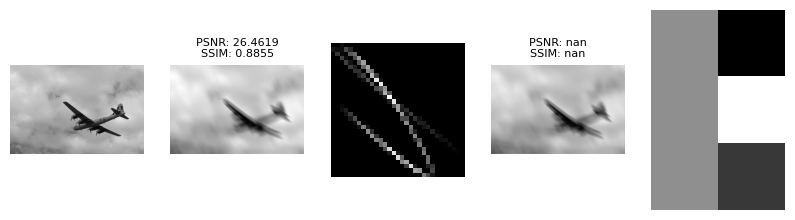

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


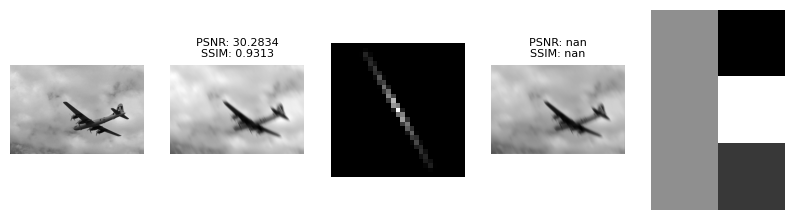

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


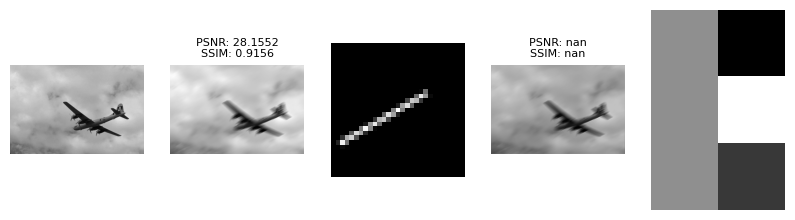

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


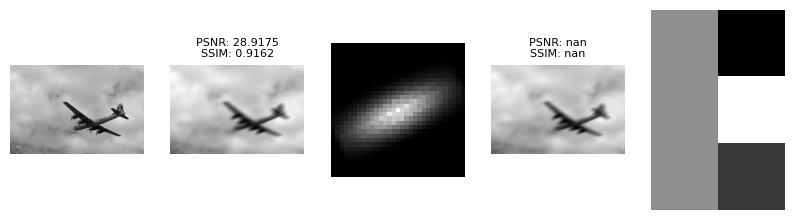

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


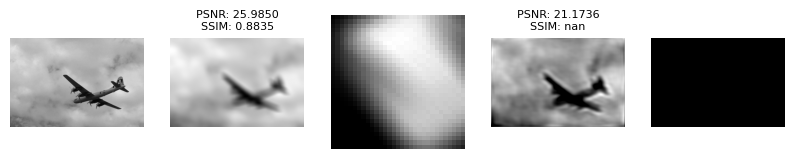

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


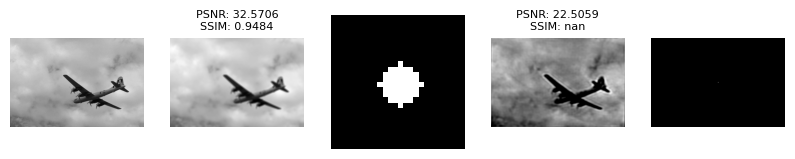

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


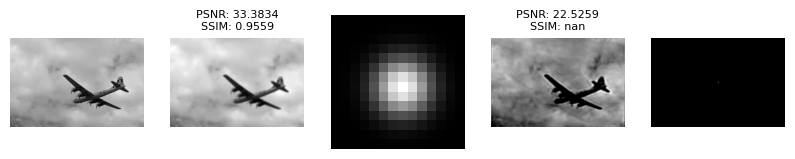

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


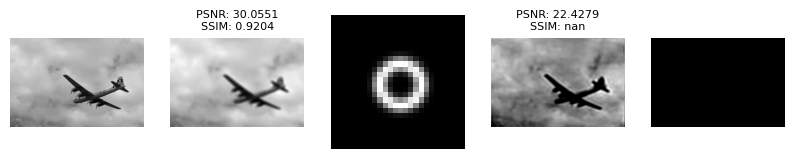

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


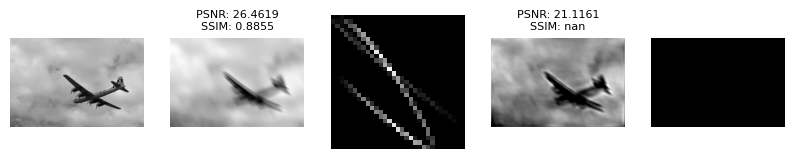

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


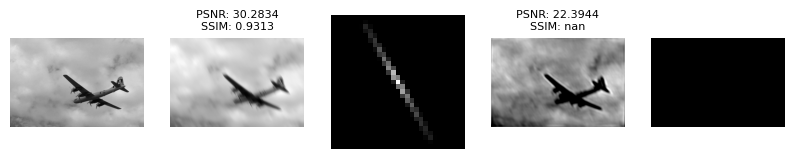

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


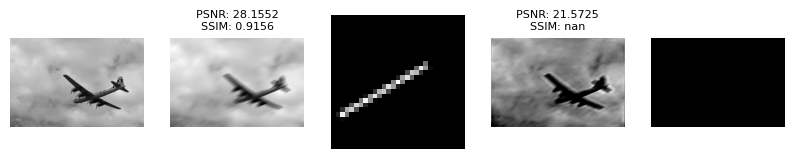

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


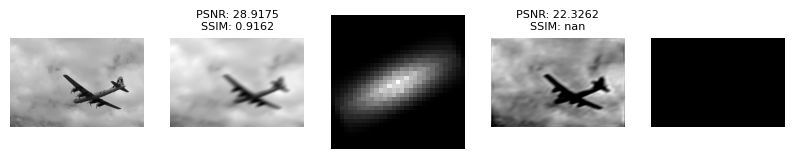

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


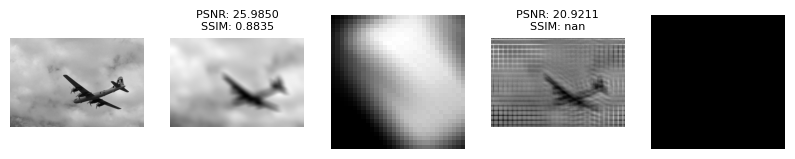

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


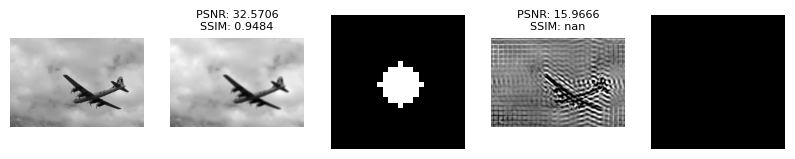

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


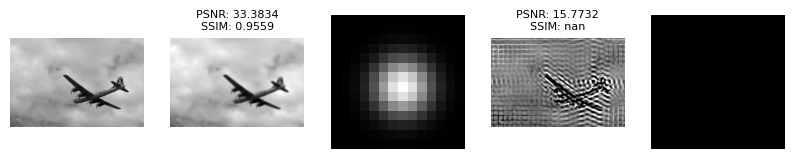

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


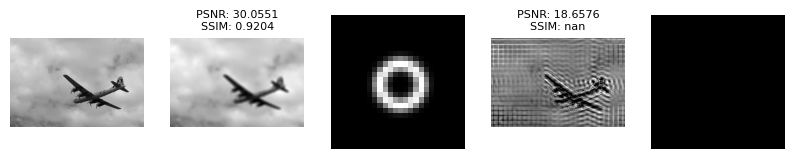

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


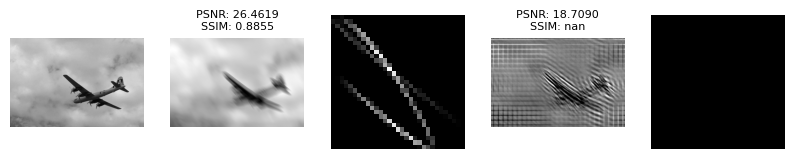

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


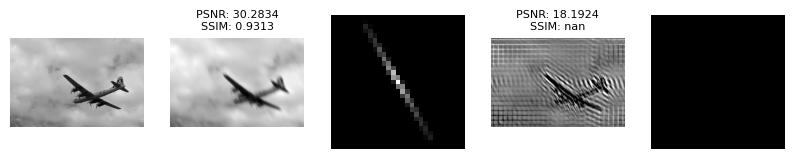

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


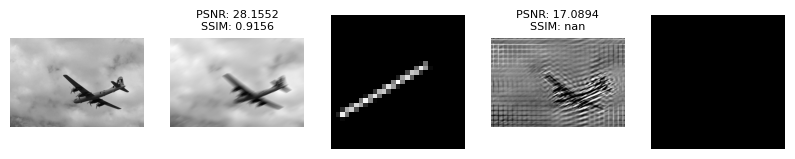

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


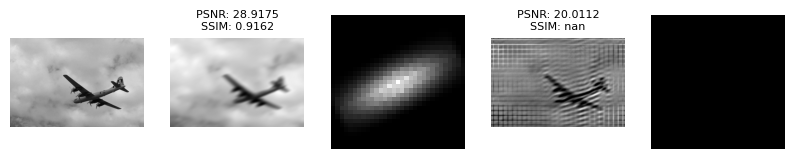

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


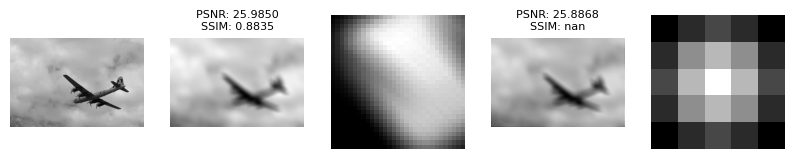

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


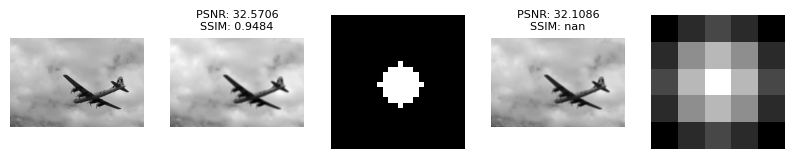

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


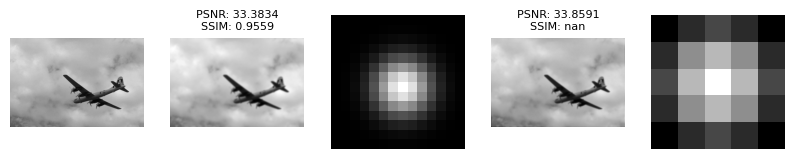

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


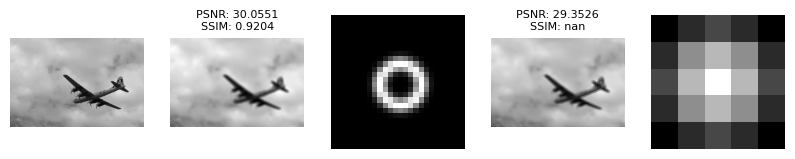

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


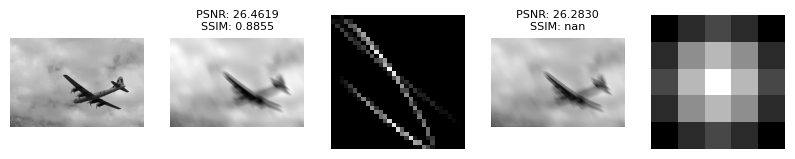

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


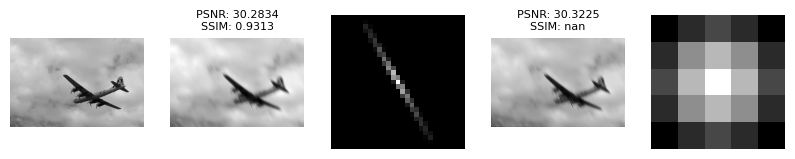

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


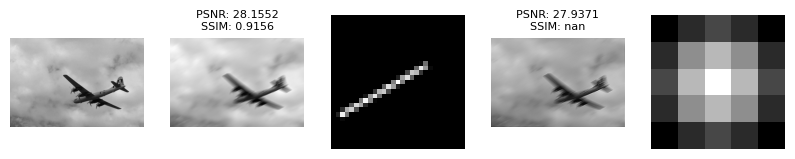

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


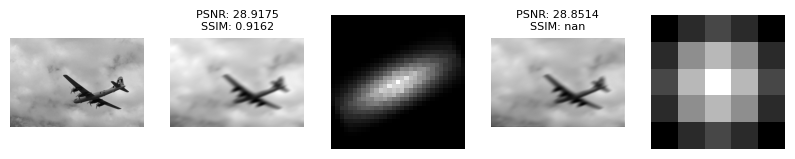

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


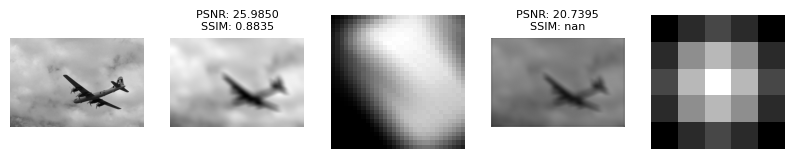

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


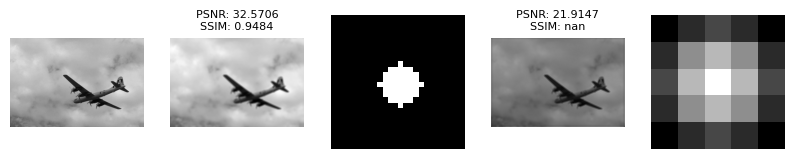

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


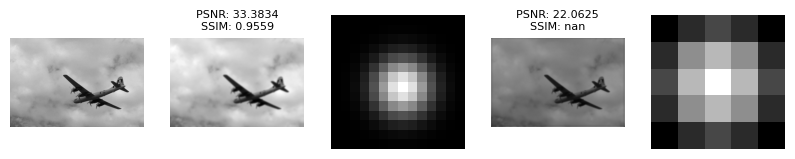

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


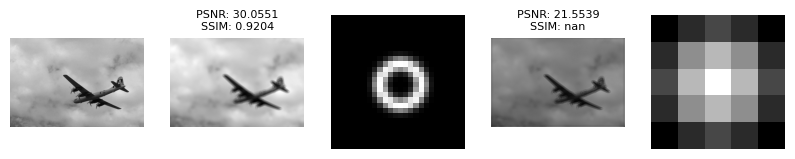

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


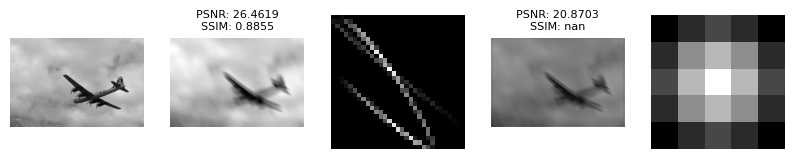

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


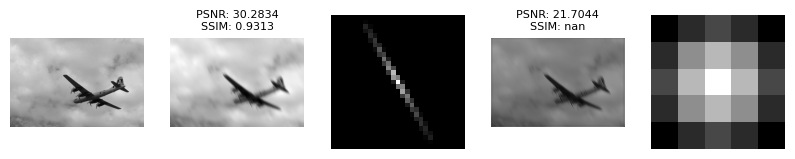

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


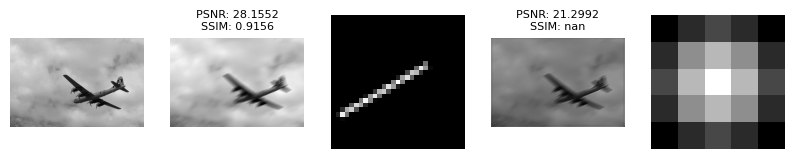

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


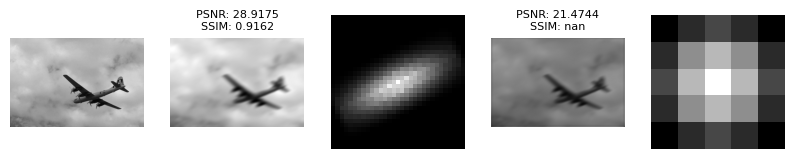

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


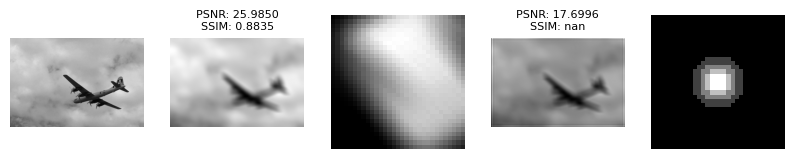

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


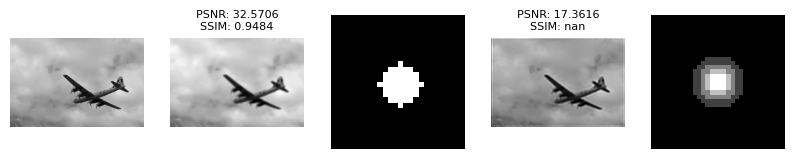

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


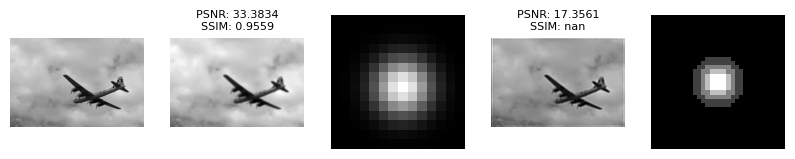

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


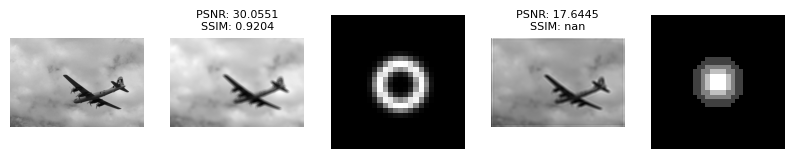

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


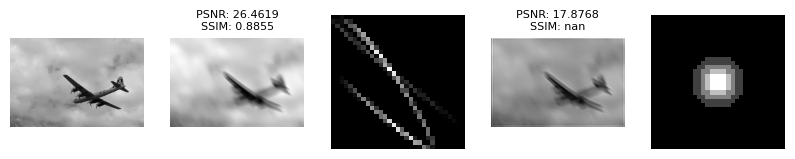

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


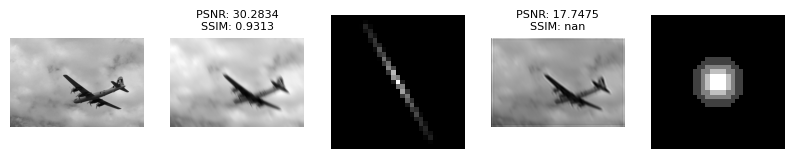

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


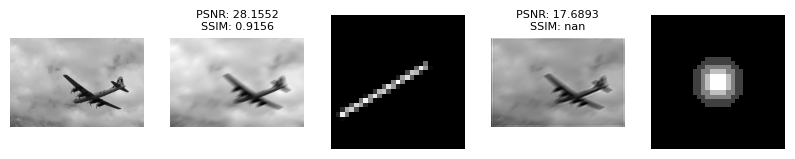

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


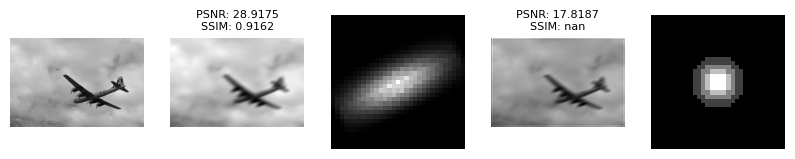

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


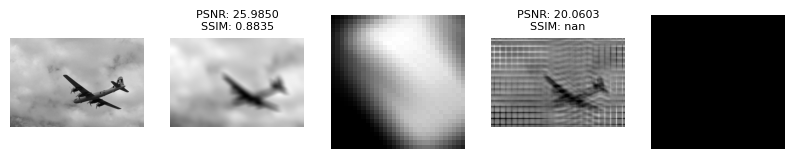

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


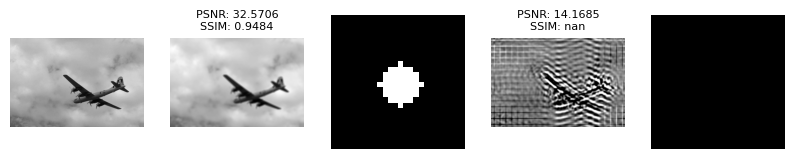

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


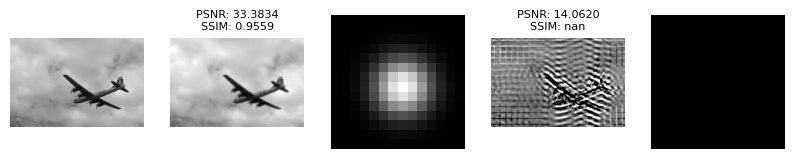

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


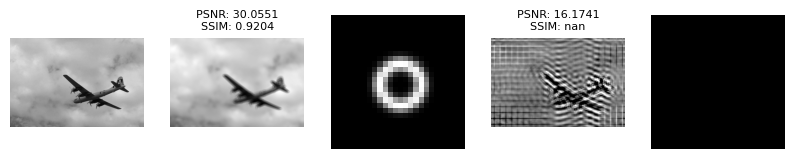

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


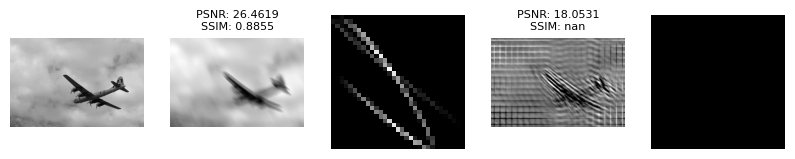

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


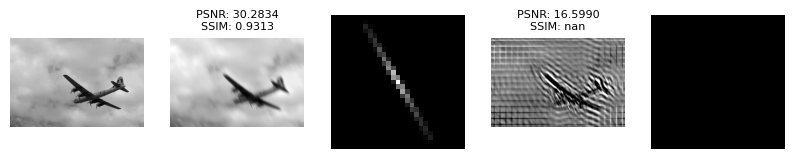

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


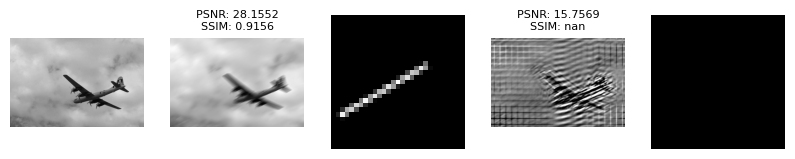

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


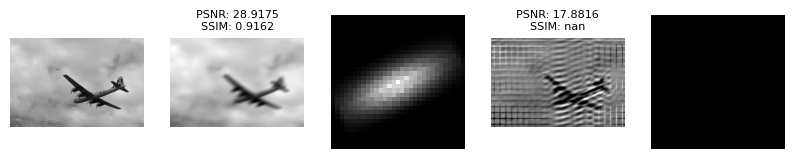

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "drawing.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


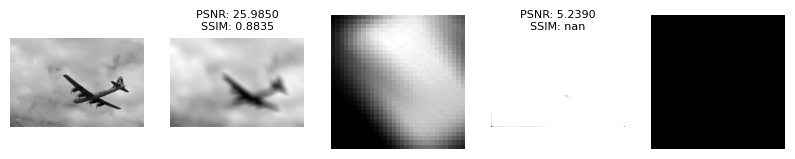

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


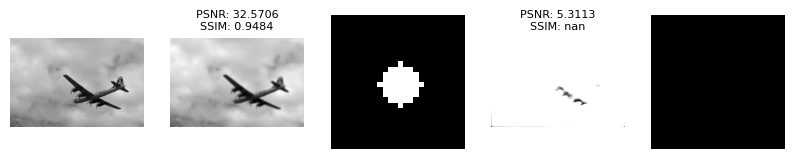

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


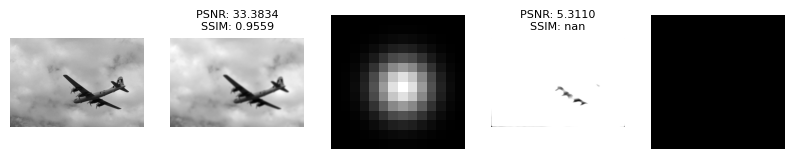

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


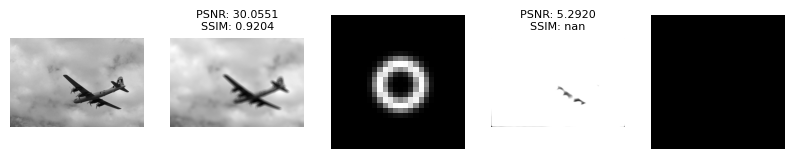

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


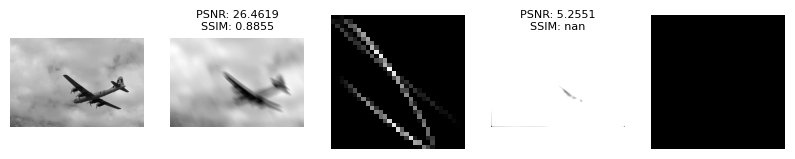

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


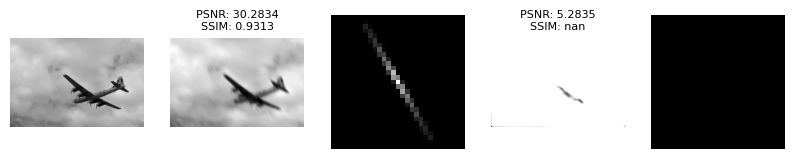

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


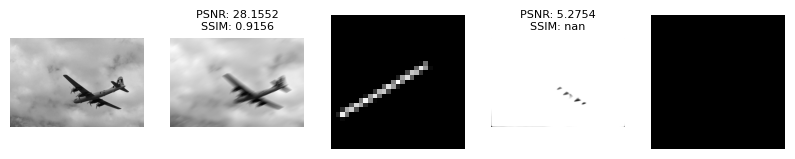

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


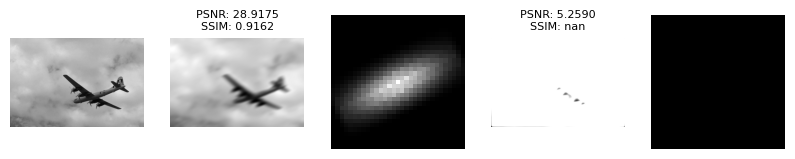

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 6. house.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


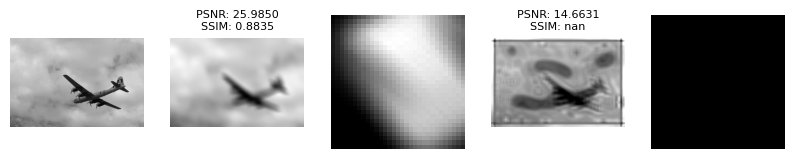

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


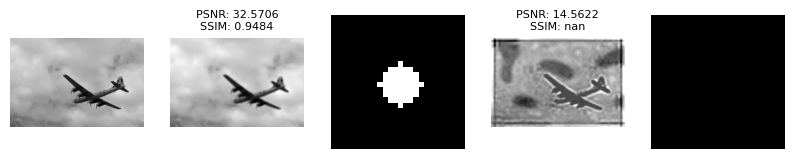

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


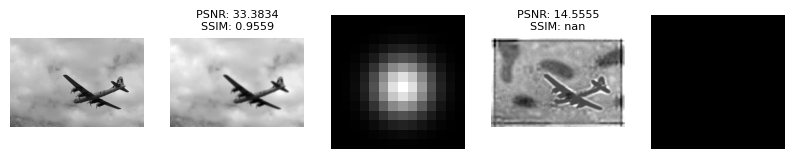

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


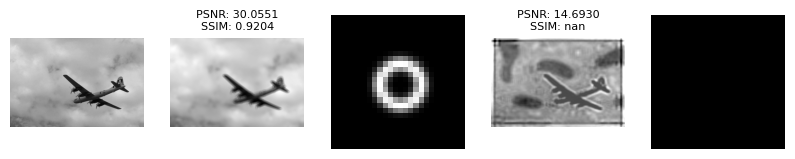

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


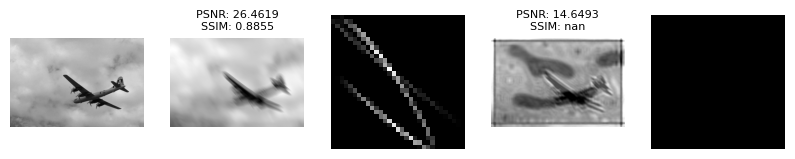

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


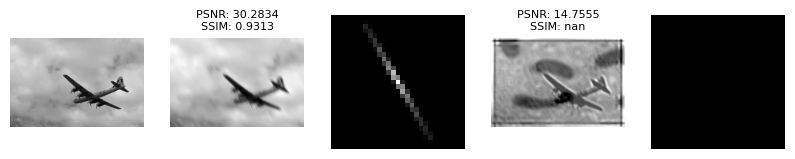

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


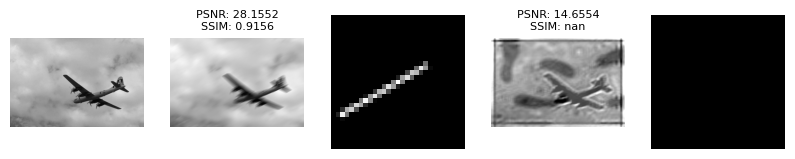

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


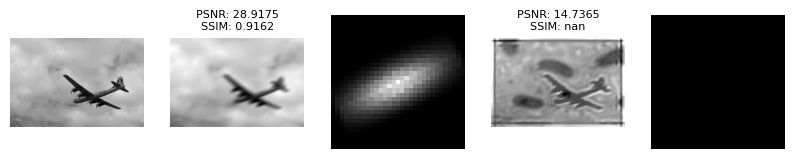

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


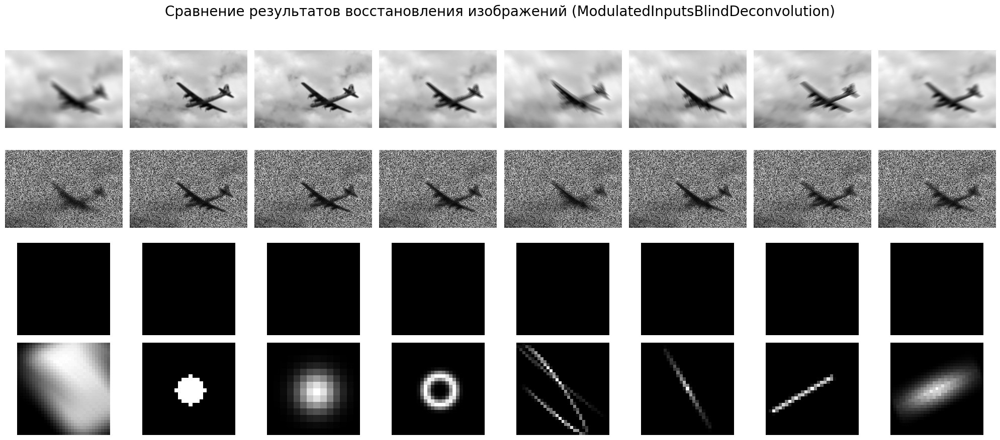

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


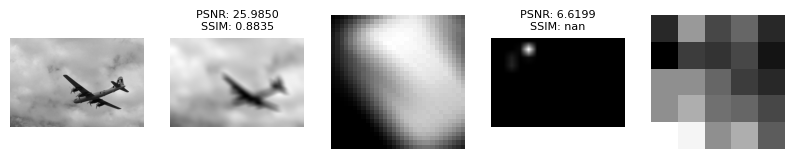

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


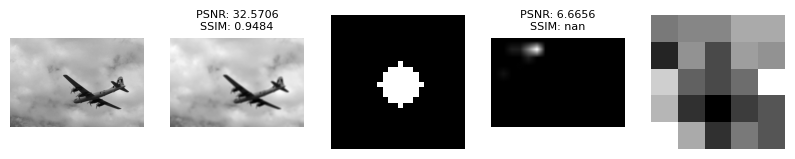

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


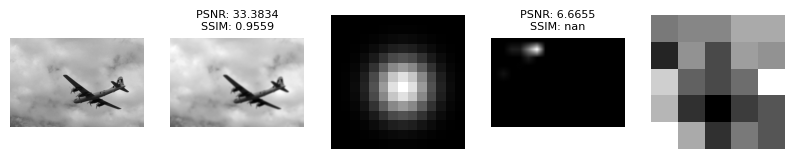

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


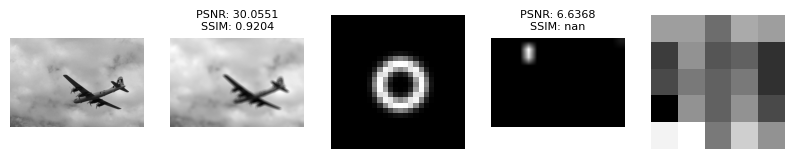

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


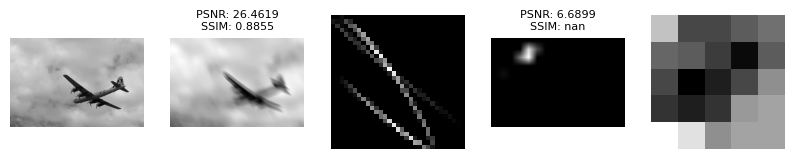

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


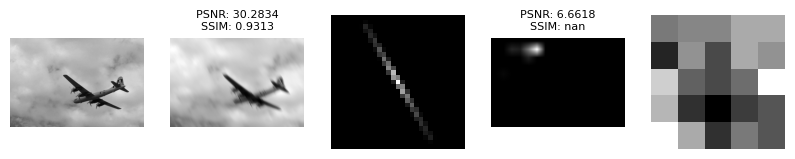

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


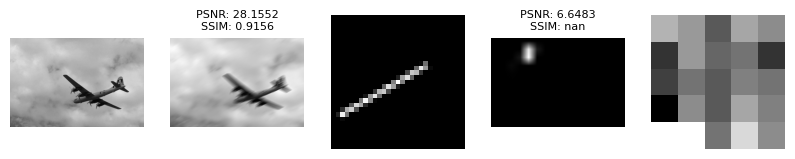

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


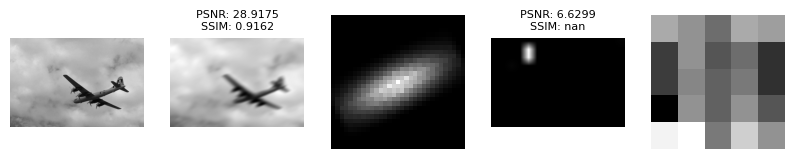

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


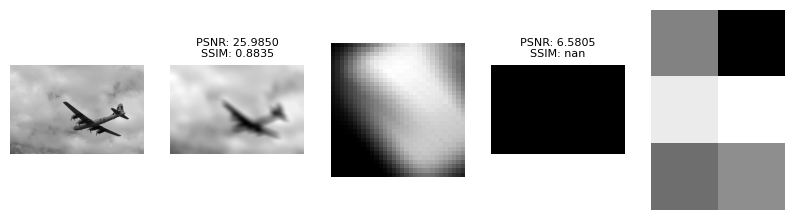

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

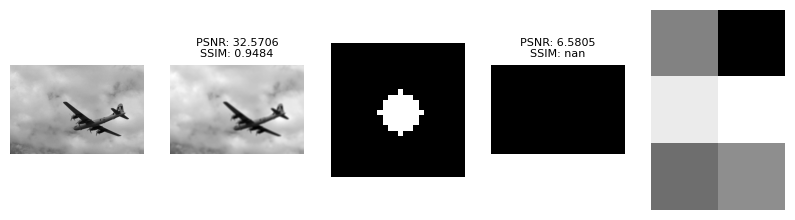

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

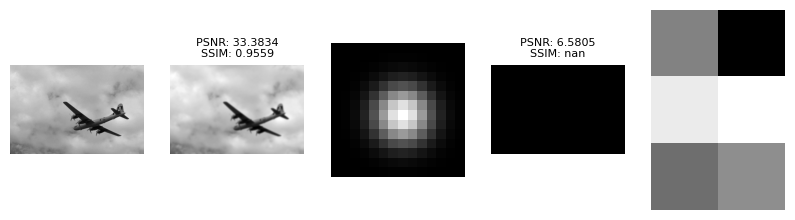

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

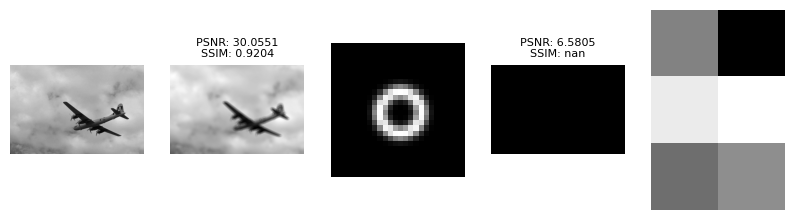

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

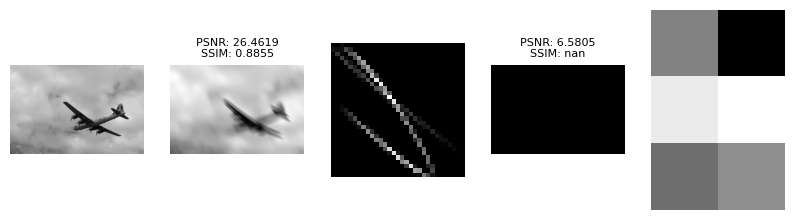

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

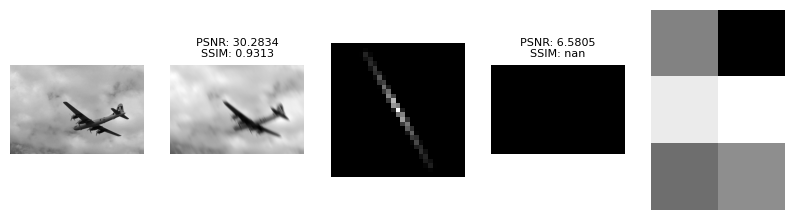

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

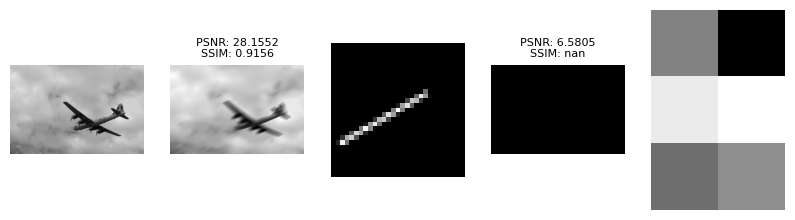

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

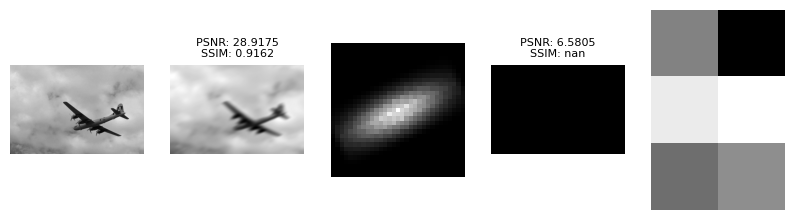

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


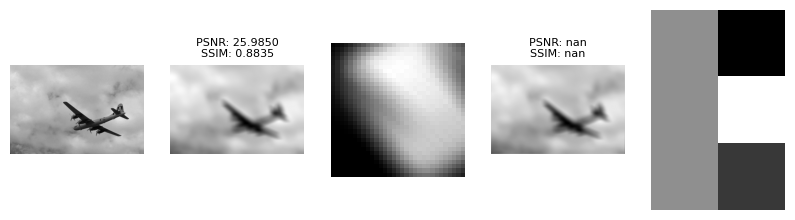

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


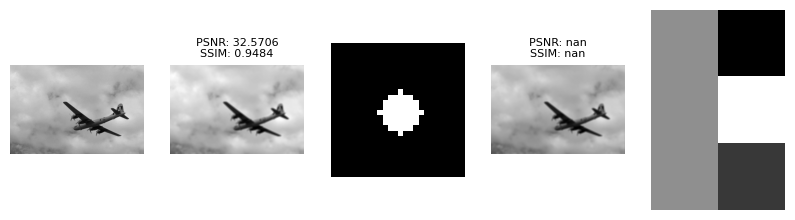

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


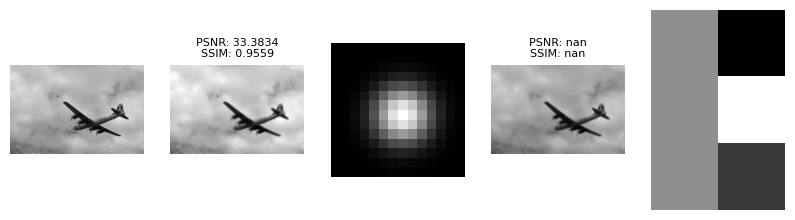

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


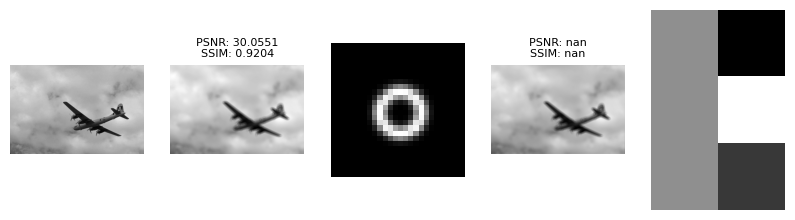

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


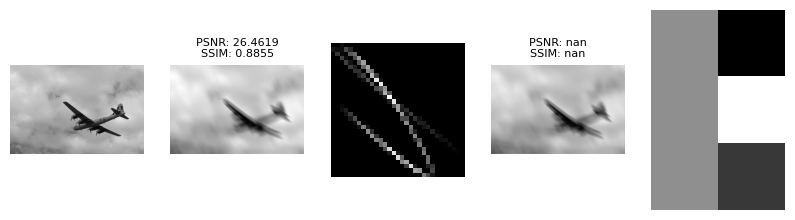

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


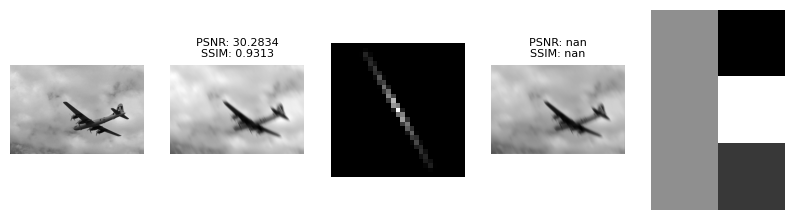

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


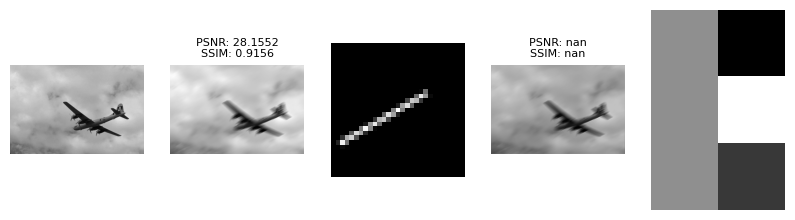

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


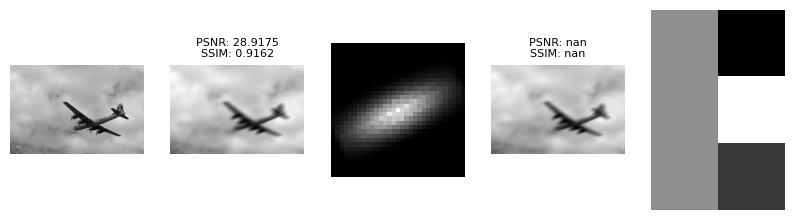

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


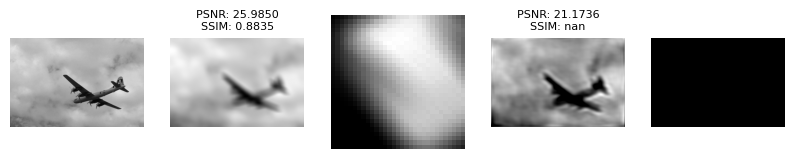

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


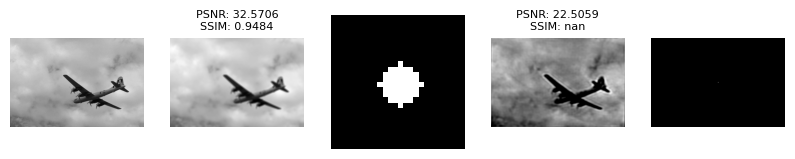

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


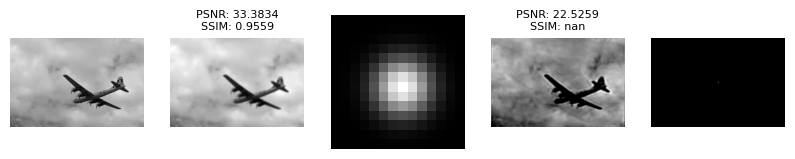

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


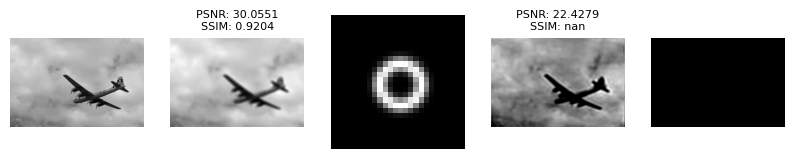

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


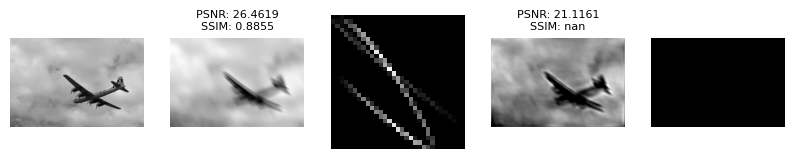

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


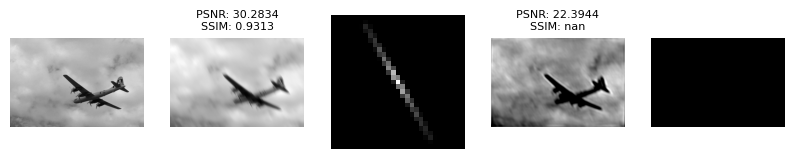

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


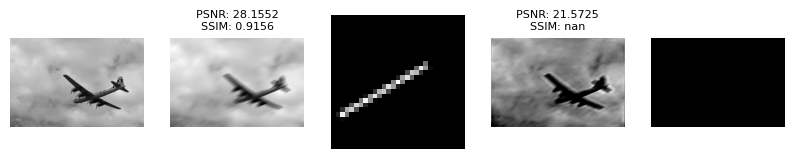

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


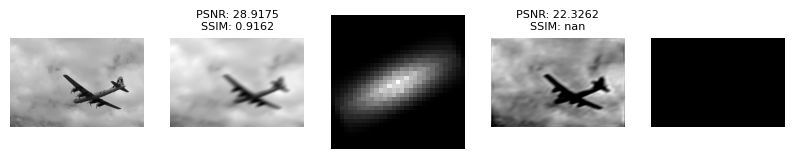

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


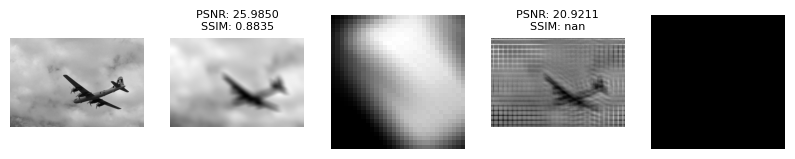

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


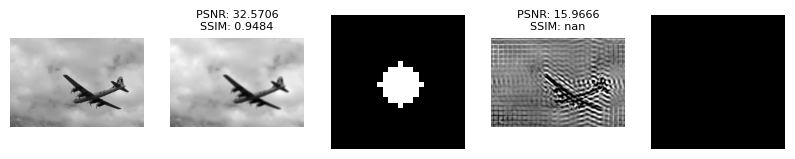

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


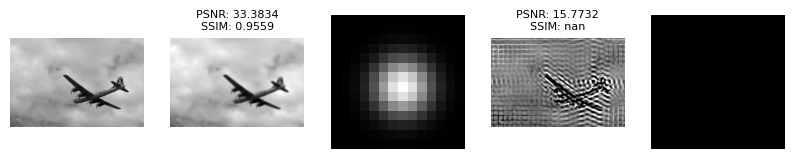

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


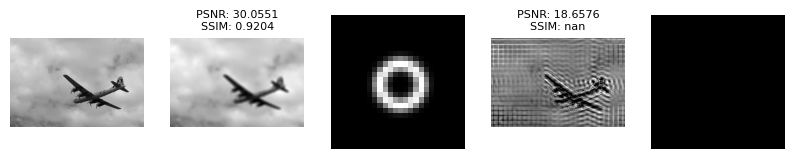

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


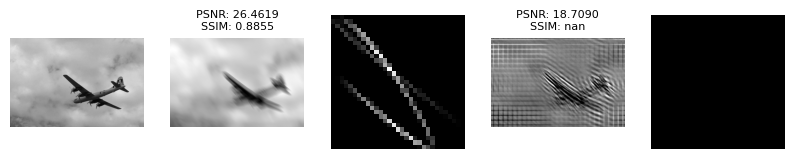

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


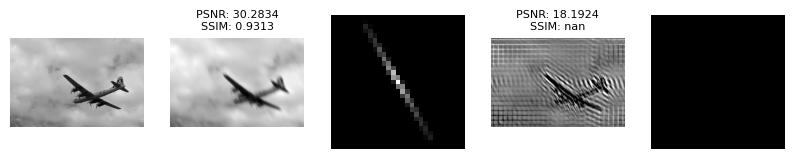

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


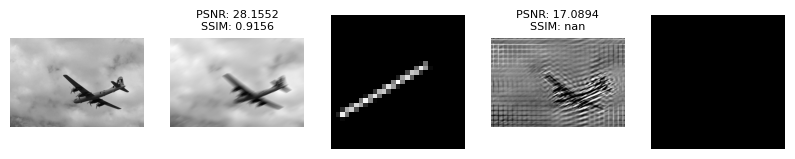

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


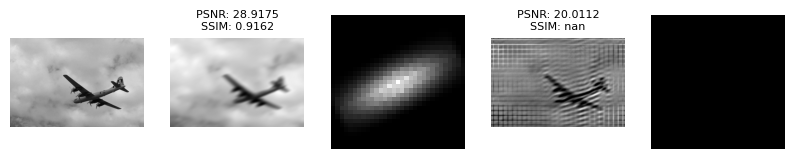

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


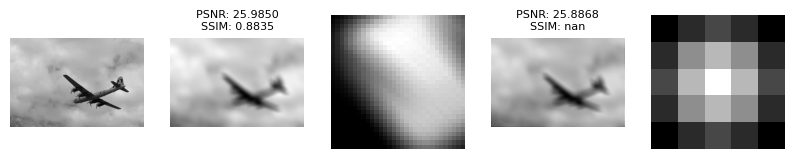

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


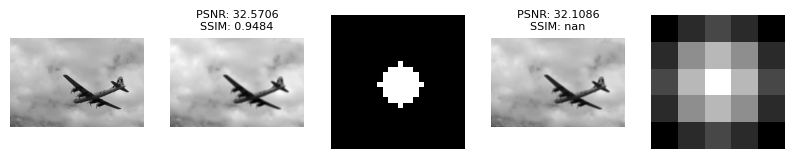

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


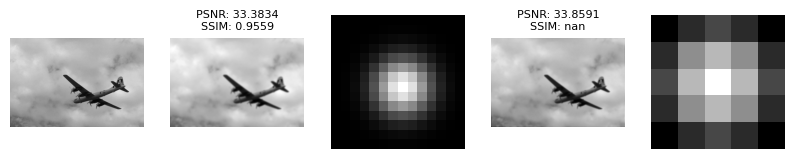

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


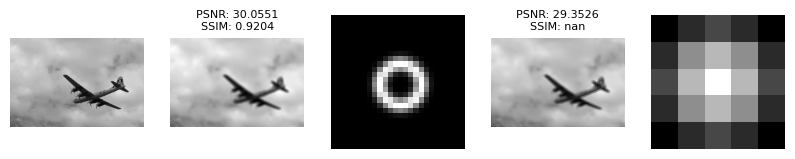

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


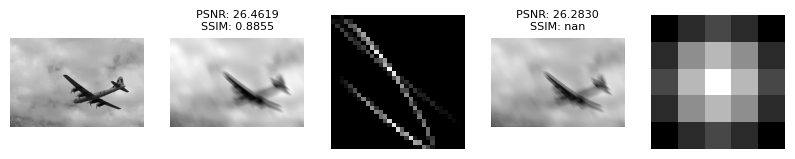

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


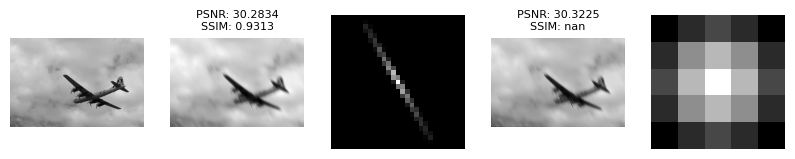

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


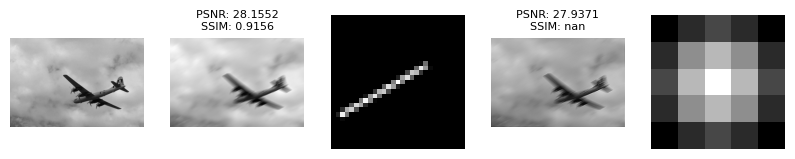

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


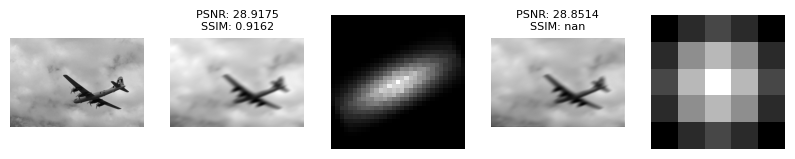

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


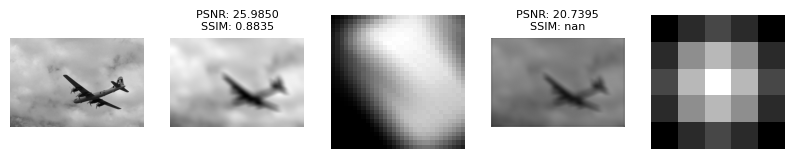

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


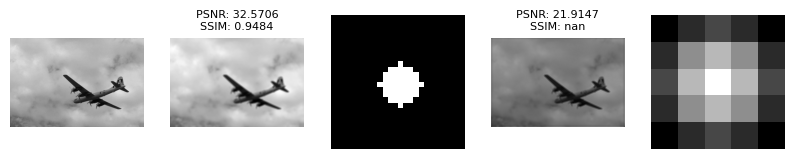

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


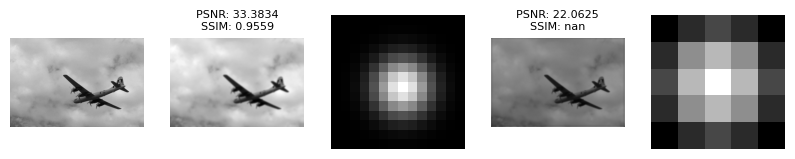

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


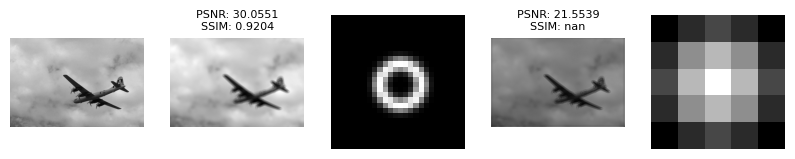

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


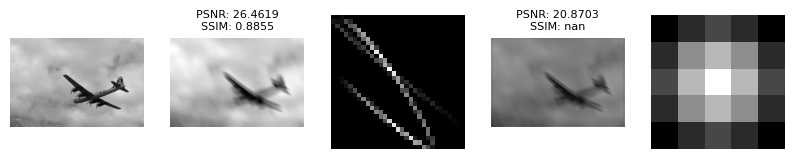

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


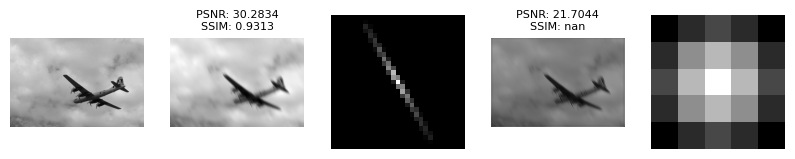

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


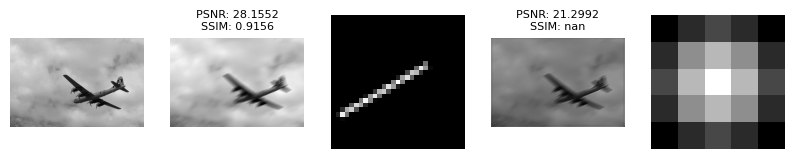

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


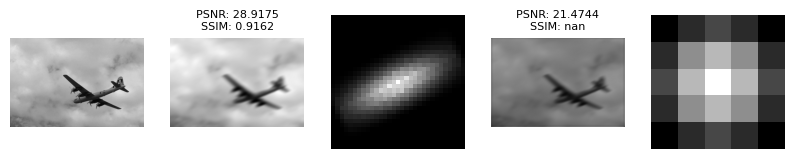

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


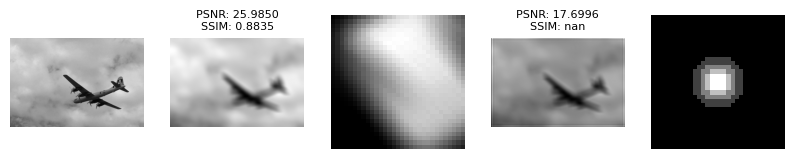

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


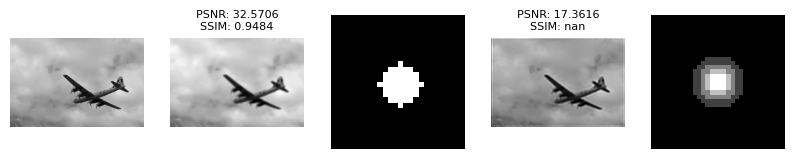

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


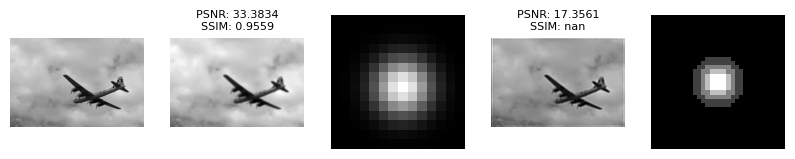

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


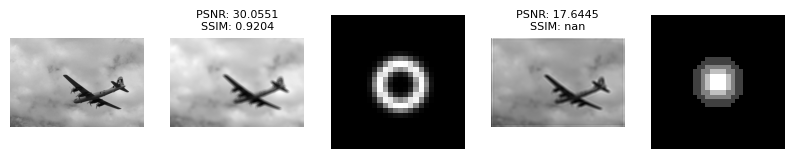

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


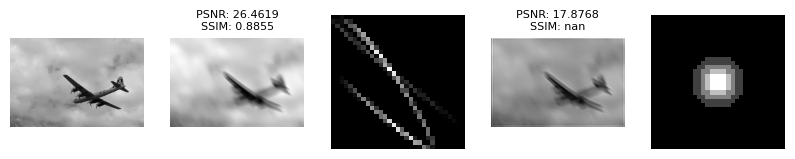

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


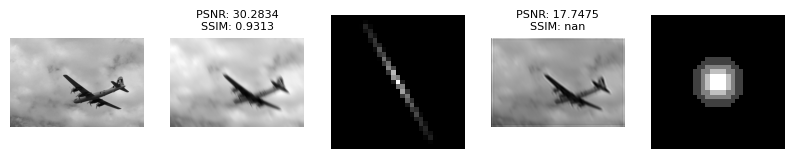

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


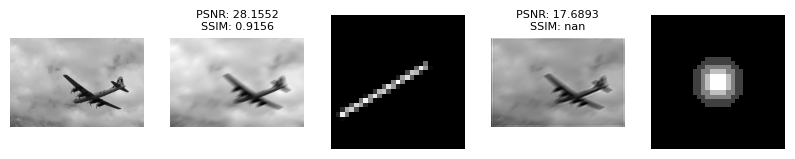

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


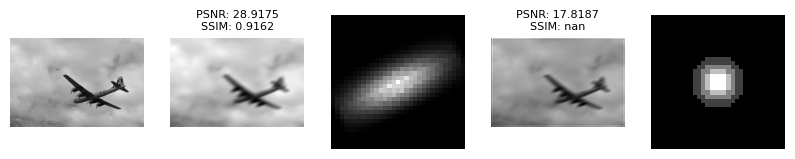

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


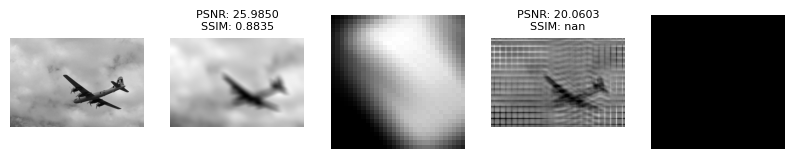

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


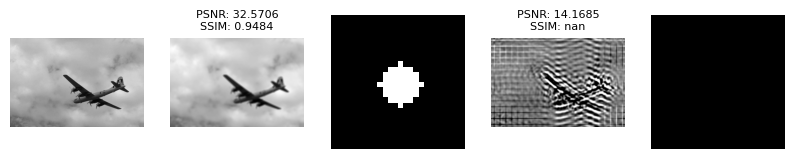

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


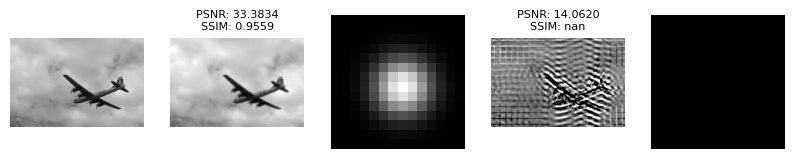

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


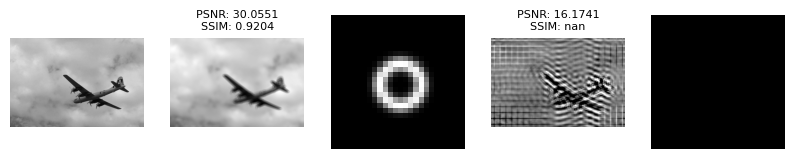

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


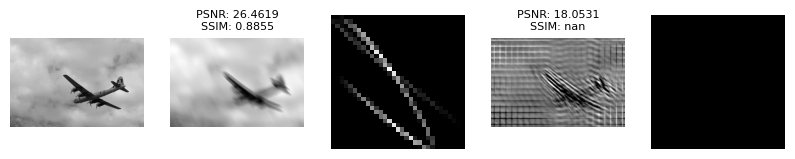

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


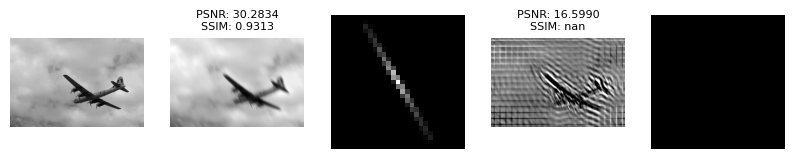

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


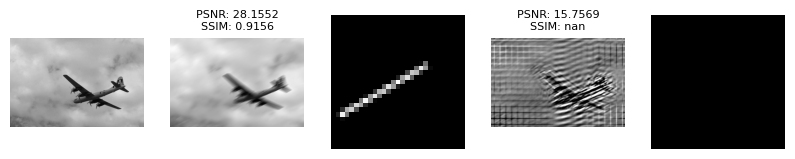

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


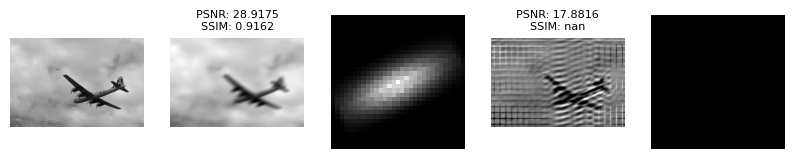

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "house.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


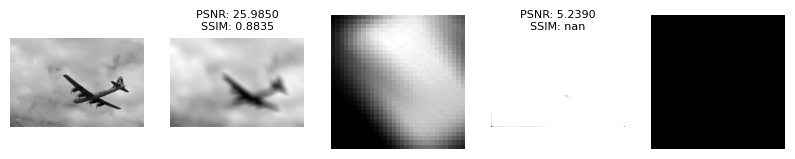

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


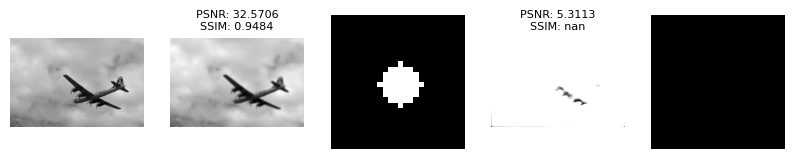

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


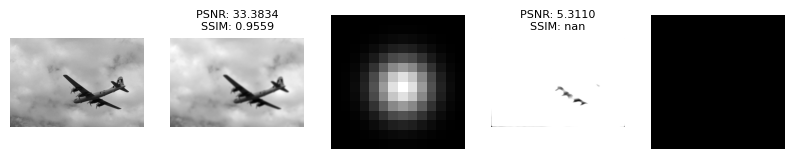

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


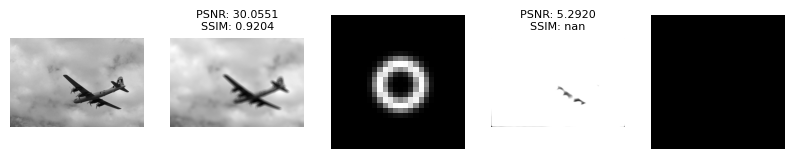

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


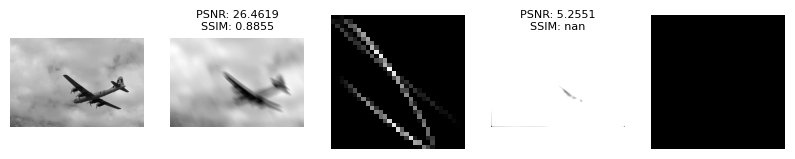

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


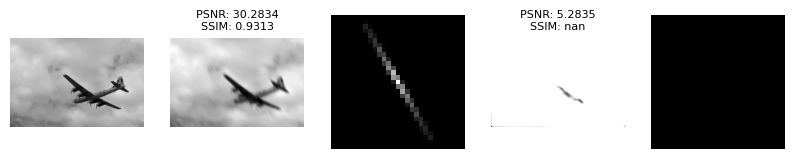

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


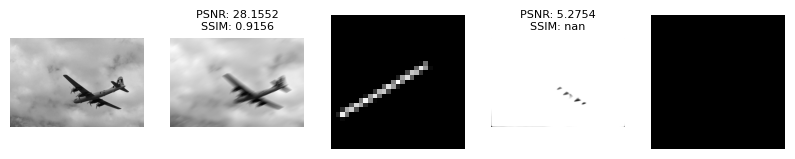

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


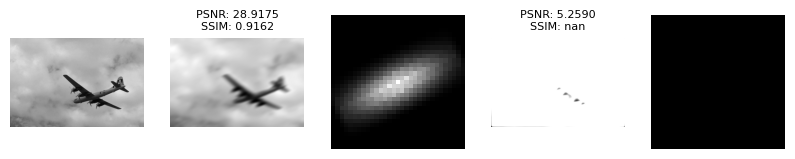

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 7. lenna.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


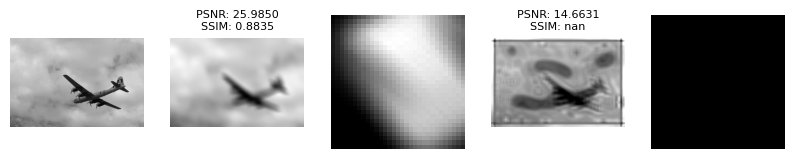

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


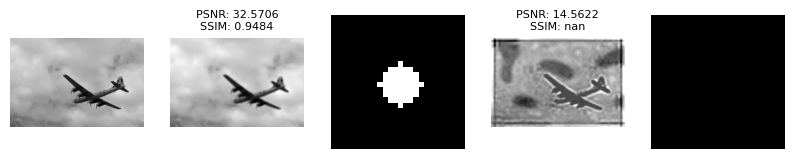

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


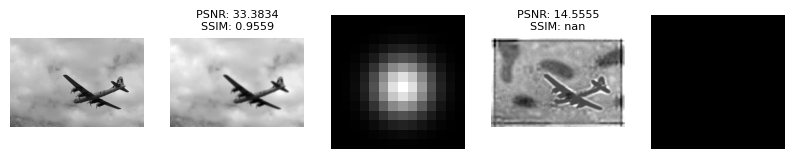

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


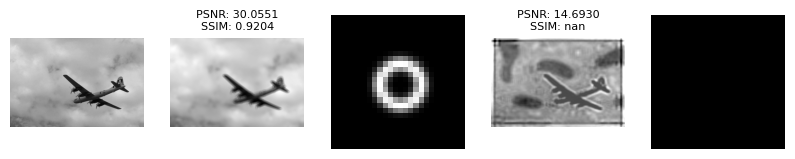

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


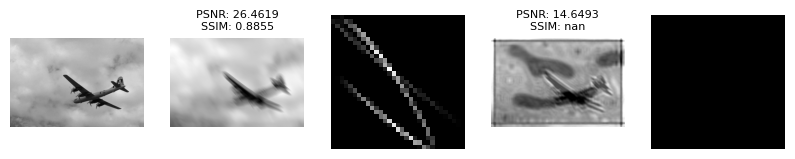

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


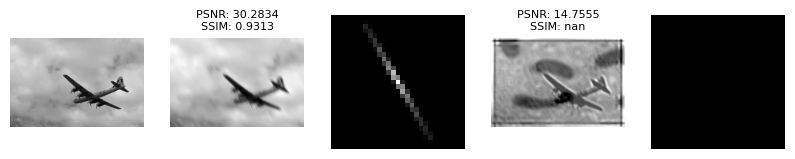

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


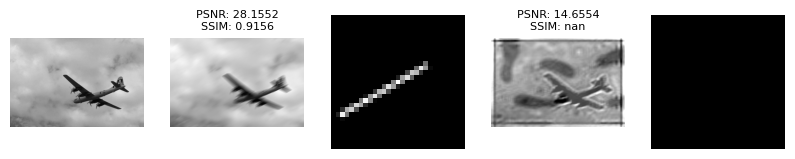

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


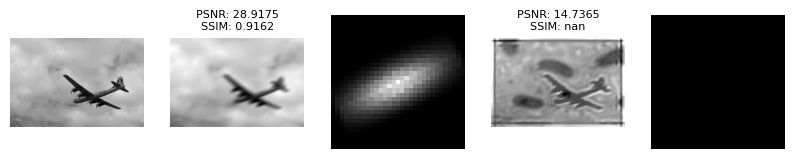

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


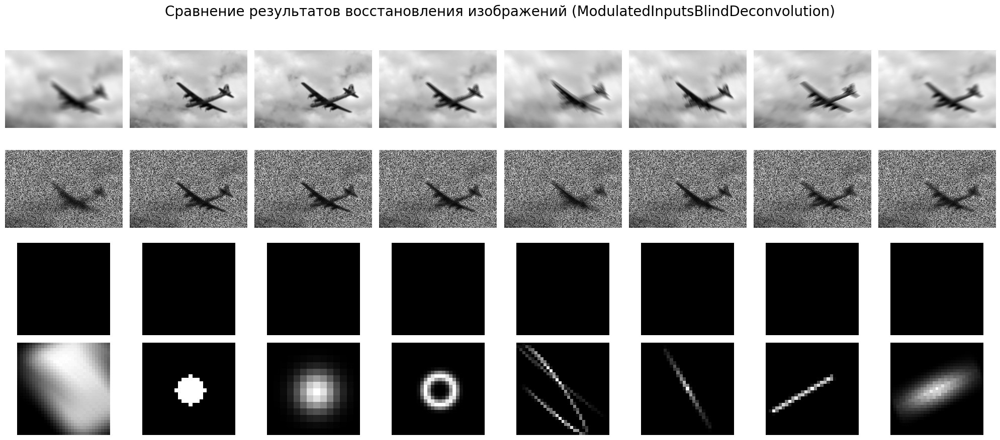

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


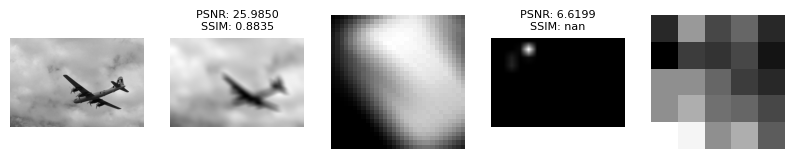

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


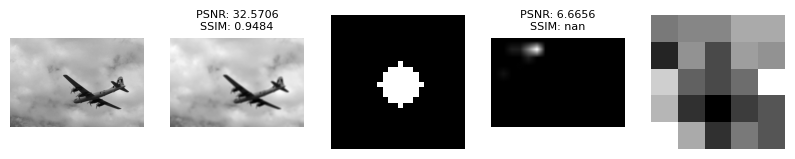

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


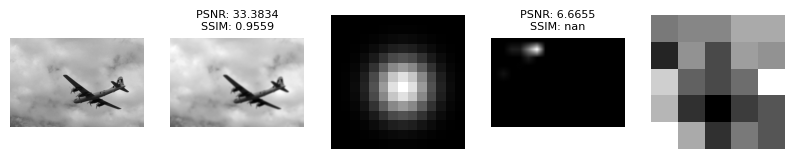

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


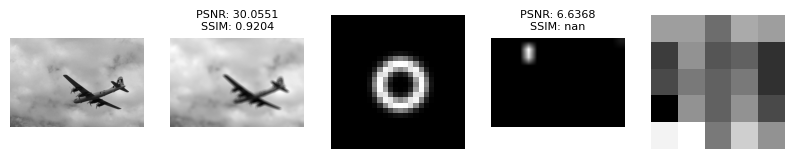

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


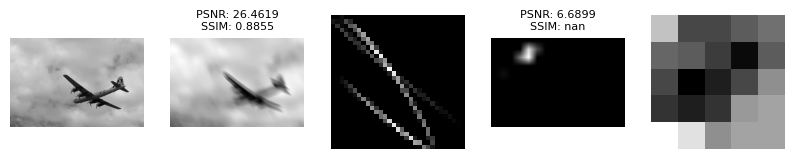

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


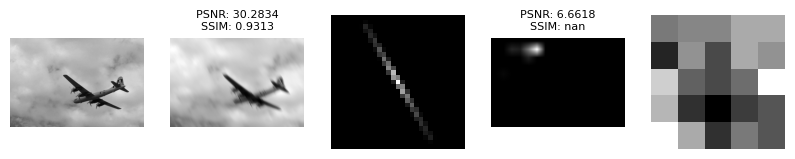

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


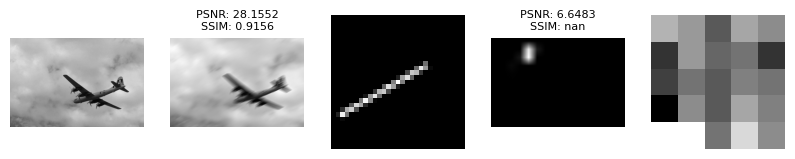

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


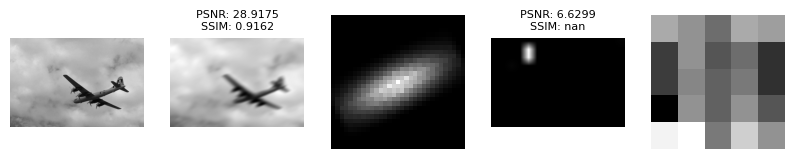

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


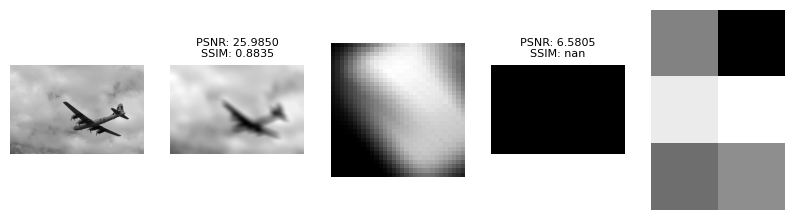

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

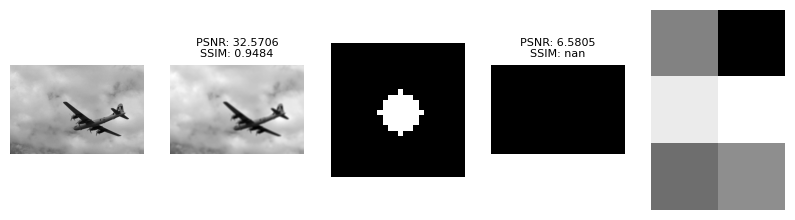

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

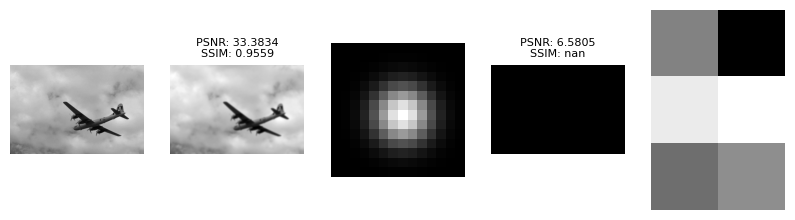

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

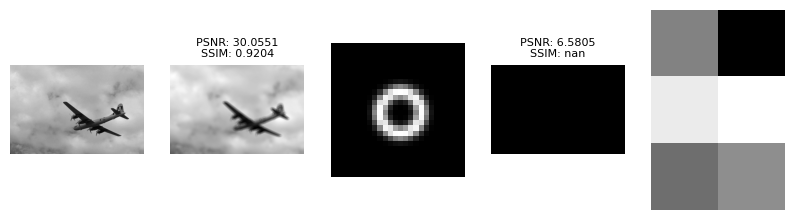

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

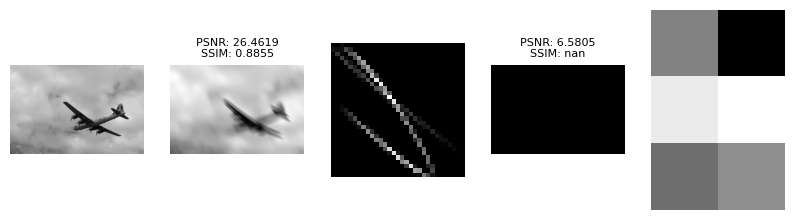

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

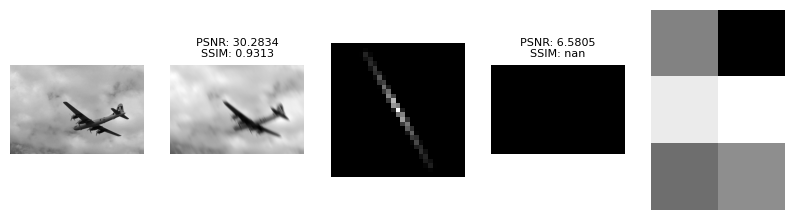

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

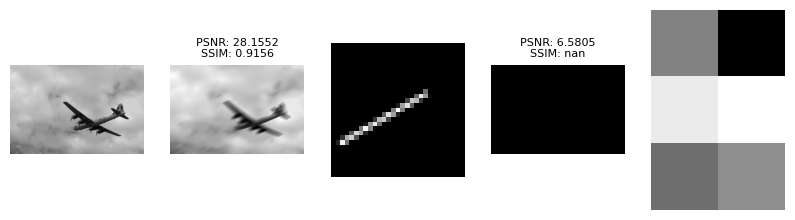

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

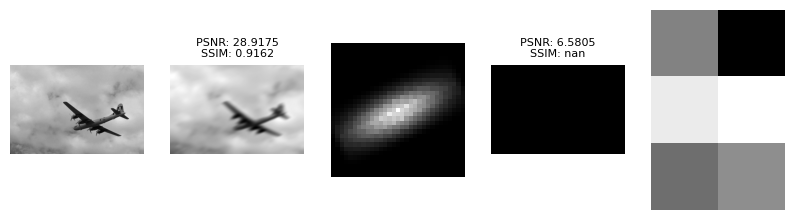

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


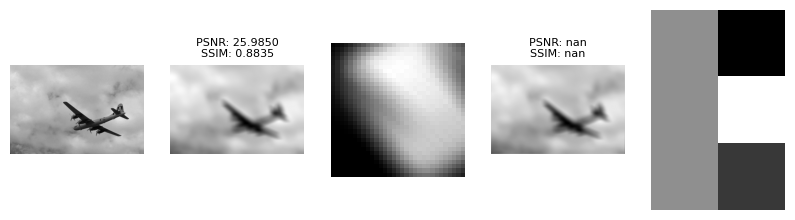

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


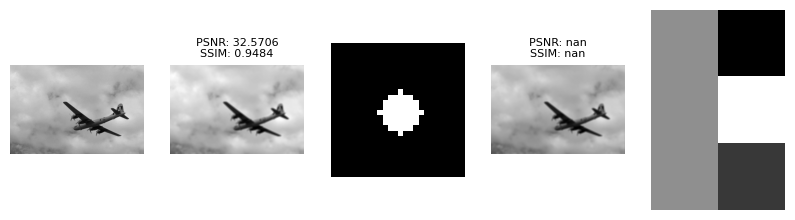

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


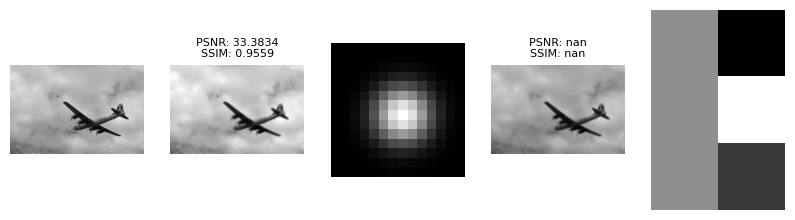

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


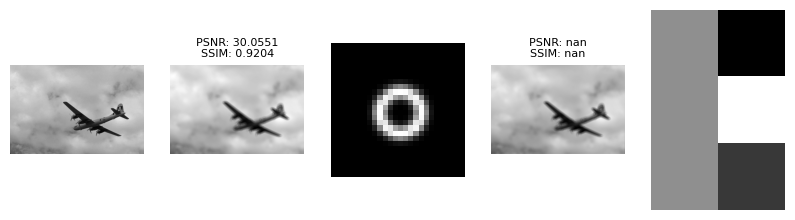

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


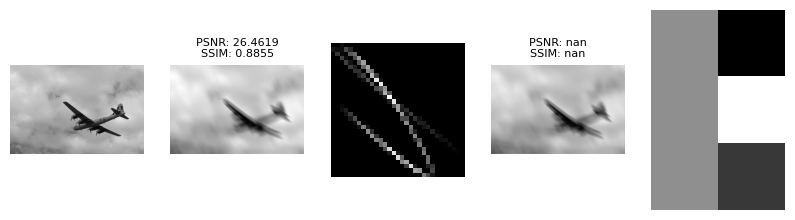

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


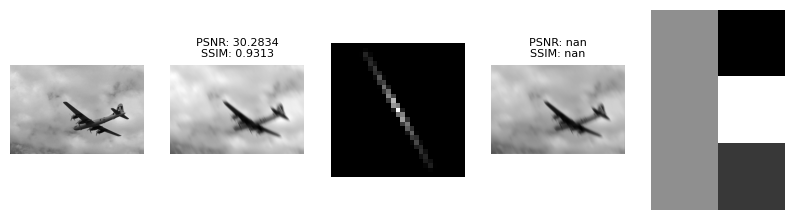

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


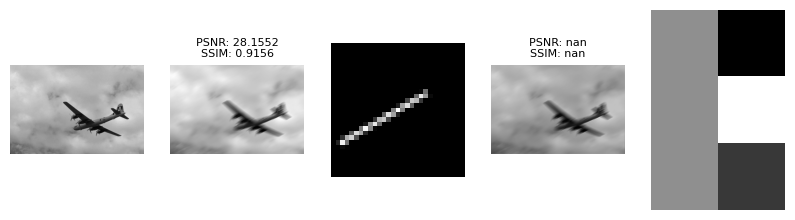

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


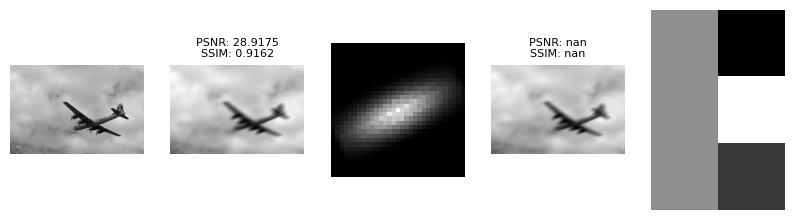

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


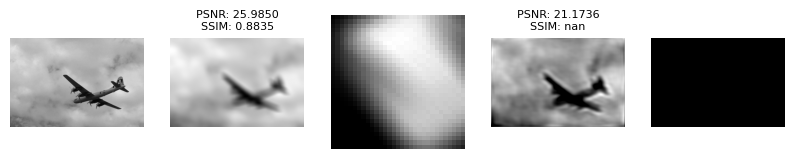

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


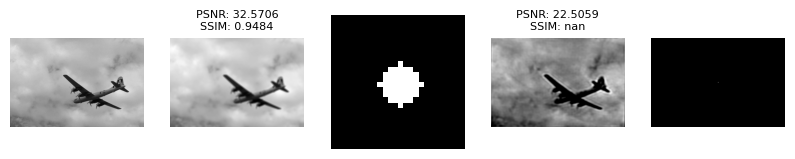

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


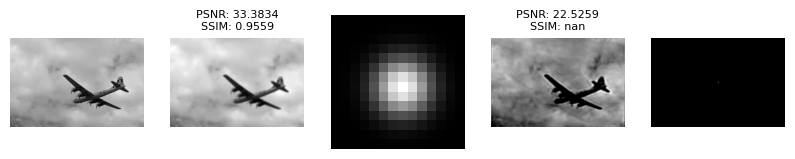

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


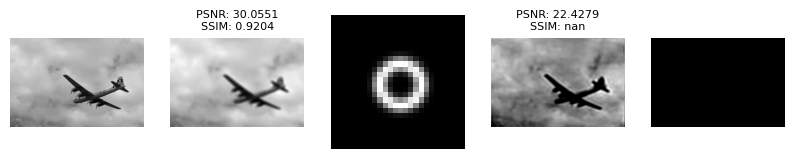

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


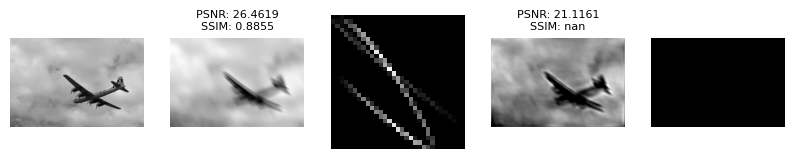

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


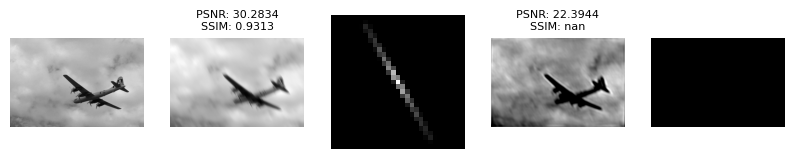

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


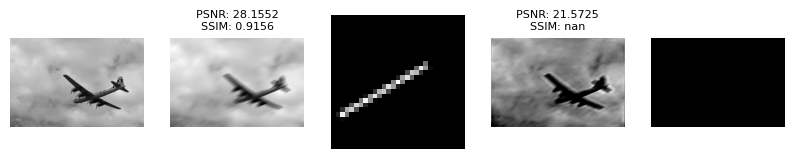

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


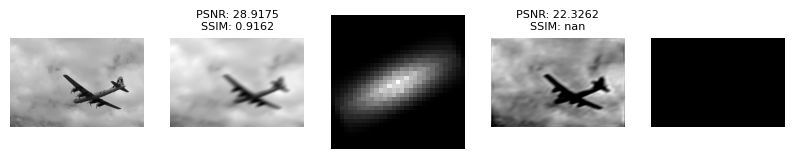

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


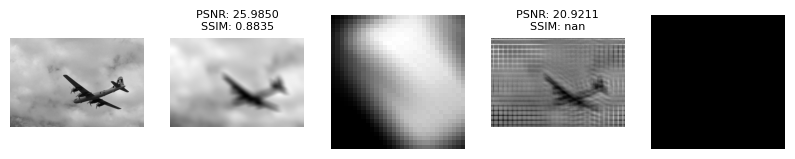

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


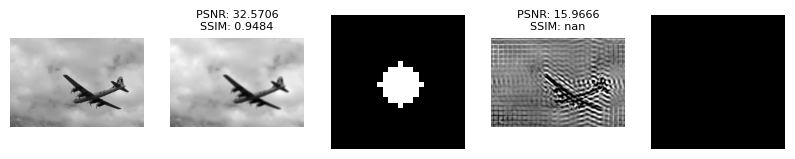

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


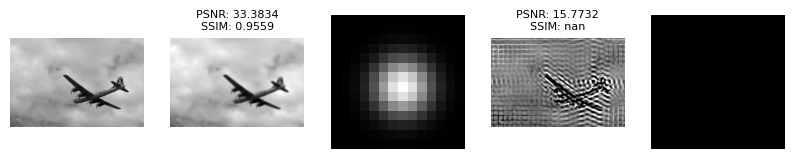

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


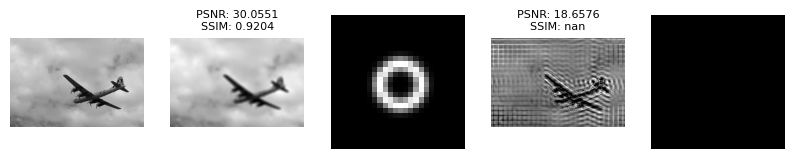

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


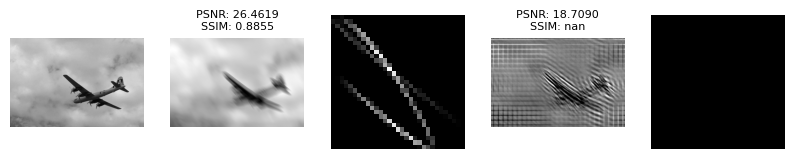

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


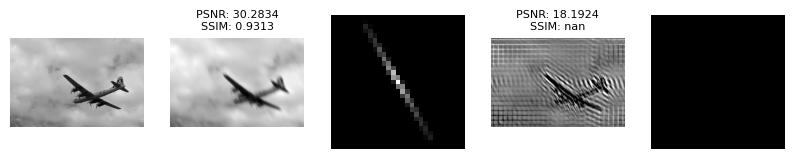

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


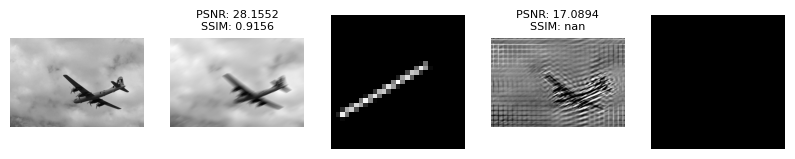

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


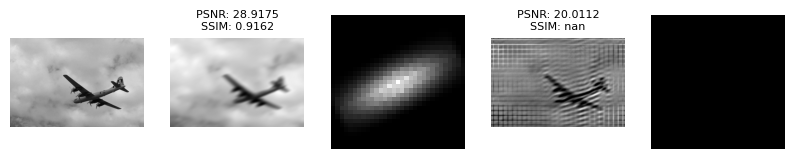

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


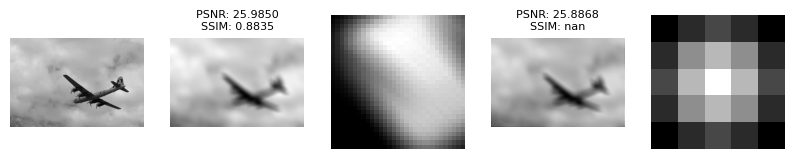

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


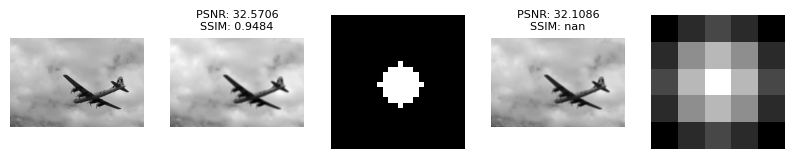

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


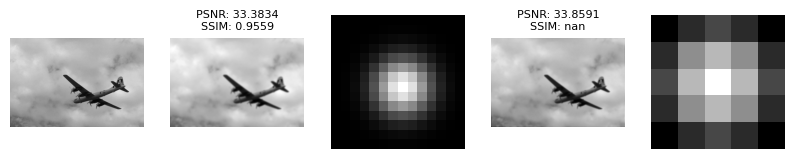

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


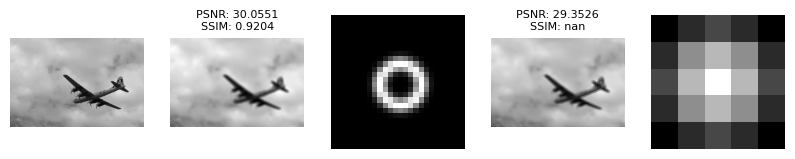

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


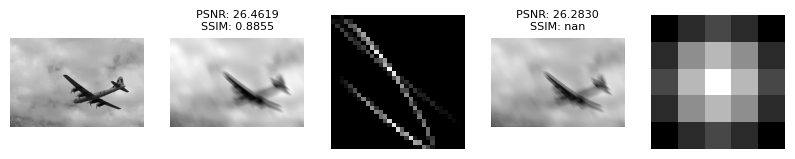

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


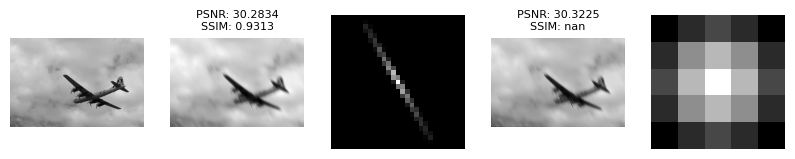

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


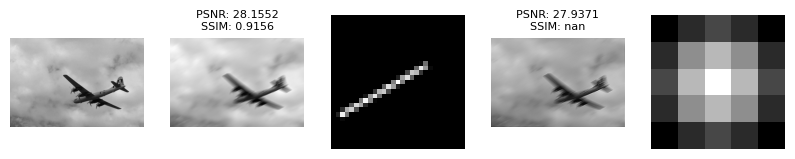

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


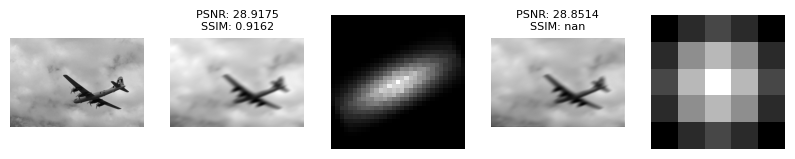

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


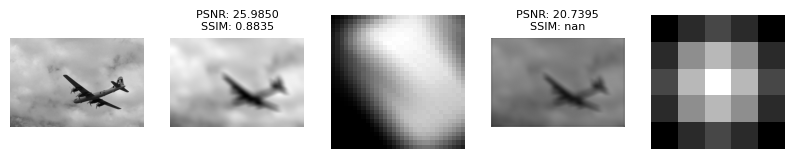

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


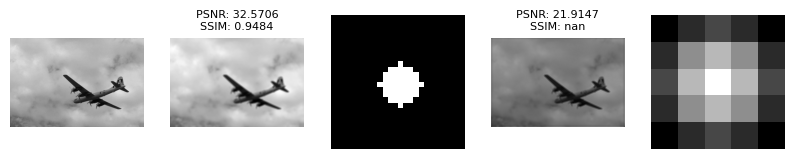

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


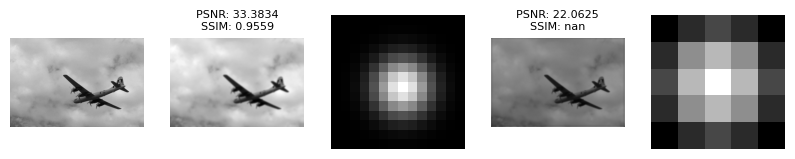

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


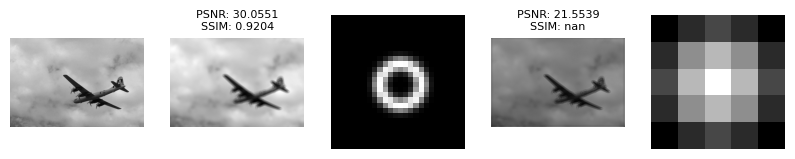

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


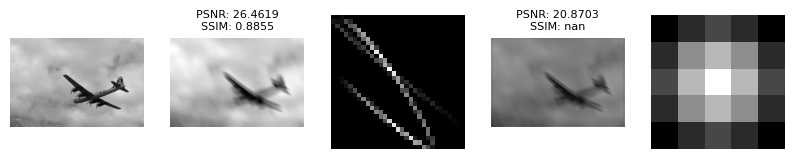

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


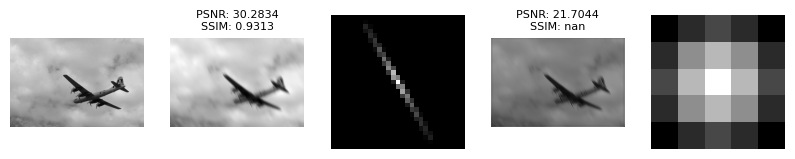

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


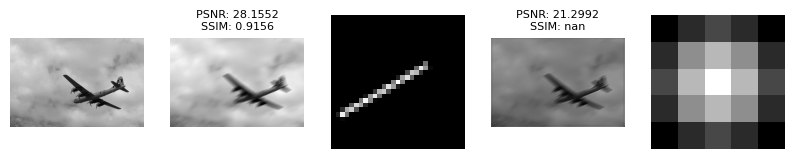

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


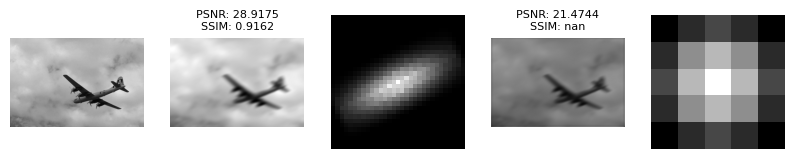

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


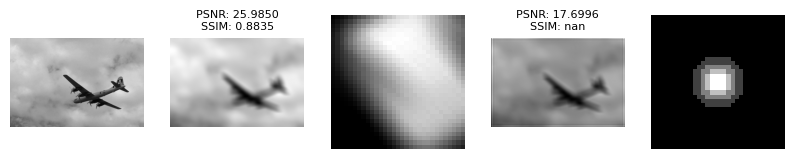

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


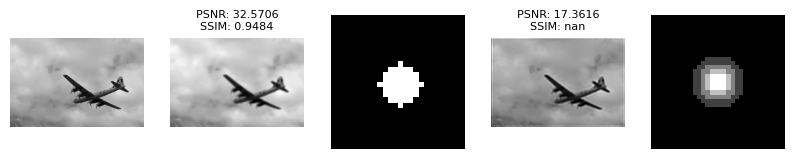

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


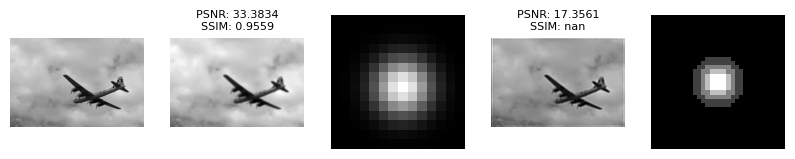

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


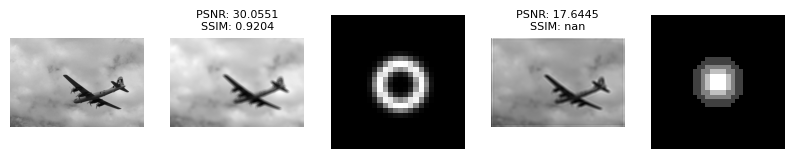

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


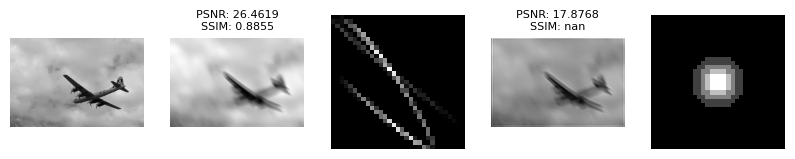

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


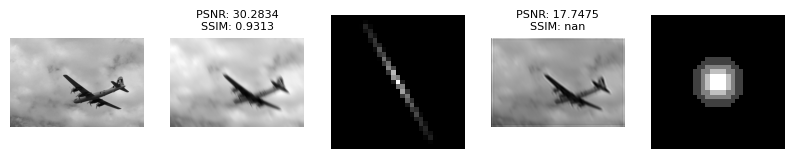

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


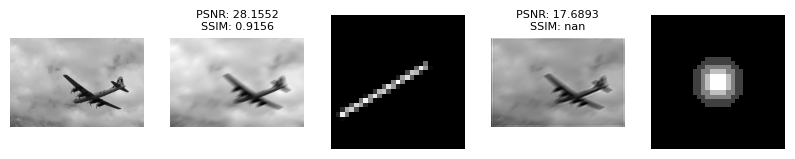

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


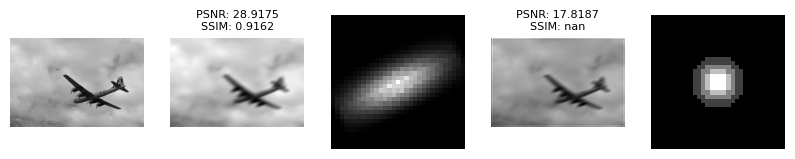

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


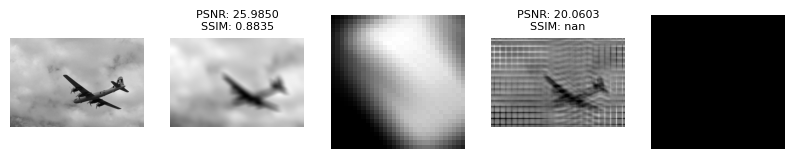

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


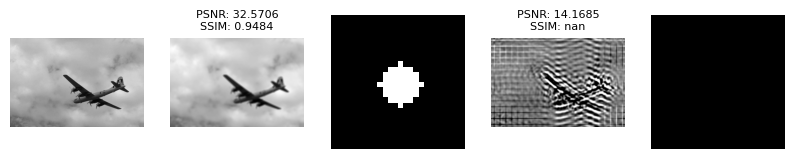

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


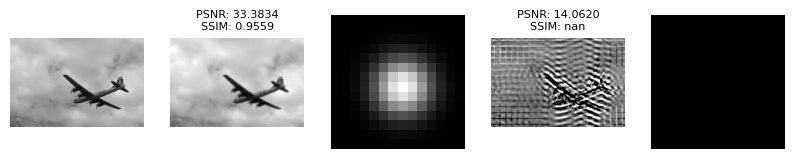

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


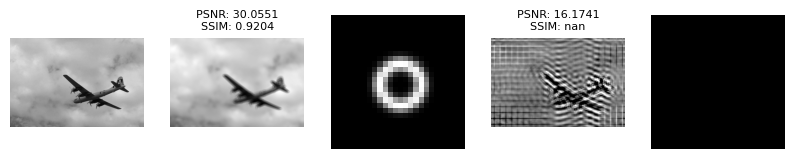

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


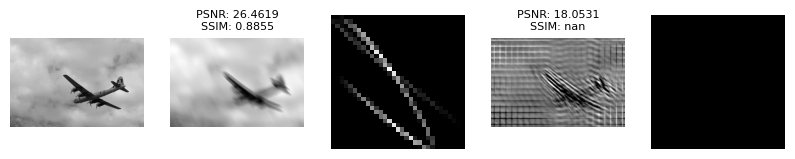

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


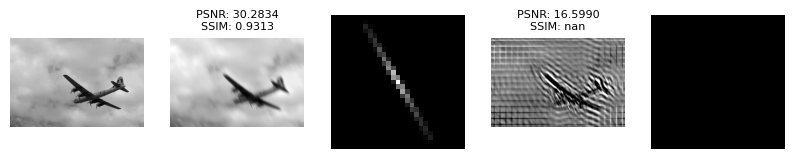

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


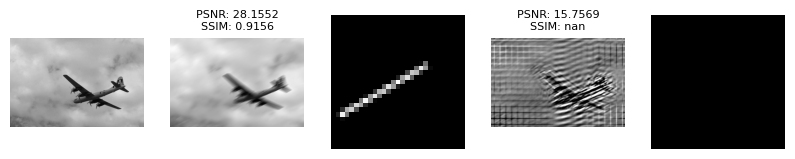

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


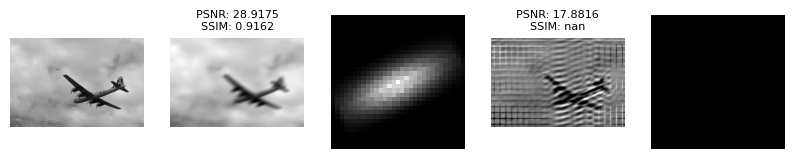

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "lenna.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


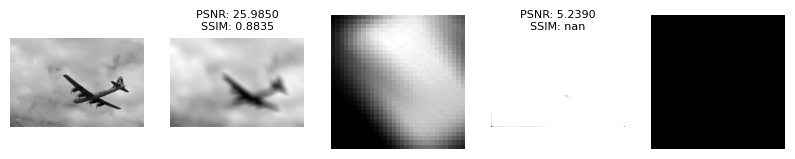

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


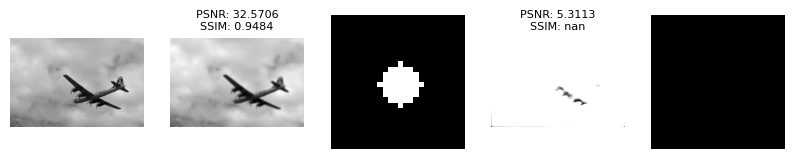

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


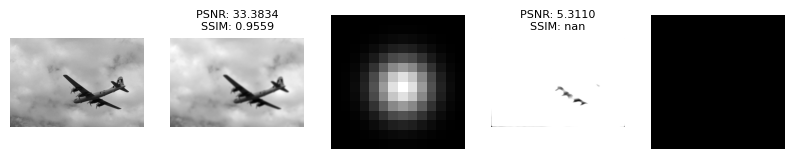

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


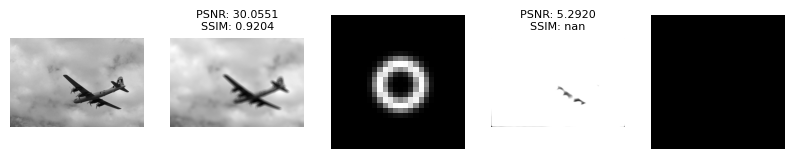

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


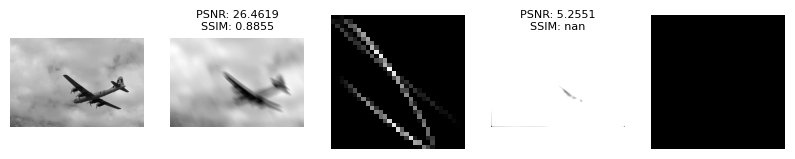

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


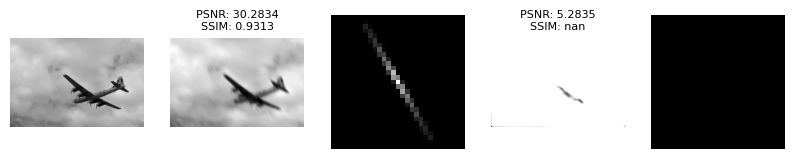

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


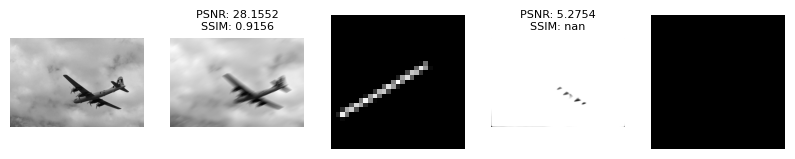

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


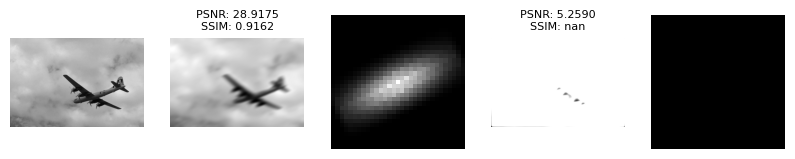

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

# Image 8. monarch.png

## Algorithm 2. GKPILE

### общие переменные

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

### ядра

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(convolved_kernel_png,convolved_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusdisk_png,defocusdisk_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusgaussian_png,defocusgaussian_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(defocusring_png,defocusring_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionbsplinesimplecurve_png,motionbsplinesimplecurve_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearexp_png,motionlinearexp_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(motionlinearuniform_png,motionlinearuniform_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_GKPILE = JtaozGKPILEDeconvolution(kernel_size=31)

Processor.save_filter()
Processor.custom_filter(stretched_gaussian_kernel_png,stretched_gaussian_kernel_npy)

Processor.process(algorithm_GKPILE,unique_path=False)

Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()
Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
from algorithms.blind_deconvolution.jtaoz_GKPILE_Deconvolution import JtaozGKPILEDeconvolution
algorithm_name = JtaozGKPILEDeconvolution(kernel_size=31).get_name()

processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 3. CrewleaderBlindDeconvolutionLowRank

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


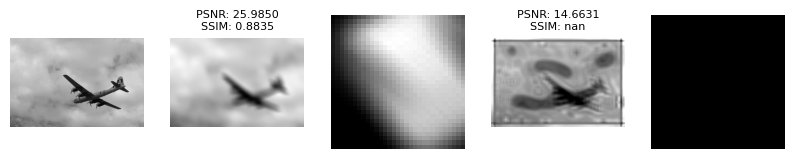

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


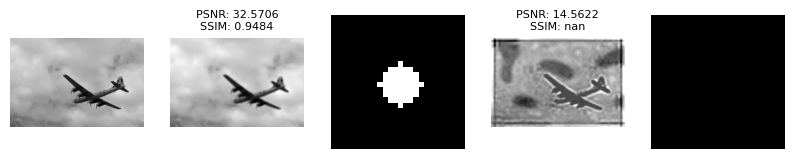

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankBlindDeconvolution.png (PSNR: 14.56, SSIM: nan)


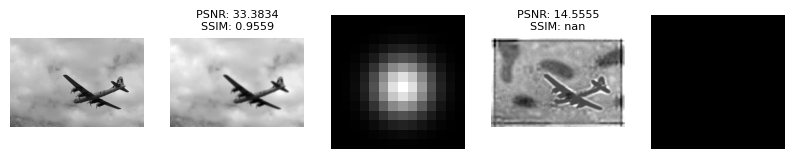

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankBlindDeconvolution.png (PSNR: 14.69, SSIM: nan)


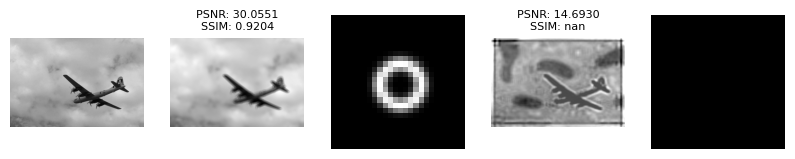

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankBlindDeconvolution.png (PSNR: 14.65, SSIM: nan)


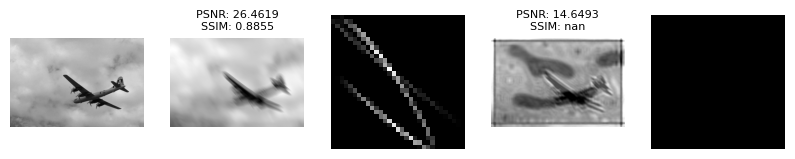

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankBlindDeconvolution.png (PSNR: 14.76, SSIM: nan)


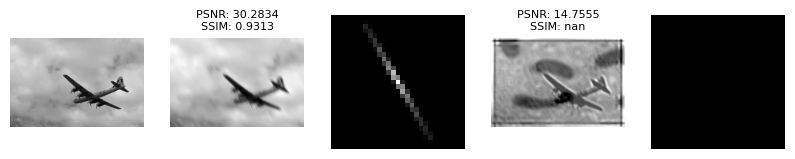

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankBlindDeconvolution.png (PSNR: 14.66, SSIM: nan)


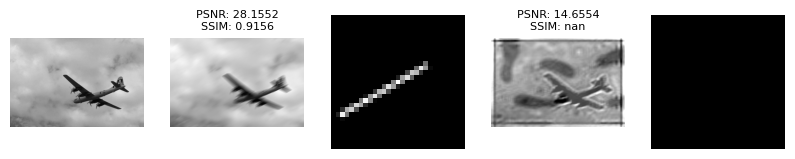

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankBlindDeconvolution.png (PSNR: 14.74, SSIM: nan)


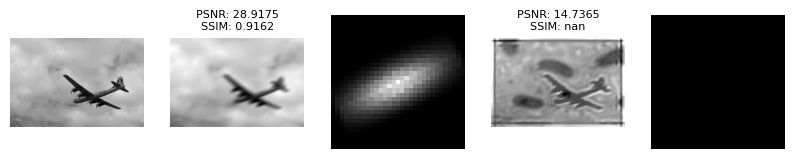

In [ ]:
from algorithms.unsorted.crewleader_BlindDeconvolutionLowRank import CrewleaderBlindDeconvolutionLowRank
algorithm_CrewleaderBlindDeconvolutionLowRank = CrewleaderBlindDeconvolutionLowRank()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_CrewleaderBlindDeconvolutionLowRank,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_CrewleaderBlindDeconvolutionLowRank.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

,original,kernel blur,blurred,blurred psnr,blurred ssim,kernel_ModulatedInputsBlindDeconvolution,ModulatedInputsBlindDeconvolution,psnr_ModulatedInputsBlindDeconvolution,ssim_ModulatedInputsBlindDeconvolution
0,alg_test\original\airplane.png,alg_test\ground_truth_filters\convolved_kernel...,alg_test\blurred\airplane_convolved_kernel.png,25.985003,0.883540,alg_test\restored_kernel\airplane_convolved_ke...,alg_test\restored\airplane_convolved_kernel_Mo...,6.793569,NaN
1,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusdisk.png,alg_test\blurred\airplane_defocusdisk.png,32.570606,0.948353,alg_test\restored_kernel\airplane_defocusdisk_...,alg_test\restored\airplane_defocusdisk_Modulat...,6.838999,NaN
2,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusgaussian.png,alg_test\blurred\airplane_defocusgaussian.png,33.383421,0.955929,alg_test\restored_kernel\airplane_defocusgauss...,alg_test\restored\airplane_defocusgaussian_Mod...,6.840406,NaN
3,alg_test\original\airplane.png,alg_test\ground_truth_filters\defocusring.png,alg_test\blurred\airplane_defocusring.png,30.055102,0.920393,alg_test\restored_kernel\airplane_defocusring_...,alg_test\restored\airplane_defocusring_Modulat...,6.832665,NaN
4,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionbsplinesim...,alg_test\blurred\airplane_motionbsplinesimplec...,26.461864,0.885531,alg_test\restored_kernel\airplane_motionbsplin...,alg_test\restored\airplane_motionbsplinesimple...,6.823241,NaN
5,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearexp.png,alg_test\blurred\airplane_motionlinearexp.png,30.283357,0.931285,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearexp_Mod...,6.832409,NaN
6,alg_test\original\airplane.png,alg_test\ground_truth_filters\motionlinearunif...,alg_test\blurred\airplane_motionlinearuniform.png,28.155176,0.915637,alg_test\restored_kernel\airplane_motionlinear...,alg_test\restored\airplane_motionlinearuniform...,6.837960,NaN
7,alg_test\original\airplane.png,alg_test\ground_truth_filters\stretched_gaussi...,alg_test\blurred\airplane_stretched_gaussian_k...,28.917492,0.916168,alg_test\restored_kernel\airplane_stretched_ga...,alg_test\restored\airplane_stretched_gaussian_...,6.833106,NaN


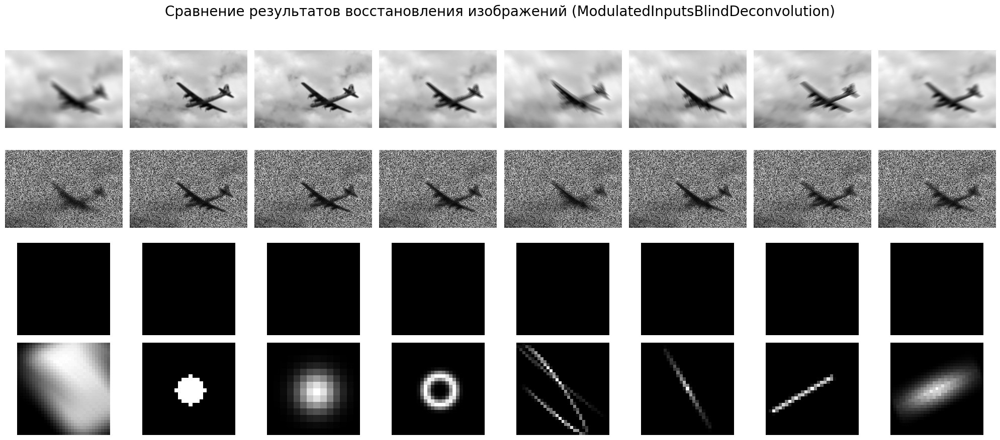

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 4. warrenzha_blind_deconvolution

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_ZhaoBlindDeconv.png (PSNR: 6.62, SSIM: nan)


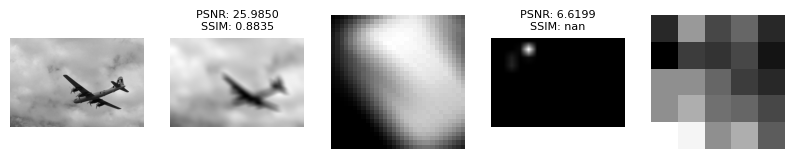

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


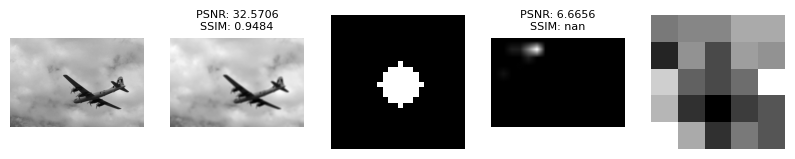

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_ZhaoBlindDeconv.png (PSNR: 6.67, SSIM: nan)


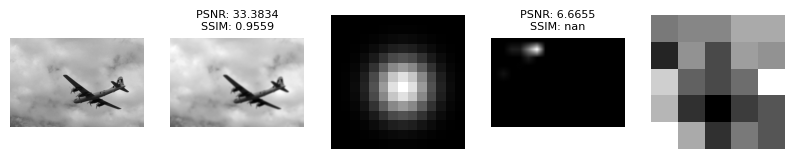

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_ZhaoBlindDeconv.png (PSNR: 6.64, SSIM: nan)


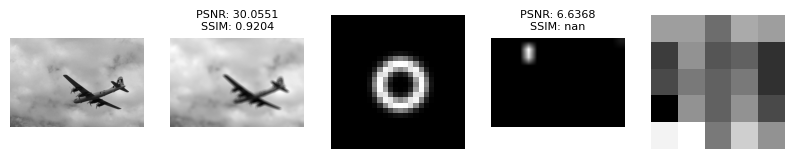

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_ZhaoBlindDeconv.png (PSNR: 6.69, SSIM: nan)


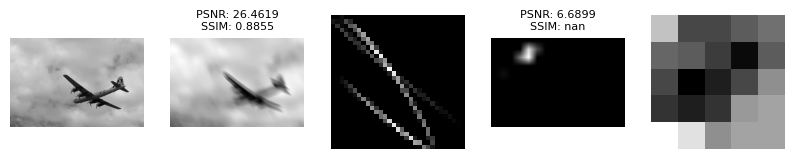

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_ZhaoBlindDeconv.png (PSNR: 6.66, SSIM: nan)


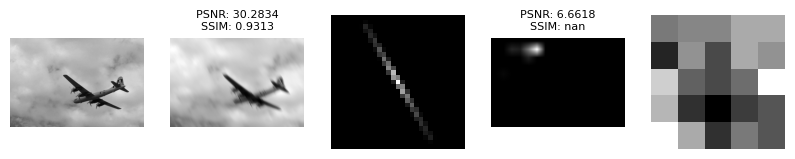

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_ZhaoBlindDeconv.png (PSNR: 6.65, SSIM: nan)


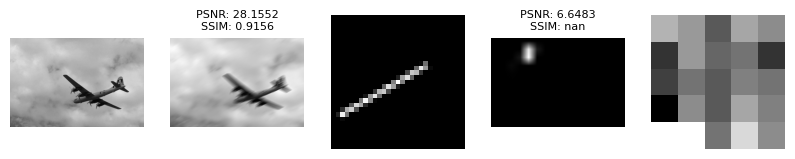

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_ZhaoBlindDeconv.png (PSNR: 6.63, SSIM: nan)


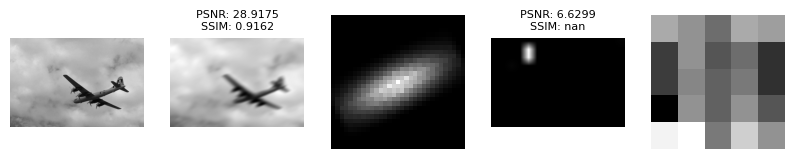

In [ ]:
from algorithms.unsorted.warrenzha_blind_deconvolution import WarrenzhaBlindDeconvolution
algorithm_WarrenzhaBlindDeconvolution = WarrenzhaBlindDeconvolution()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_WarrenzhaBlindDeconvolution,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_WarrenzhaBlindDeconvolution.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 5. zalteck_BCDTV

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

iter:   1	 beta: 0.154611
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 261.981054	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.65e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.41e+02, Iters: 50
H	 conv: 1.48e-22
E	 conv: 2.88e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154610
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 37.019727	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.54e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.83e+01, Iters: 50
H	 conv: 3.34e-26
E	 conv: 8.87e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.172764
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.446045	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 8.43e+01, 

d:\Code\projects\BlindDeconvolution\metrics.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  return peak_signal_noise_ratio(original, restored)


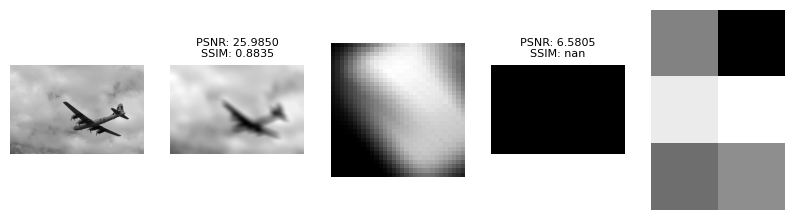

iter:   1	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 130.213278	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.03e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.12e+02, Iters: 50
H	 conv: 3.57e-23
E	 conv: 6.99e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155478
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.450697	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.86e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.44e+01, Iters: 50
H	 conv: 1.50e-26
E	 conv: 4.26e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167069
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.782099	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.96e+01, 

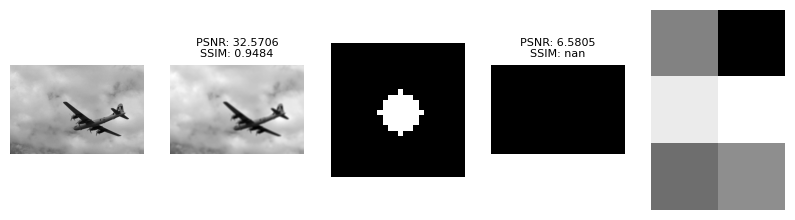

iter:   1	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 132.705126	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.05e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.84e+02, Iters: 50
H	 conv: 3.66e-23
E	 conv: 5.90e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155479
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 33.580347	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 9.87e+01, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.45e+01, Iters: 50
H	 conv: 1.51e-26
E	 conv: 4.25e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167070
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.808830	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 4.94e+01, 

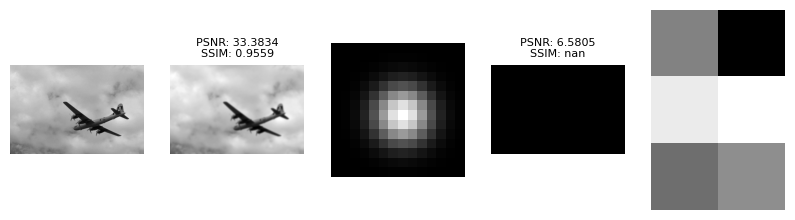

iter:   1	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 148.465523	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.14e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 6.24e+02, Iters: 50
H	 conv: 4.80e-23
E	 conv: 5.73e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155283
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.395981	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.11e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.51e+01, Iters: 50
H	 conv: 1.77e-26
E	 conv: 4.56e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167446
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.951736	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.65e+01, 

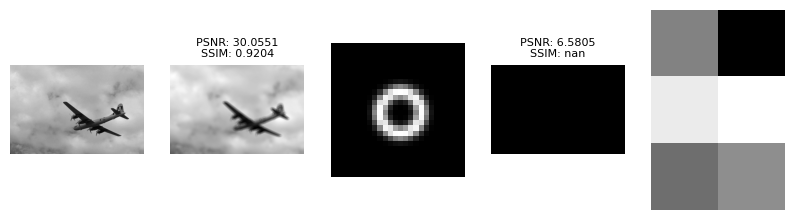

iter:   1	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 201.337176	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.45e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 9.38e+02, Iters: 50
H	 conv: 9.44e-23
E	 conv: 7.64e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.154957
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.969010	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.27e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.66e+01, Iters: 50
H	 conv: 2.63e-26
E	 conv: 6.27e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169778
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.260893	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 7.54e+01, 

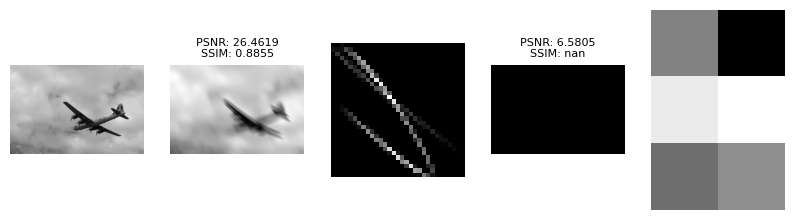

iter:   1	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 160.996038	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.22e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.48e+02, Iters: 50
H	 conv: 5.73e-23
E	 conv: 1.00e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155167
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.015224	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.16e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.52e+01, Iters: 50
H	 conv: 1.95e-26
E	 conv: 4.75e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167638
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.083132	 gamma: 4503599165561227.500000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.20e+01, 

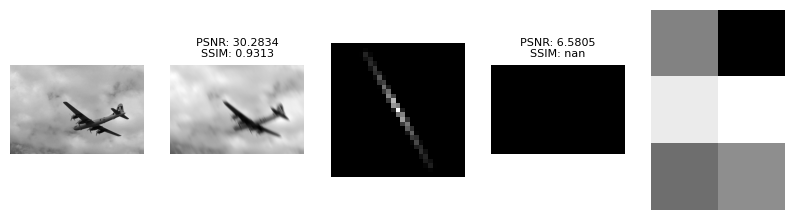

iter:   1	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 146.933545	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.21e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 7.35e+02, Iters: 50
H	 conv: 5.33e-23
E	 conv: 1.04e-07
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155281
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 34.390576	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.07e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.57e+01, Iters: 50
H	 conv: 1.90e-26
E	 conv: 4.60e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.167623
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 11.943303	 gamma: 4503599165561550.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 5.91e+01, 

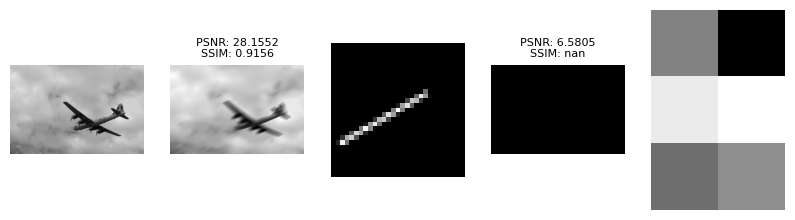

iter:   1	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 13510798882111480.000000
E	 alpha: 188.370824	 gamma: 13510798882111480.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 2.35e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 5.88e+02, Iters: 50
H	 conv: 7.69e-23
E	 conv: 3.43e-08
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   2	 beta: 0.155064
H	 alpha: 695360286065631952896.000000	 gamma: 6755399441055738.000000
E	 alpha: 35.767388	 gamma: 6755399233249968.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 1.28e+02, Iters: 50
	Gradiente conjugado s = 1
	Flag: 50, RelRes: 1.68e+01, Iters: 50
H	 conv: 2.31e-26
E	 conv: 5.68e-02
M
 [[0.45621982 0.02813432]
 [0.80004485 0.86799335]
 [0.38960455 0.49577817]]
iter:   3	 beta: 0.169066
H	 alpha: 695360286065631952896.000000	 gamma: 4503599627370492.000000
E	 alpha: 12.207613	 gamma: 4503599165560904.000000
	Gradiente conjugado s = 0
	Flag: 50, RelRes: 6.65e+01, 

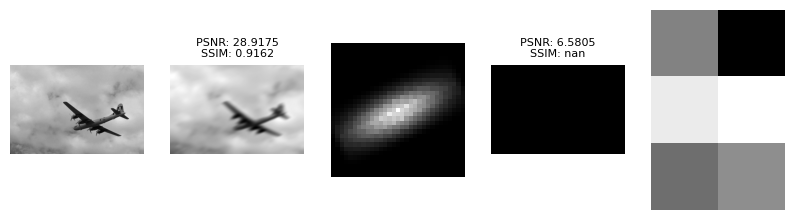

In [ ]:
from algorithms.unsorted.zalteck_BCDTV import ZalteckBCDTV
algorithm_ZalteckBCDTV = ZalteckBCDTV()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_ZalteckBCDTV,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_ZalteckBCDTV.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 6. vipgugr_BCDSAR

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_convolved_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


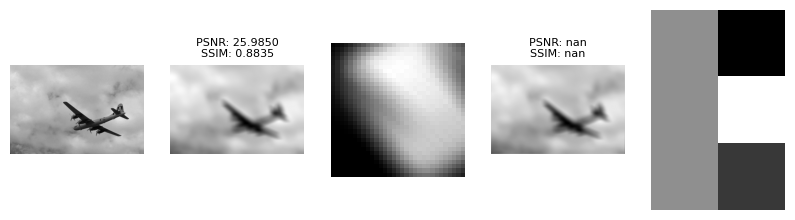

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusdisk_BCDHE.png (PSNR: nan, SSIM: nan)


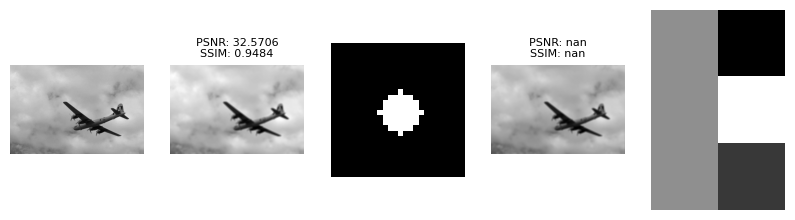

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusgaussian_BCDHE.png (PSNR: nan, SSIM: nan)


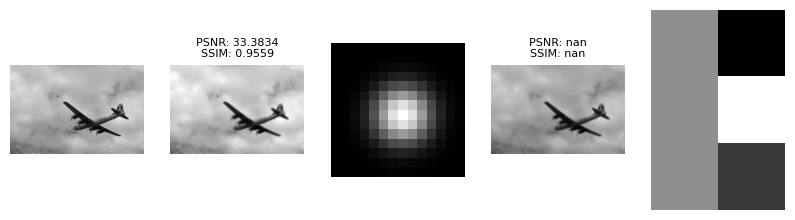

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_defocusring_BCDHE.png (PSNR: nan, SSIM: nan)


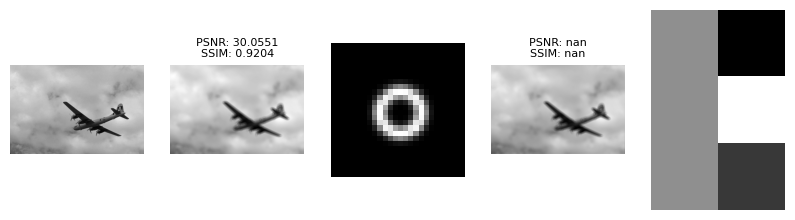

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionbsplinesimplecurve_BCDHE.png (PSNR: nan, SSIM: nan)


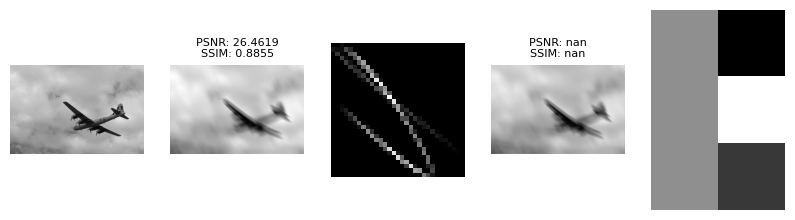

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearexp_BCDHE.png (PSNR: nan, SSIM: nan)


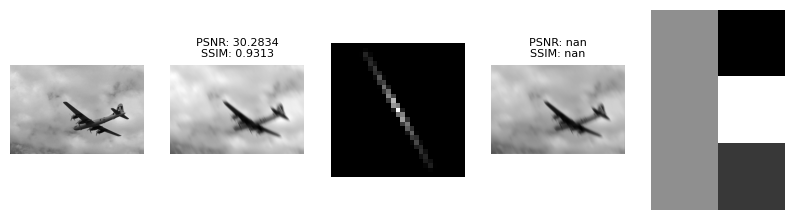

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_motionlinearuniform_BCDHE.png (PSNR: nan, SSIM: nan)


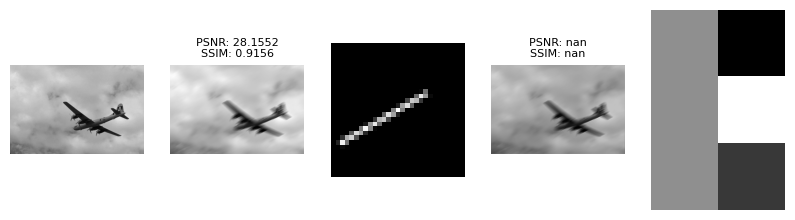

PSNR calculation error: Input images must have the same dimensions.
SSIM calculation error: Input images must have the same dimensions.
Restored: airplane_stretched_gaussian_kernel_BCDHE.png (PSNR: nan, SSIM: nan)


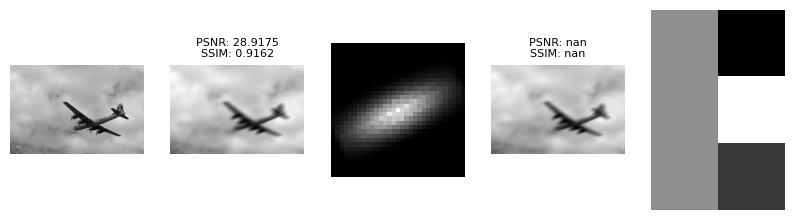

In [ ]:
from algorithms.unsorted.vipgugr_BCDSAR import VipgugrBCDSAR
algorithm_VipgugrBCDSAR = VipgugrBCDSAR()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_VipgugrBCDSAR,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_VipgugrBCDSAR.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 7. TobiasWolf_math_Blind_Deconvolution_MHDM

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MHDM.png (PSNR: 21.17, SSIM: nan)


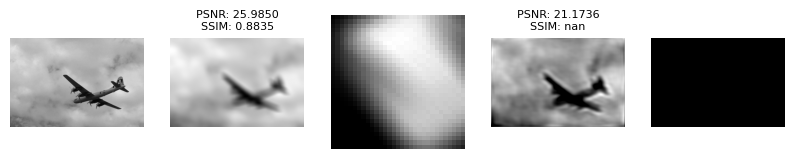

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MHDM.png (PSNR: 22.51, SSIM: nan)


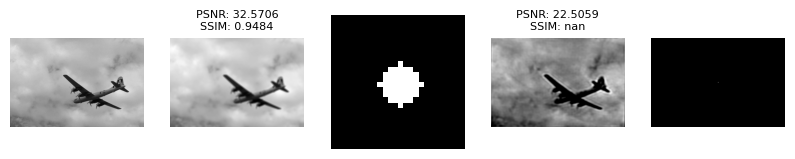

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MHDM.png (PSNR: 22.53, SSIM: nan)


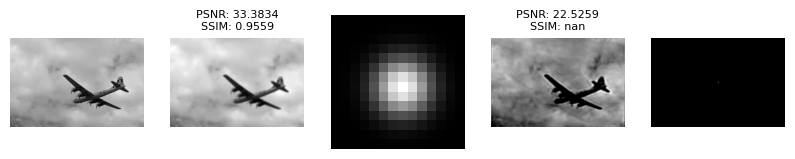

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MHDM.png (PSNR: 22.43, SSIM: nan)


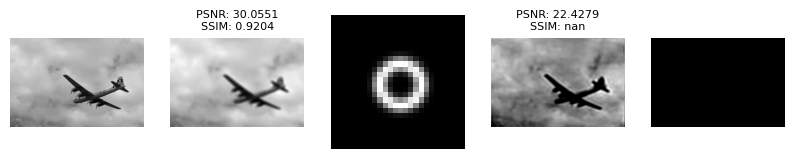

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MHDM.png (PSNR: 21.12, SSIM: nan)


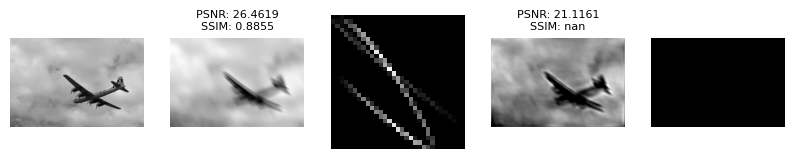

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MHDM.png (PSNR: 22.39, SSIM: nan)


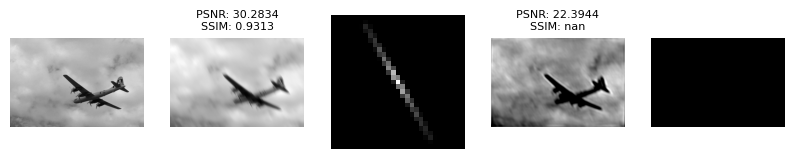

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MHDM.png (PSNR: 21.57, SSIM: nan)


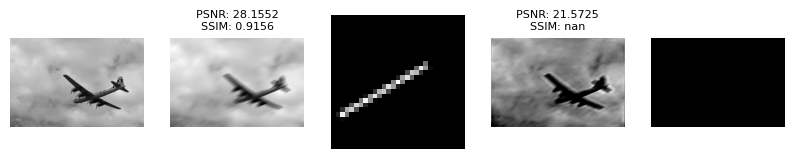

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MHDM.png (PSNR: 22.33, SSIM: nan)


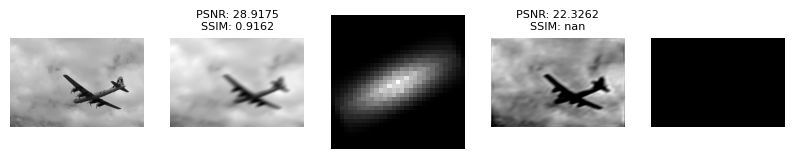

In [ ]:
from algorithms.unsorted.TobiasWolf_math_Blind_Deconvolution_MHDM import TobiasWolfMathBlindDeconvolutionMHDM
algorithm_TobiasWolfMathBlindDeconvolutionMHDM = TobiasWolfMathBlindDeconvolutionMHDM()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_TobiasWolfMathBlindDeconvolutionMHDM,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_TobiasWolfMathBlindDeconvolutionMHDM.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 8. qingqu06_MCS_BD

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MCSBlindDeconvolution.png (PSNR: 20.92, SSIM: nan)


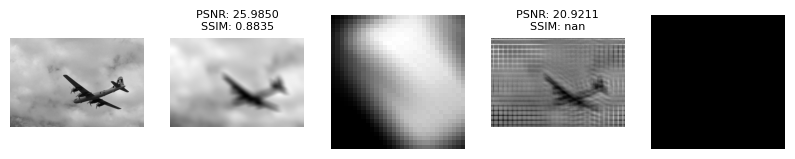

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MCSBlindDeconvolution.png (PSNR: 15.97, SSIM: nan)


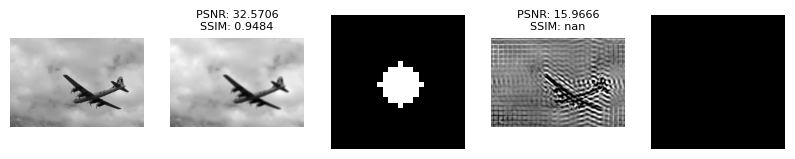

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MCSBlindDeconvolution.png (PSNR: 15.77, SSIM: nan)


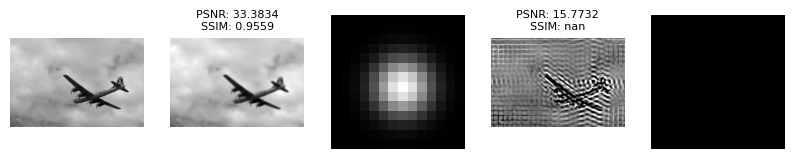

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MCSBlindDeconvolution.png (PSNR: 18.66, SSIM: nan)


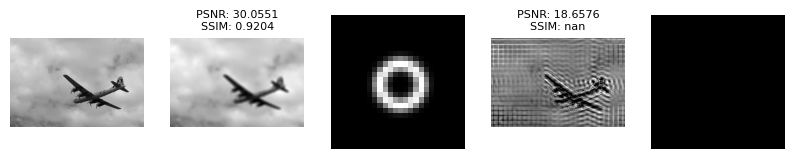

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MCSBlindDeconvolution.png (PSNR: 18.71, SSIM: nan)


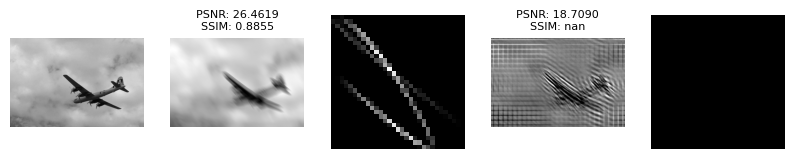

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MCSBlindDeconvolution.png (PSNR: 18.19, SSIM: nan)


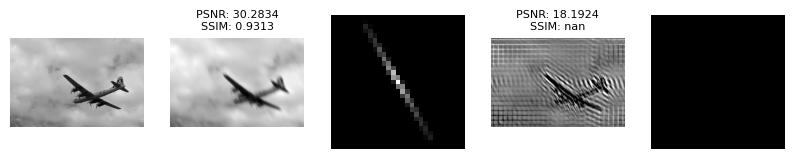

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MCSBlindDeconvolution.png (PSNR: 17.09, SSIM: nan)


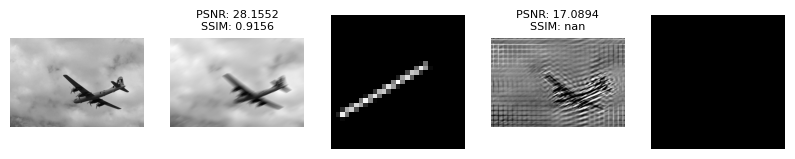

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MCSBlindDeconvolution.png (PSNR: 20.01, SSIM: nan)


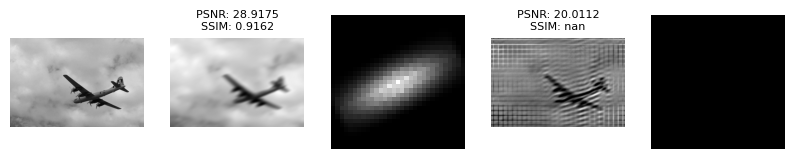

In [ ]:
from algorithms.unsorted.qingqu06_MCS_BD import Qingqu06MCSBD
algorithm_Qingqu06MCSBD = Qingqu06MCSBD()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_Qingqu06MCSBD,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_Qingqu06MCSBD.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 9. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_WienerFilter.png (PSNR: 25.89, SSIM: nan)


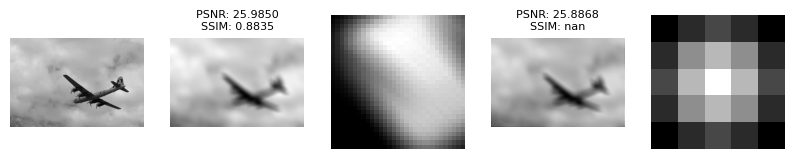

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_WienerFilter.png (PSNR: 32.11, SSIM: nan)


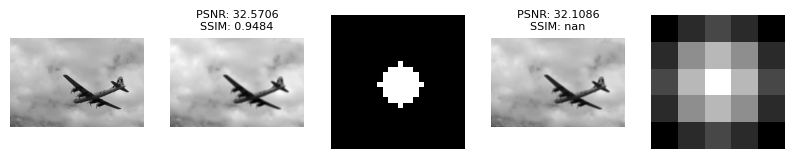

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_WienerFilter.png (PSNR: 33.86, SSIM: nan)


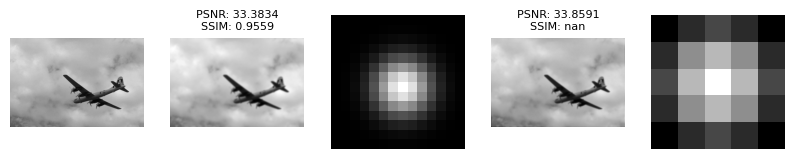

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_WienerFilter.png (PSNR: 29.35, SSIM: nan)


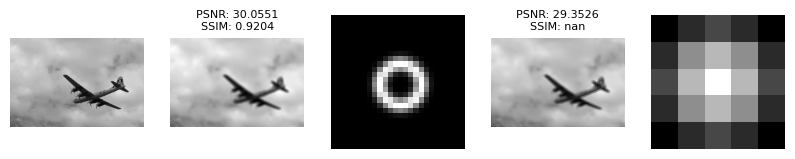

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_WienerFilter.png (PSNR: 26.28, SSIM: nan)


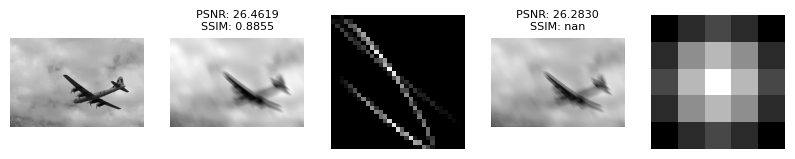

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_WienerFilter.png (PSNR: 30.32, SSIM: nan)


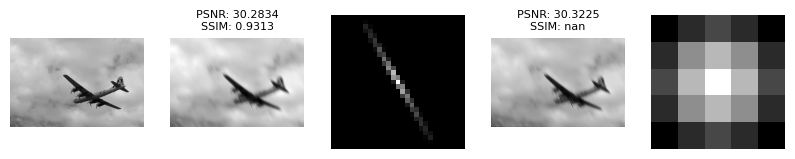

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_WienerFilter.png (PSNR: 27.94, SSIM: nan)


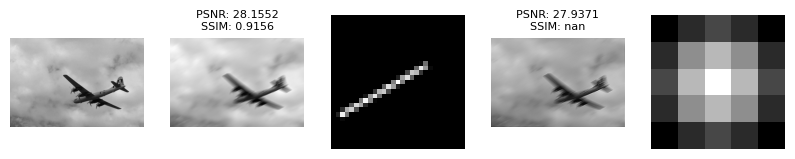

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_WienerFilter.png (PSNR: 28.85, SSIM: nan)


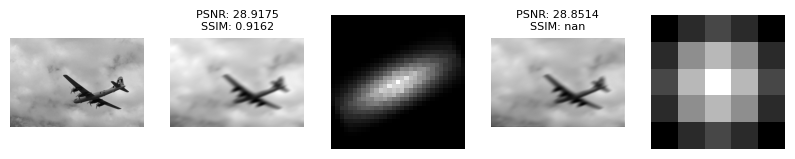

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFilters
algorithm_MuhammadhamzaazharImageEnhancementFilters = MuhammadhamzaazharImageEnhancementFilters()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFilters,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFilters.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 10. muhammadhamzaazhar_Image_Enhancement_Filters

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_RichardsonLucy.png (PSNR: 20.74, SSIM: nan)


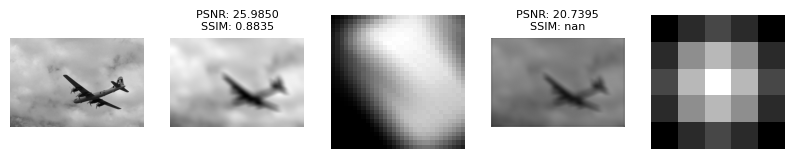

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_RichardsonLucy.png (PSNR: 21.91, SSIM: nan)


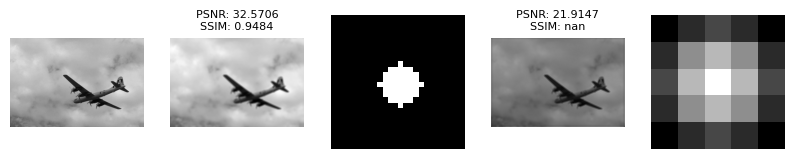

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_RichardsonLucy.png (PSNR: 22.06, SSIM: nan)


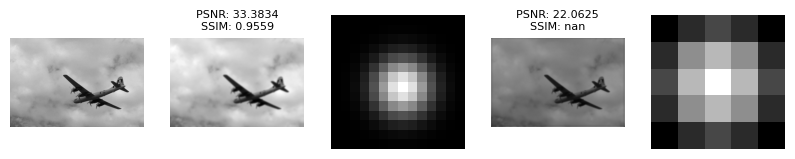

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_RichardsonLucy.png (PSNR: 21.55, SSIM: nan)


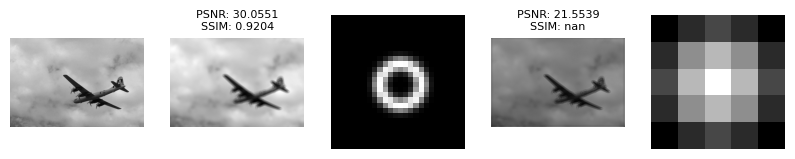

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_RichardsonLucy.png (PSNR: 20.87, SSIM: nan)


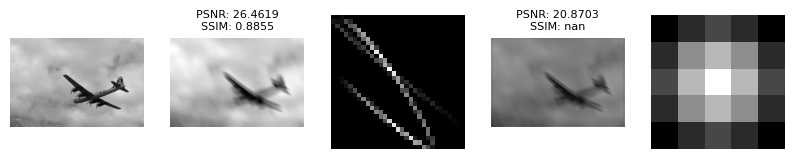

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_RichardsonLucy.png (PSNR: 21.70, SSIM: nan)


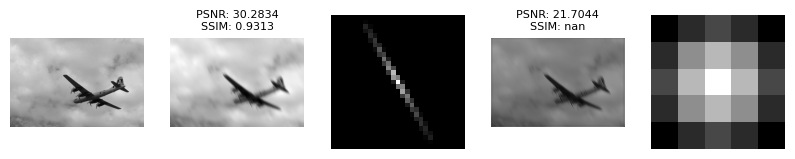

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_RichardsonLucy.png (PSNR: 21.30, SSIM: nan)


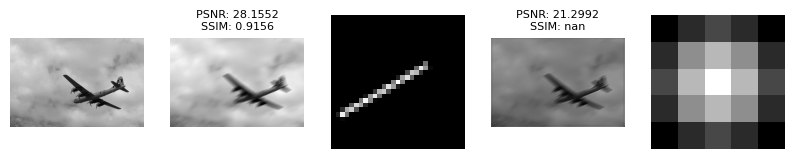

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_RichardsonLucy.png (PSNR: 21.47, SSIM: nan)


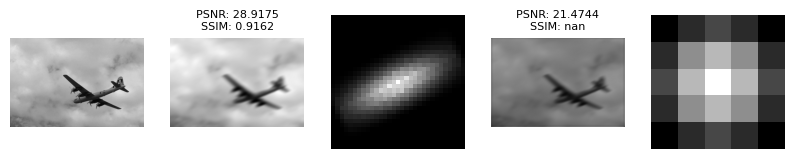

In [ ]:
from algorithms.unsorted.muhammadhamzaazhar_Image_Enhancement_Filters import MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy
algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy = MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MuhammadhamzaazharImageEnhancementFiltersRichardsonLucy.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 11. MaxMB_Image_Restoration_Wiener_Blind

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_MaxMBWienerBlind.png (PSNR: 17.70, SSIM: nan)


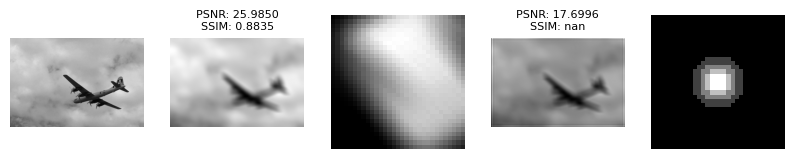

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


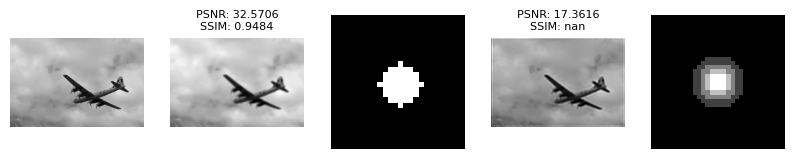

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_MaxMBWienerBlind.png (PSNR: 17.36, SSIM: nan)


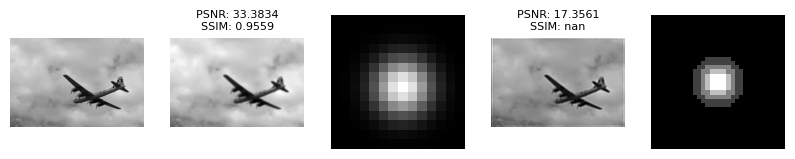

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_MaxMBWienerBlind.png (PSNR: 17.64, SSIM: nan)


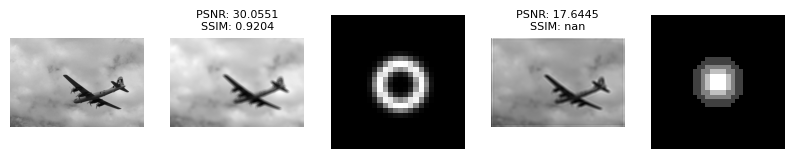

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_MaxMBWienerBlind.png (PSNR: 17.88, SSIM: nan)


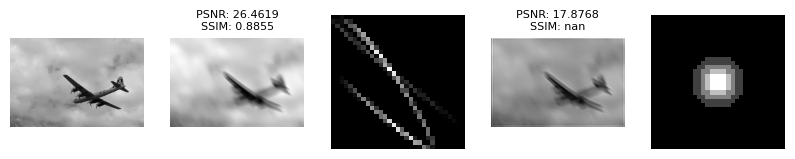

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_MaxMBWienerBlind.png (PSNR: 17.75, SSIM: nan)


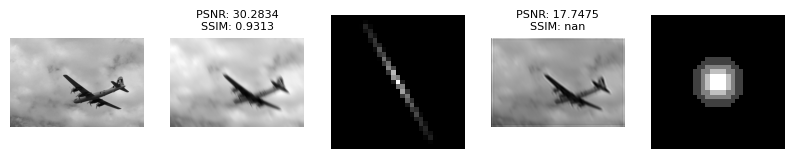

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_MaxMBWienerBlind.png (PSNR: 17.69, SSIM: nan)


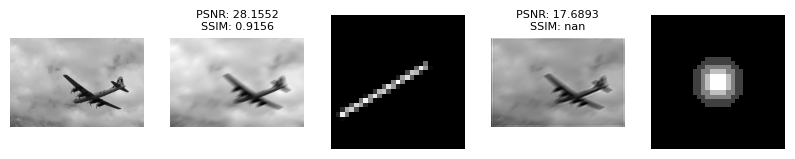

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_MaxMBWienerBlind.png (PSNR: 17.82, SSIM: nan)


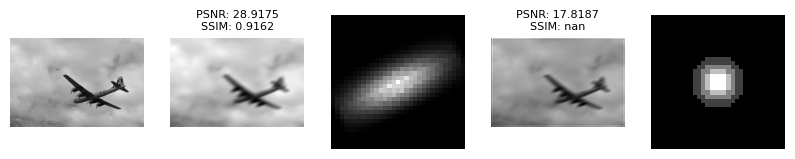

In [ ]:
from algorithms.unsorted.MaxMB_Image_Restoration_Wiener_Blind import MaxMBImageRestorationWienerBlind
algorithm_MaxMBImageRestorationWienerBlind = MaxMBImageRestorationWienerBlind()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_MaxMBImageRestorationWienerBlind,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_MaxMBImageRestorationWienerBlind.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 12. lisiyaoATbnu_low_rank_kernel

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_LowRankKernelBlindDeconv.png (PSNR: 20.06, SSIM: nan)


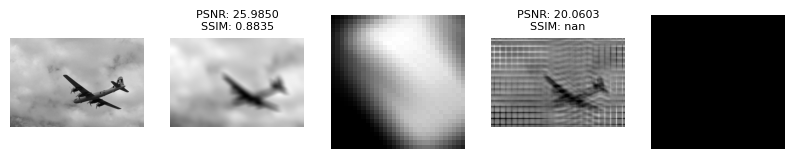

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_LowRankKernelBlindDeconv.png (PSNR: 14.17, SSIM: nan)


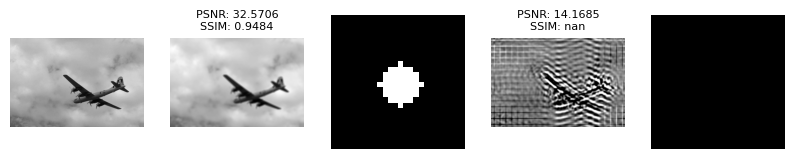

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_LowRankKernelBlindDeconv.png (PSNR: 14.06, SSIM: nan)


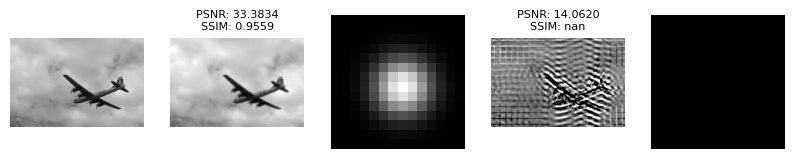

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_LowRankKernelBlindDeconv.png (PSNR: 16.17, SSIM: nan)


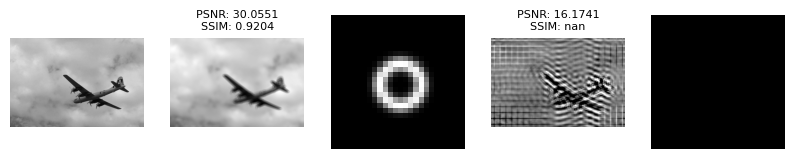

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_LowRankKernelBlindDeconv.png (PSNR: 18.05, SSIM: nan)


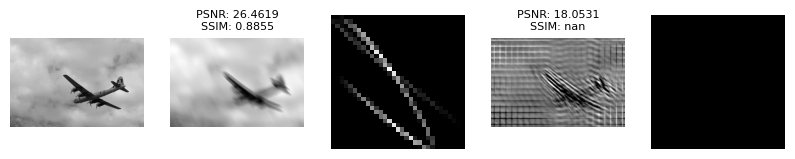

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_LowRankKernelBlindDeconv.png (PSNR: 16.60, SSIM: nan)


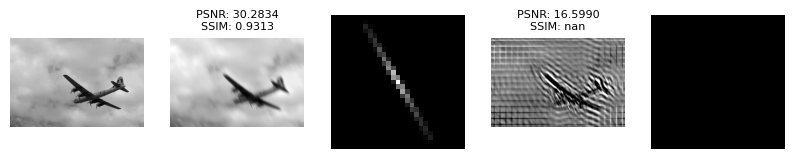

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_LowRankKernelBlindDeconv.png (PSNR: 15.76, SSIM: nan)


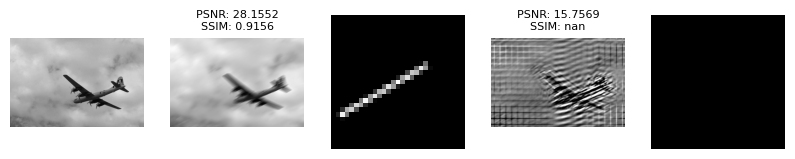

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_LowRankKernelBlindDeconv.png (PSNR: 17.88, SSIM: nan)


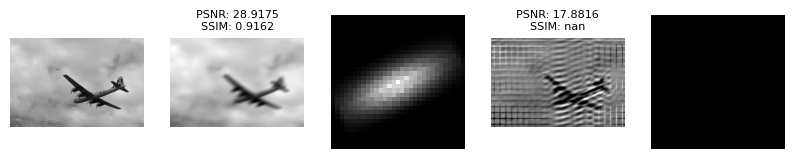

In [ ]:
from algorithms.unsorted.lisiyaoATbnu_low_rank_kernel import LisiyaoATbnuLowRankKernel
algorithm_LisiyaoATbnuLowRankKernel = LisiyaoATbnuLowRankKernel()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_LisiyaoATbnuLowRankKernel,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_LisiyaoATbnuLowRankKernel.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)

## Algorithm 13. JohnRagland_Total_Variation_MATLAB_implementation

In [ ]:
Processor = processing.Processing(original_folder,blurred_folder,restored_folder,table_folder,False,restored_kernel_folder)
image_filename = "monarch.png"
Processor.read_one(image_filename)

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_convolved_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.24, SSIM: nan)


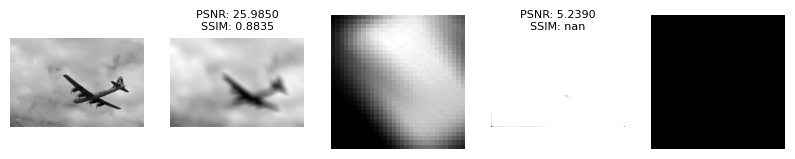

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusdisk_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


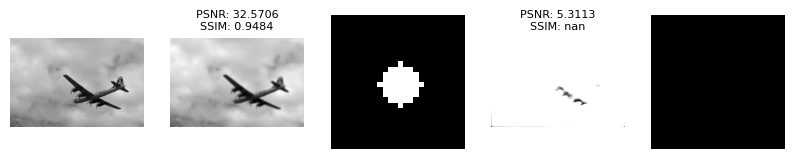

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusgaussian_TotalVariationBlindDeconvolution.png (PSNR: 5.31, SSIM: nan)


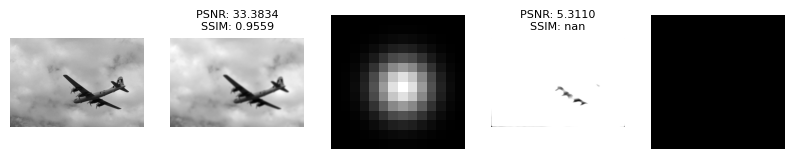

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_defocusring_TotalVariationBlindDeconvolution.png (PSNR: 5.29, SSIM: nan)


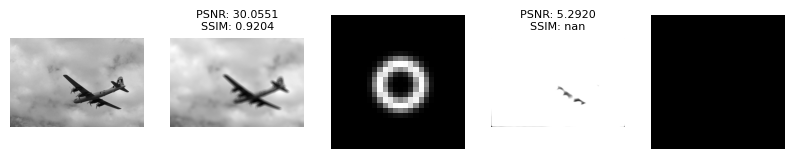

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionbsplinesimplecurve_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


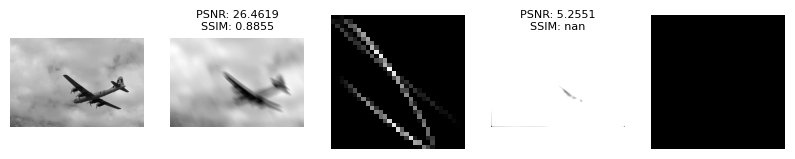

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearexp_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


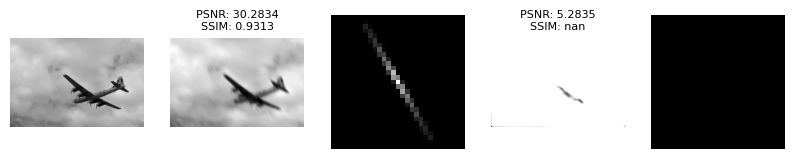

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_motionlinearuniform_TotalVariationBlindDeconvolution.png (PSNR: 5.28, SSIM: nan)


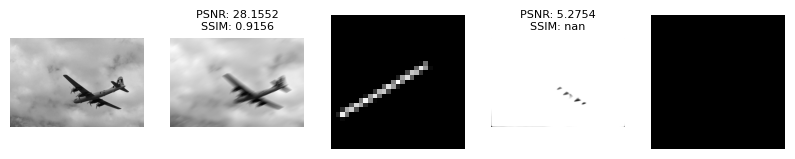

SSIM calculation error: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.
Restored: airplane_stretched_gaussian_kernel_TotalVariationBlindDeconvolution.png (PSNR: 5.26, SSIM: nan)


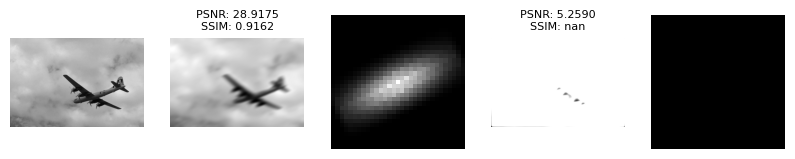

In [ ]:
from algorithms.unsorted.JohnRagland_Total_Variation_MATLAB_implementation import JohnRaglandTotalVariationMATLABImplementation
algorithm_JohnRaglandTotalVariationMATLABImplementation = JohnRaglandTotalVariationMATLABImplementation()

for png,npy in pairs:
	Processor.save_filter()
	Processor.custom_filter(png,npy)

	Processor.process(algorithm_JohnRaglandTotalVariationMATLABImplementation,unique_path=False)

	Processor.show_line(window_scale=2.0,fontsize=8)

In [ ]:
algorithm_name = algorithm_JohnRaglandTotalVariationMATLABImplementation.get_name()

Processor.save_bind_state(table_folder / f"{image_filename}_{algorithm_name}.json")
Processor.get_table(table_folder / f"{image_filename}_{algorithm_name}.csv",True)

In [ ]:
processing.show_from_table(table_folder / f"{image_filename}_{algorithm_name}.csv",
                           algorithm_name,
                           window_scale=0.5)